In [2]:
"""Training a face recognizer with TensorFlow based on the FaceNet paper
FaceNet: A Unified Embedding for Face Recognition and Clustering: http://arxiv.org/abs/1503.03832
"""
# MIT License
# 
# Copyright (c) 2016 David Sandberg
# 
# Permission is hereby granted, free of charge, to any person obtaining a copy
# of this software and associated documentation files (the "Software"), to deal
# in the Software without restriction, including without limitation the rights
# to use, copy, modify, merge, publish, distribute, sublicense, and/or sell
# copies of the Software, and to permit persons to whom the Software is
# furnished to do so, subject to the following conditions:
# 
# The above copyright notice and this permission notice shall be included in all
# copies or substantial portions of the Software.
# 
# THE SOFTWARE IS PROVIDED "AS IS", WITHOUT WARRANTY OF ANY KIND, EXPRESS OR
# IMPLIED, INCLUDING BUT NOT LIMITED TO THE WARRANTIES OF MERCHANTABILITY,
# FITNESS FOR A PARTICULAR PURPOSE AND NONINFRINGEMENT. IN NO EVENT SHALL THE
# AUTHORS OR COPYRIGHT HOLDERS BE LIABLE FOR ANY CLAIM, DAMAGES OR OTHER
# LIABILITY, WHETHER IN AN ACTION OF CONTRACT, TORT OR OTHERWISE, ARISING FROM,
# OUT OF OR IN CONNECTION WITH THE SOFTWARE OR THE USE OR OTHER DEALINGS IN THE
# SOFTWARE.

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function

from datetime import datetime
import os
import os.path
import time
import sys
import tensorflow as tf
import numpy as np
import importlib
import itertools
import argparse
from nets import nets_factory
import cv2
import random
import pickle
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

from tensorflow.python.ops import data_flow_ops

from six.moves import xrange

os.environ['CUDA_DEVICE_ORDER']='PCI_BUS_ID'
os.environ['CUDA_VISIBLE_DEVICES']=''

In [3]:
def _add_loss_summaries(total_loss):
    """Add summaries for losses.
  
    Generates moving average for all losses and associated summaries for
    visualizing the performance of the network.
  
    Args:
      total_loss: Total loss from loss().
    Returns:
      loss_averages_op: op for generating moving averages of losses.
    """
    # Compute the moving average of all individual losses and the total loss.
    loss_averages = tf.train.ExponentialMovingAverage(0.9, name='avg')
    losses = tf.get_collection('losses')
    loss_averages_op = loss_averages.apply(losses + [total_loss])
  
    # Attach a scalar summmary to all individual losses and the total loss; do the
    # same for the averaged version of the losses.
    for l in losses + [total_loss]:
        # Name each loss as '(raw)' and name the moving average version of the loss
        # as the original loss name.
        tf.summary.scalar(l.op.name +' (raw)', l)
        tf.summary.scalar(l.op.name, loss_averages.average(l))
  
    return loss_averages_op

def triplet_loss_fn(anchor, positive, negative, alpha):
    """Calculate the triplet loss according to the FaceNet paper
    
    Args:
      anchor: the embeddings for the anchor images.
      positive: the embeddings for the positive images.
      negative: the embeddings for the negative images.
  
    Returns:
      the triplet loss according to the FaceNet paper as a float tensor.
    """
    with tf.variable_scope('triplet_loss'):
        pos_dist = tf.reduce_sum(tf.square(tf.subtract(anchor, positive)), 1)
        neg_dist = tf.reduce_sum(tf.square(tf.subtract(anchor, negative)), 1)
        
        basic_loss = tf.add(tf.subtract(pos_dist,neg_dist), alpha)
        loss = tf.reduce_mean(tf.maximum(basic_loss, 0.0))
      
    return loss


def resize_to_min_dimension_np(image, max_dimension=800):
    image_height,image_width = image.shape[:2]
    
    max_image_dimension = np.maximum(image_height, image_width)
    #max_target_dimension = np.minimum(max_image_dimension, max_dimension)
    #print('max:',max_target_dimension)
    target_ratio = max_dimension / float(max_image_dimension)
#    target_height = int(float(image_height) * target_ratio)
#    target_width = int(float(image_width) * target_ratio)
    result = cv2.resize( image, None, fx=target_ratio, fy=target_ratio, interpolation=cv2.INTER_LINEAR)#,
    return result


#def resize_to_min_dimension(image, max_dimension=800):
#    image.set_shape([None, None, None])
#    image_height = tf.shape(image)[0]
#    image_width = tf.shape(image)[1]
#    max_image_dimension = tf.maximum(image_height, image_width)
#    max_target_dimension = tf.maximum(max_image_dimension, max_dimension)
#    target_ratio = tf.to_float(max_target_dimension) / tf.to_float(max_image_dimension)
#    target_height = tf.to_int32(tf.to_float(image_height) * target_ratio)
#    target_width = tf.to_int32(tf.to_float(image_width) * target_ratio)
#    print(image, target_height)
#    image = tf.image.resize_images( image, [target_height, target_width])
#    result = image#tf.squeeze(image, axis=0)
#    return result

def combined_static_and_dynamic_shape(tensor):
  """Returns a list containing static and dynamic values for the dimensions.
  Returns a list of static and dynamic values for shape dimensions. This is
  useful to preserve static shapes when available in reshape operation.
  Args:
    tensor: A tensor of any type.
  Returns:
    A list of size tensor.shape.ndims containing integers or a scalar tensor.
  """
  static_shape = tensor.shape.as_list()
  dynamic_shape = tf.shape(tensor)
  combined_shape = []
  for index, dim in enumerate(static_shape):
    if dim is not None:
      combined_shape.append(dim)
    else:
      combined_shape.append(dynamic_shape[index])
  return combined_shape

def get_box_inds(proposals):
    proposals_shape = proposals.get_shape().as_list()
    if any(dim is None for dim in proposals_shape):
       proposals_shape = tf.shape(proposals)
    ones_mat = tf.ones(proposals_shape[:2], dtype=tf.int32)
    multiplier = tf.expand_dims( tf.range(start=0, limit=proposals_shape[0]), 1 )
    return tf.reshape(ones_mat * multiplier, [-1])
def average_gradients(tower_grads):
  """Calculate the average gradient for each shared variable across all towers.
  Note that this function provides a synchronization point across all towers.
  Args:
    tower_grads: List of lists of (gradient, variable) tuples. The outer list
      is over individual gradients. The inner list is over the gradient
      calculation for each tower.
  Returns:
     List of pairs of (gradient, variable) where the gradient has been averaged
     across all towers.
  """
  average_grads = []
  for grad_and_vars in zip(*tower_grads):
    # Note that each grad_and_vars looks like the following:
    #   ((grad0_gpu0, var0_gpu0), ... , (grad0_gpuN, var0_gpuN))
    grads = []
    for g, _ in grad_and_vars:
      if g is not None:
        # Add 0 dimension to the gradients to represent the tower.
        #expanded_g = tf.expand_dims(g, 0)

        # Append on a 'tower' dimension which we will average over below.
        grads.append(g)
    var = grad_and_vars[0][1]
    if grads:
      if len(grads) > 1:
        sum_grad = tf.add_n(grads, name=var.op.name + '/sum_grads')
      else:
        sum_grad = grads[0]
      average_grads.append((sum_grad, var))
  return average_grads

def build_tiplet_net(args, end_points, bboxes_batch):
    with tf.variable_scope('Triplet'): 
        bbox_inds = get_box_inds(bboxes_batch)
        combined_shape=combined_static_and_dynamic_shape(bboxes_batch)
        flattened_shape = tf.stack([combined_shape[0] * combined_shape[1]] + combined_shape[2:])
        crop_feature_conv4 = tf.image.crop_and_resize(end_points['Mixed_6e'],  tf.reshape(bboxes_batch, flattened_shape), bbox_inds, (7, 7))
        crop_feature_conv5 = tf.image.crop_and_resize(end_points['Mixed_7c'],  tf.reshape(bboxes_batch, flattened_shape), bbox_inds, (7, 7))
        crop_feature = tf.concat([crop_feature_conv4, crop_feature_conv5],axis=3)
        proposals_embeddings = tf.reshape(tf.nn.max_pool(crop_feature,ksize=[1,7,7,1], strides=[1, 2, 2, 1], padding='VALID'),[-1,2816])#tf.reduce_sum(crop_feature, [1,2], name='gap')
        embeddings = tf.nn.l2_normalize(proposals_embeddings, 1, 1e-10, name='l2norm1')#proposals_embeddings
        shift = embeddings - tf.reduce_mean(embeddings, [1], keep_dims=True)
        fc = tf.contrib.layers.fully_connected(shift, args.embedding_size, activation_fn=None, scope='fc')
        fc_drop = tf.nn.dropout(fc, 0.2)
        reshape_fc = tf.reshape(fc_drop, [-1, args.num_bbox, args.embedding_size])
        embeddings2 = tf.nn.l2_normalize(reshape_fc, 2, 1e-10, name='l2norm2')
        sum_agg = tf.reduce_sum(embeddings2, [1], name='sum_aggregate')
        embeddings3 = tf.nn.l2_normalize(sum_agg, 1, 1e-10, name='l2norm3')
    return embeddings3

def preselect(args, sess, iterator, image_tf, bbox_tf, label_tf, dataset_dict):
    pre_selected_triplet = []
    pre_selected_triplet_bbox = []
    start_time = time.time()
#                     while len(pre_selected_triplet)<num_cache_list:
    depth1_keys = dataset_dict.keys()
    len_depth1_keys = len(depth1_keys)
    inds_depth1_keys = [v for v in range(len_depth1_keys)]
    random.shuffle(inds_depth1_keys)
    for depth1_idx, depth1_cate_ind in enumerate(inds_depth1_keys):
        depth1_cate = depth1_keys[depth1_cate_ind]
        depth2_keys = dataset_dict[depth1_cate].keys()
        for depth2_idx, depth2_key in enumerate(depth2_keys):
            data_list = dataset_dict[depth1_cate][depth2_key]
            len_data_list = len(data_list)
            inds = [v for v in range(len_data_list)]
            random.shuffle(inds)
            anchor_path = os.path.join(args.ROOT_DATA,data_list[inds.pop()])
            anchor_box_path = 'test'
            len_inds = len(inds)
            num_sample = min(len_inds, args.num_sample_per_category)
            for selected_idx in range(num_sample):
                pos_ind = selected_idx
                positive_path = os.path.join(args.ROOT_DATA,data_list[inds[pos_ind]])
                positive_box_path = 'test'

                if len(depth2_keys) > 1:
                    neg_inds = [v for v in range(len(depth2_keys)) if v != depth2_idx]
                    random.shuffle(neg_inds)
                    neg_depth2 = dataset_dict[depth1_cate][depth2_keys[neg_inds[0]]]
                    neg_inds = [v for v in range(len(neg_depth2))]
                    random.shuffle(neg_inds)
                    negative_path = os.path.join(args.ROOT_DATA,neg_depth2[neg_inds[0]])
                    negative_box_path = 'test'
                else:
                    depth1_key_inds = [v for v in range(len(depth1_keys)) if v != depth1_idx]
                    random.shuffle(depth1_key_inds)
                    tmp_depth2_keys = dataset_dict[depth1_keys[depth1_key_inds[0]]].keys()

                    neg_inds = [v for v in range(len(tmp_depth2_keys))]
                    random.shuffle(neg_inds)

                    neg_depth2 = dataset_dict[depth1_keys[depth1_key_inds[0]]][tmp_depth2_keys[neg_inds[0]]]
                    neg_inds = [v for v in range(len(neg_depth2))]
                    random.shuffle(neg_inds)
                    negative_path = os.path.join(args.ROOT_DATA,neg_depth2[neg_inds[0]])
                    negative_box_path = 'test'

#                 print(anchor_path)
#                 print(positive_path)
#                 print(negative_path)

#                 gs1 = gridspec.GridSpec(1, 3)
#                 gs1.update(wspace=0.01, hspace=0.02) # set the spacing between axes. 
#                 plt.figure(figsize=(10,10))

#                 for im_idx, im_path in enumerate([anchor_path, positive_path, negative_path]):
#                     im = cv2.imread(os.path.join('cropped_images','Category-Attribute-Prediction-Benchmark',im_path))
#                     im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
#                     if im_idx == 0:
#                         title='anc'
#                     elif im_idx == 1:
#                         title='pos'
#                     else:
#                         title='neg'
#                     ax1 = plt.subplot(gs1[im_idx])
#                     ax1.set_title(title)
#                     ax1.set_xticklabels([])
#                     ax1.set_yticklabels([])
#                     ax1.set_aspect('equal')

#                     plt.subplot(1,3,im_idx+1)
#                     plt.imshow(im)
#                     plt.axis('off')
#                 plt.show()

                pre_selected_triplet.append([anchor_path, positive_path, negative_path])
                pre_selected_triplet_bbox.append([anchor_box_path, positive_box_path, negative_box_path])

#                 break
#             break
#         break
#                     pre_selected_triplet=pre_selected_triplet[:num_cache_list]

    np_image=np.array(pre_selected_triplet[:args.iterator_init_size])
    np_bbox=np.array(pre_selected_triplet_bbox[:args.iterator_init_size])
    np_label = np.array([v for v in range(np_image.shape[0])],dtype=np.int).reshape(-1,1)
    sess.run(iterator.initializer, feed_dict={image_tf: np_image, bbox_tf: np_bbox, label_tf:np_label})
    print(np_image.shape)
    return np_image, np_label

Pre-trained model: ../src/pretrained_ckpt/model.ckpt-337237
start load train list
init network
INFO:tensorflow:Summary name total_loss(reg) is illegal; using total_loss_reg_ instead.
Restoring pretrained model: ../src/pretrained_ckpt/model.ckpt-337237
INFO:tensorflow:Restoring parameters from ../src/pretrained_ckpt/model.ckpt-337237
start training
(500, 3)
pos_dist: [ 1.47002125] neg_dist: [ 1.55997312] diff: [ 0.08995187] alpha: 0.05
[False]
pos_dist: [ 1.40292335] neg_dist: [ 1.33904958] diff: [-0.06387377] alpha: 0.05
[ True]


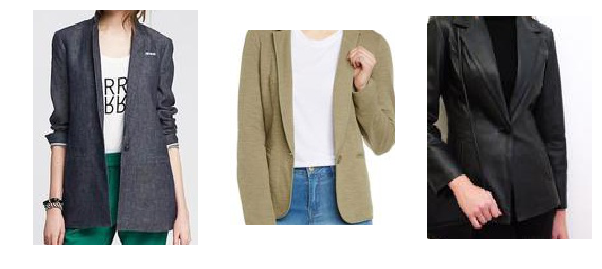

pos_dist: [ 0.97734022] neg_dist: [ 1.52460849] diff: [ 0.54726827] alpha: 0.05
[False]
pos_dist: [ 1.28537405] neg_dist: [ 1.46235728] diff: [ 0.17698324] alpha: 0.05
[False]
pos_dist: [ 1.13866329] neg_dist: [ 1.7079258] diff: [ 0.5692625] alpha: 0.05
[False]
pos_dist: [ 1.33426487] neg_dist: [ 1.41779184] diff: [ 0.08352697] alpha: 0.05
[False]
pos_dist: [ 1.3231411] neg_dist: [ 1.47609687] diff: [ 0.15295577] alpha: 0.05
[False]
pos_dist: [ 1.25792789] neg_dist: [ 1.39597893] diff: [ 0.13805103] alpha: 0.05
[False]
pos_dist: [ 1.24915218] neg_dist: [ 1.38394582] diff: [ 0.13479364] alpha: 0.05
[False]
pos_dist: [ 1.5147779] neg_dist: [ 1.52491903] diff: [ 0.01014113] alpha: 0.05
[ True]


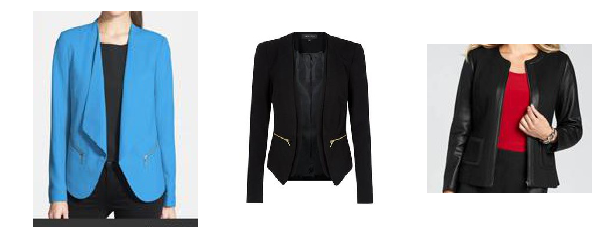

pos_dist: [ 1.35292828] neg_dist: [ 1.54692435] diff: [ 0.19399607] alpha: 0.05
[False]
pos_dist: [ 1.51728654] neg_dist: [ 1.45664656] diff: [-0.06063998] alpha: 0.05
[ True]


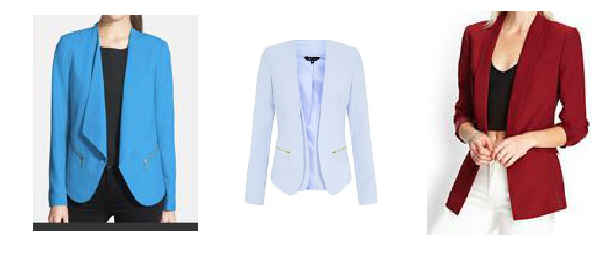

pos_dist: [ 1.49200797] neg_dist: [ 1.38915372] diff: [-0.10285425] alpha: 0.05
[ True]


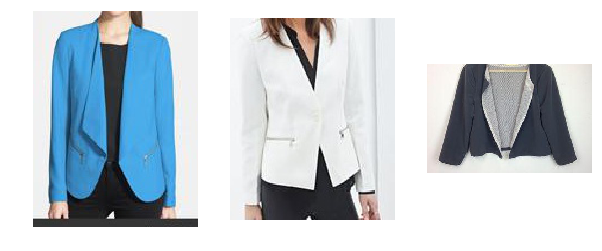

pos_dist: [ 1.50198245] neg_dist: [ 1.5075314] diff: [ 0.00554895] alpha: 0.05
[ True]


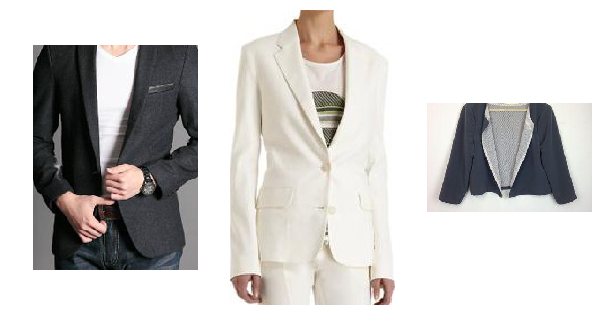

pos_dist: [ 1.44033241] neg_dist: [ 1.34487629] diff: [-0.09545612] alpha: 0.05
[ True]


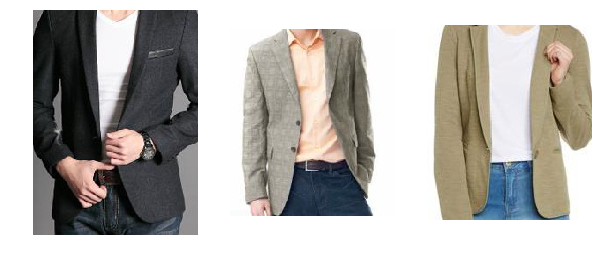

pos_dist: [ 1.70907199] neg_dist: [ 1.47836757] diff: [-0.23070443] alpha: 0.05
[ True]


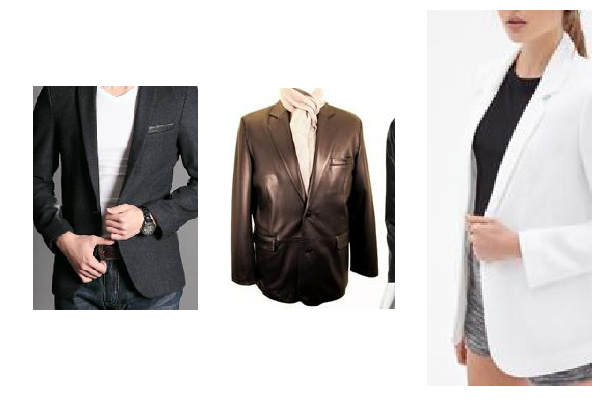

pos_dist: [ 1.48726225] neg_dist: [ 1.34615707] diff: [-0.14110518] alpha: 0.05
[ True]


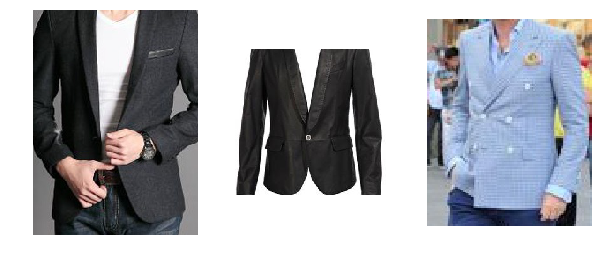

pos_dist: [ 1.40319777] neg_dist: [ 1.5816673] diff: [ 0.17846954] alpha: 0.05
[False]
pos_dist: [ 1.36122704] neg_dist: [ 1.40982699] diff: [ 0.04859996] alpha: 0.05
[ True]


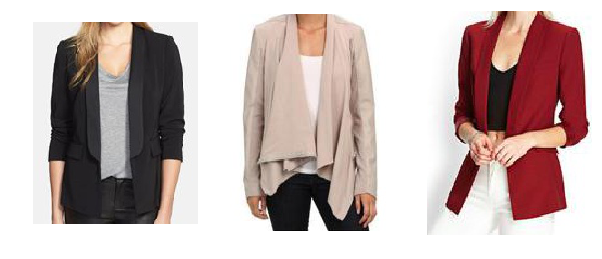

pos_dist: [ 1.27998638] neg_dist: [ 1.38737953] diff: [ 0.10739315] alpha: 0.05
[False]
pos_dist: [ 1.46435571] neg_dist: [ 1.29817915] diff: [-0.16617656] alpha: 0.05
[ True]


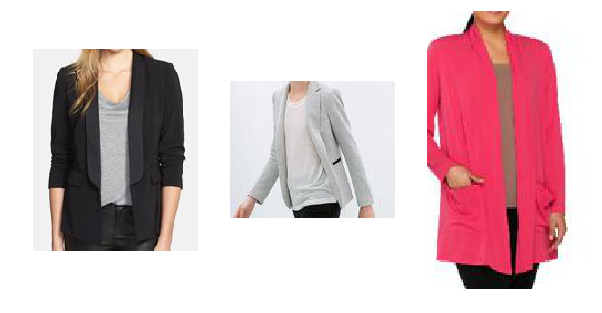

pos_dist: [ 1.32199657] neg_dist: [ 1.22202373] diff: [-0.09997284] alpha: 0.05
[ True]


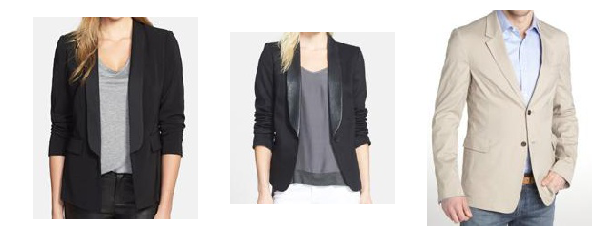

pos_dist: [ 1.42416549] neg_dist: [ 1.62177849] diff: [ 0.197613] alpha: 0.05
[False]
pos_dist: [ 1.4612478] neg_dist: [ 1.59896791] diff: [ 0.13772011] alpha: 0.05
[False]
pos_dist: [ 1.38868237] neg_dist: [ 1.35471606] diff: [-0.0339663] alpha: 0.05
[ True]


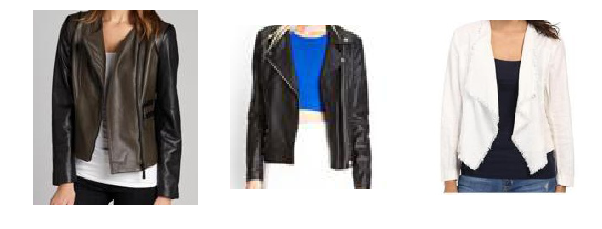

pos_dist: [ 1.47238088] neg_dist: [ 1.39159346] diff: [-0.08078742] alpha: 0.05
[ True]


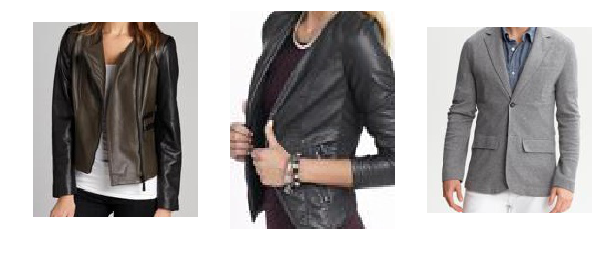

pos_dist: [ 1.41044557] neg_dist: [ 1.58088446] diff: [ 0.17043889] alpha: 0.05
[False]
pos_dist: [ 1.24557424] neg_dist: [ 1.32349491] diff: [ 0.07792068] alpha: 0.05
[False]
pos_dist: [ 1.24607897] neg_dist: [ 1.37054098] diff: [ 0.12446201] alpha: 0.05
[False]
pos_dist: [ 1.22290778] neg_dist: [ 1.5275625] diff: [ 0.30465472] alpha: 0.05
[False]
pos_dist: [ 1.4614675] neg_dist: [ 1.40535593] diff: [-0.05611157] alpha: 0.05
[ True]


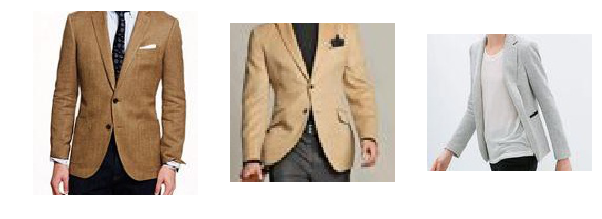

pos_dist: [ 1.47940516] neg_dist: [ 1.47097802] diff: [-0.00842714] alpha: 0.05
[ True]


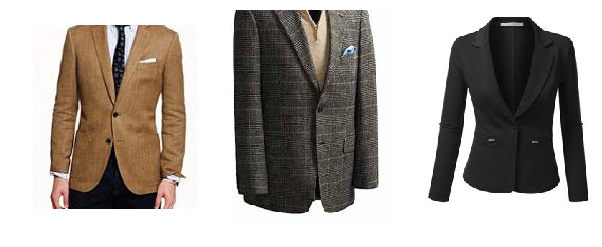

pos_dist: [ 1.65392208] neg_dist: [ 1.39511704] diff: [-0.25880504] alpha: 0.05
[ True]


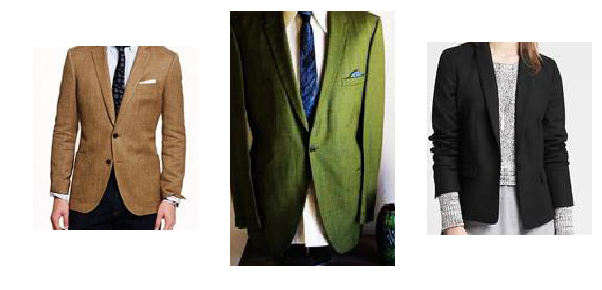

pos_dist: [ 1.4091785] neg_dist: [ 1.49630356] diff: [ 0.08712506] alpha: 0.05
[False]
pos_dist: [ 1.2234894] neg_dist: [ 1.67375278] diff: [ 0.45026338] alpha: 0.05
[False]
pos_dist: [ 1.26808739] neg_dist: [ 1.42319489] diff: [ 0.1551075] alpha: 0.05
[False]
pos_dist: [ 1.31600308] neg_dist: [ 1.3651073] diff: [ 0.04910421] alpha: 0.05
[ True]


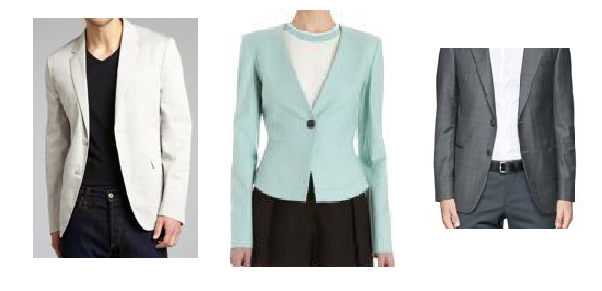

pos_dist: [ 1.45617175] neg_dist: [ 1.47732377] diff: [ 0.02115202] alpha: 0.05
[ True]


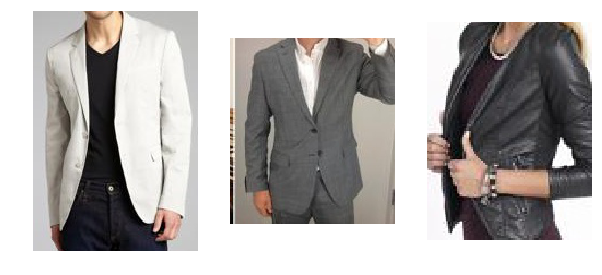

pos_dist: [ 1.40670061] neg_dist: [ 1.4253633] diff: [ 0.01866269] alpha: 0.05
[ True]


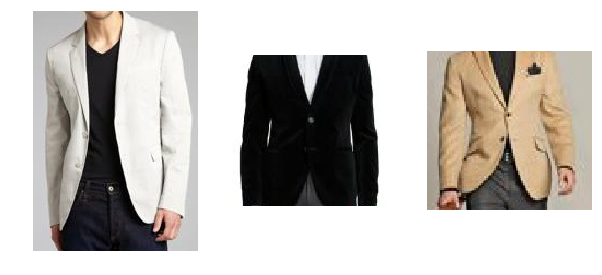

pos_dist: [ 1.26538301] neg_dist: [ 1.44884253] diff: [ 0.18345952] alpha: 0.05
[False]
pos_dist: [ 1.31349909] neg_dist: [ 1.3855741] diff: [ 0.07207501] alpha: 0.05
[False]
pos_dist: [ 1.3373853] neg_dist: [ 1.54190135] diff: [ 0.20451605] alpha: 0.05
[False]
pos_dist: [ 1.30900097] neg_dist: [ 1.37606692] diff: [ 0.06706595] alpha: 0.05
[False]
pos_dist: [ 1.50052142] neg_dist: [ 1.4478302] diff: [-0.05269122] alpha: 0.05
[ True]


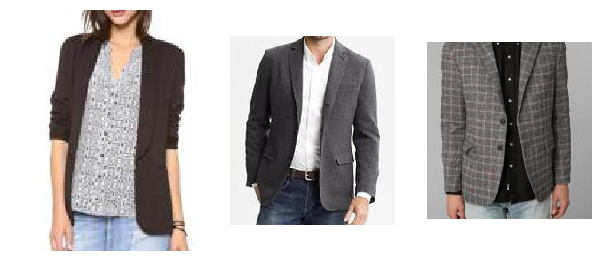

pos_dist: [ 1.37606251] neg_dist: [ 1.5845449] diff: [ 0.20848238] alpha: 0.05
[False]
pos_dist: [ 1.44378138] neg_dist: [ 1.27969646] diff: [-0.16408491] alpha: 0.05
[ True]


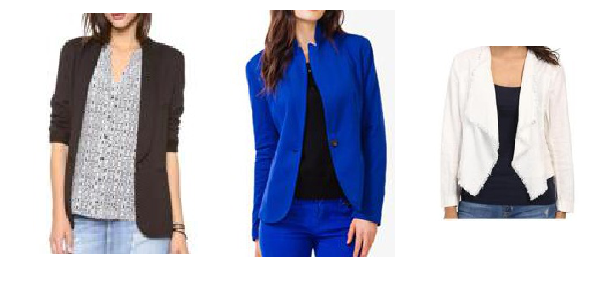

pos_dist: [ 1.43597126] neg_dist: [ 1.23458409] diff: [-0.20138717] alpha: 0.05
[ True]


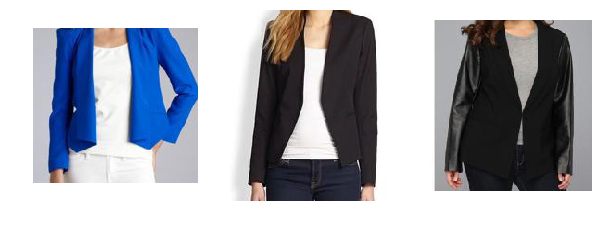

pos_dist: [ 1.3821547] neg_dist: [ 1.60618281] diff: [ 0.22402811] alpha: 0.05
[False]
pos_dist: [ 1.35971534] neg_dist: [ 1.35154688] diff: [-0.00816846] alpha: 0.05
[ True]


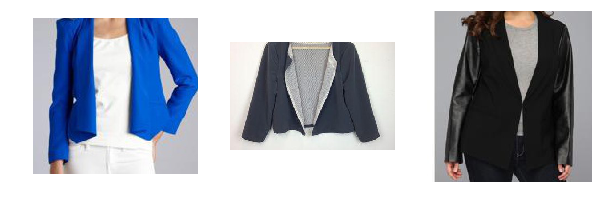

pos_dist: [ 1.41543388] neg_dist: [ 1.64327526] diff: [ 0.22784138] alpha: 0.05
[False]
pos_dist: [ 1.33641016] neg_dist: [ 1.39667988] diff: [ 0.06026971] alpha: 0.05
[False]
pos_dist: [ 1.5071069] neg_dist: [ 1.57350564] diff: [ 0.06639874] alpha: 0.05
[False]
pos_dist: [ 1.29130864] neg_dist: [ 1.42878628] diff: [ 0.13747764] alpha: 0.05
[False]
pos_dist: [ 1.22835457] neg_dist: [ 1.57492113] diff: [ 0.34656656] alpha: 0.05
[False]
pos_dist: [ 1.47258496] neg_dist: [ 1.32795262] diff: [-0.14463234] alpha: 0.05
[ True]


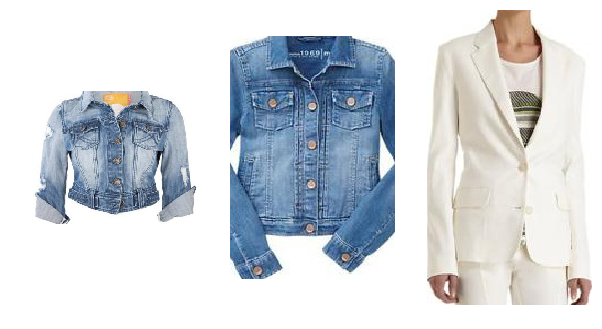

pos_dist: [ 1.43838739] neg_dist: [ 1.545542] diff: [ 0.10715461] alpha: 0.05
[False]
pos_dist: [ 1.26600718] neg_dist: [ 1.44261444] diff: [ 0.17660725] alpha: 0.05
[False]
pos_dist: [ 1.39710355] neg_dist: [ 1.51165223] diff: [ 0.11454868] alpha: 0.05
[False]
pos_dist: [ 1.40392923] neg_dist: [ 1.6478318] diff: [ 0.24390256] alpha: 0.05
[False]
pos_dist: [ 1.3987093] neg_dist: [ 1.49894452] diff: [ 0.10023522] alpha: 0.05
[False]
pos_dist: [ 1.19634891] neg_dist: [ 1.39483011] diff: [ 0.1984812] alpha: 0.05
[False]
pos_dist: [ 1.32902551] neg_dist: [ 1.40195799] diff: [ 0.07293248] alpha: 0.05
[False]
pos_dist: [ 1.47919011] neg_dist: [ 1.48644221] diff: [ 0.0072521] alpha: 0.05
[ True]


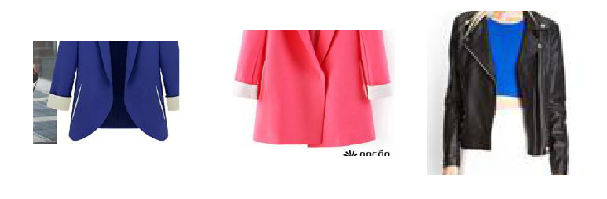

pos_dist: [ 1.17241693] neg_dist: [ 1.66816032] diff: [ 0.49574339] alpha: 0.05
[False]
pos_dist: [ 1.30792534] neg_dist: [ 1.37296653] diff: [ 0.06504118] alpha: 0.05
[False]
pos_dist: [ 1.35052061] neg_dist: [ 1.64479768] diff: [ 0.29427707] alpha: 0.05
[False]
pos_dist: [ 1.36822295] neg_dist: [ 1.45330882] diff: [ 0.08508587] alpha: 0.05
[False]
pos_dist: [ 1.44582164] neg_dist: [ 1.62787616] diff: [ 0.18205452] alpha: 0.05
[False]
pos_dist: [ 1.46991277] neg_dist: [ 1.63746667] diff: [ 0.1675539] alpha: 0.05
[False]
pos_dist: [ 1.12235045] neg_dist: [ 1.50691199] diff: [ 0.38456154] alpha: 0.05
[False]
pos_dist: [ 1.32949507] neg_dist: [ 1.51240516] diff: [ 0.18291008] alpha: 0.05
[False]
pos_dist: [ 1.32864928] neg_dist: [ 1.47432101] diff: [ 0.14567173] alpha: 0.05
[False]
pos_dist: [ 1.34509957] neg_dist: [ 1.48427641] diff: [ 0.13917685] alpha: 0.05
[False]
pos_dist: [ 1.35493052] neg_dist: [ 1.59098268] diff: [ 0.23605216] alpha: 0.05
[False]
pos_dist: [ 1.17255592] neg_dist:

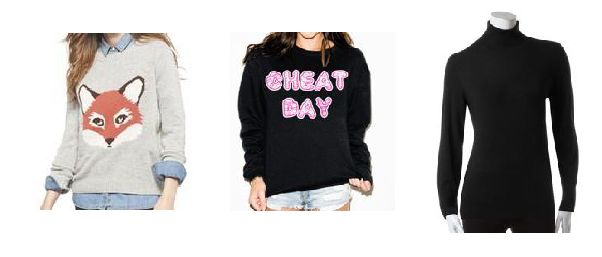

pos_dist: [ 1.40585029] neg_dist: [ 1.39010525] diff: [-0.01574504] alpha: 0.05
[ True]


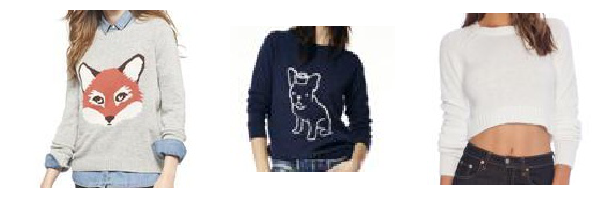

pos_dist: [ 1.27105093] neg_dist: [ 1.55343378] diff: [ 0.28238285] alpha: 0.05
[False]
pos_dist: [ 1.37174225] neg_dist: [ 1.34016716] diff: [-0.03157508] alpha: 0.05
[ True]


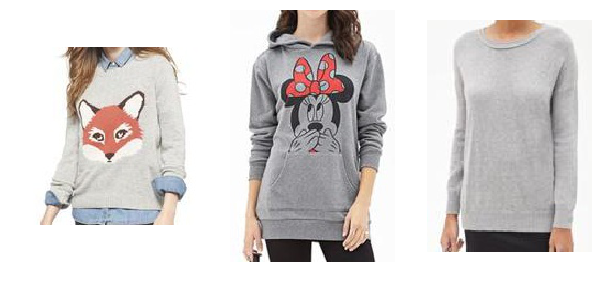

pos_dist: [ 1.25696659] neg_dist: [ 1.68516827] diff: [ 0.42820168] alpha: 0.05
[False]
pos_dist: [ 1.27947211] neg_dist: [ 1.17223477] diff: [-0.10723734] alpha: 0.05
[ True]


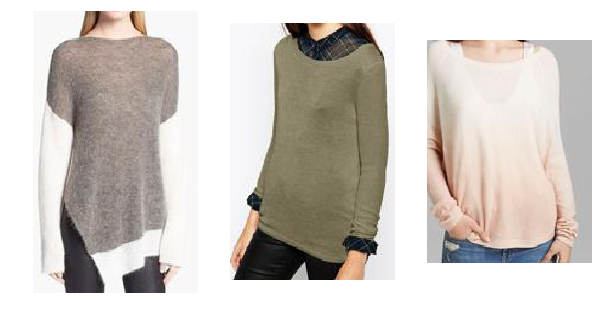

pos_dist: [ 1.45357609] neg_dist: [ 1.31849849] diff: [-0.1350776] alpha: 0.05
[ True]


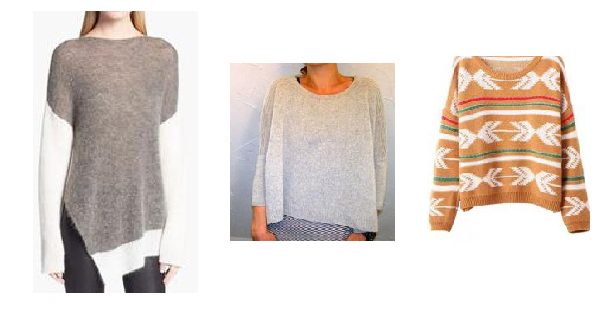

pos_dist: [ 1.39492846] neg_dist: [ 1.2619288] diff: [-0.13299966] alpha: 0.05
[ True]


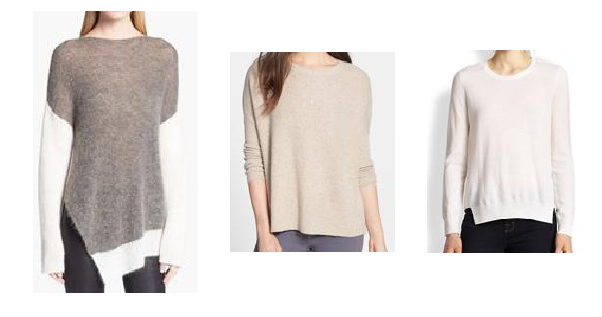

pos_dist: [ 1.24790692] neg_dist: [ 1.37677789] diff: [ 0.12887096] alpha: 0.05
[False]
pos_dist: [ 1.5989126] neg_dist: [ 1.51697469] diff: [-0.08193791] alpha: 0.05
[ True]


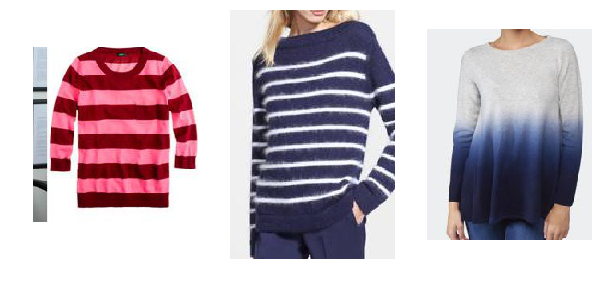

pos_dist: [ 1.44415998] neg_dist: [ 1.5495472] diff: [ 0.10538721] alpha: 0.05
[False]
pos_dist: [ 1.53641236] neg_dist: [ 1.49650192] diff: [-0.03991044] alpha: 0.05
[ True]


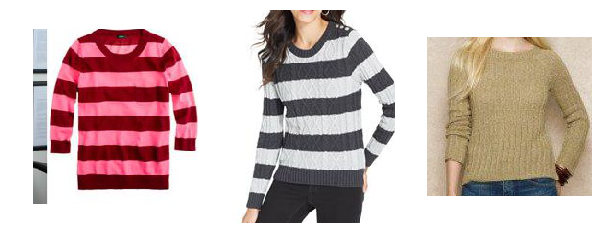

pos_dist: [ 1.33467603] neg_dist: [ 1.56043243] diff: [ 0.22575641] alpha: 0.05
[False]
pos_dist: [ 1.45661521] neg_dist: [ 1.46923447] diff: [ 0.01261926] alpha: 0.05
[ True]


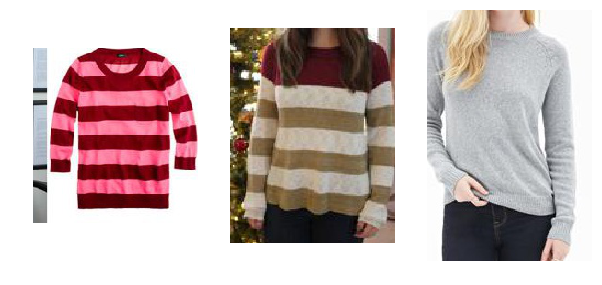

pos_dist: [ 1.40887833] neg_dist: [ 1.60445619] diff: [ 0.19557786] alpha: 0.05
[False]
pos_dist: [ 1.33329439] neg_dist: [ 1.33538318] diff: [ 0.00208879] alpha: 0.05
[ True]


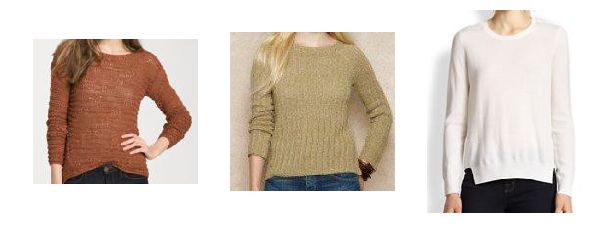

pos_dist: [ 1.3101052] neg_dist: [ 1.53978205] diff: [ 0.22967684] alpha: 0.05
[False]
pos_dist: [ 1.25235248] neg_dist: [ 1.37283838] diff: [ 0.1204859] alpha: 0.05
[False]
pos_dist: [ 1.32224786] neg_dist: [ 1.41943979] diff: [ 0.09719193] alpha: 0.05
[False]
pos_dist: [ 1.20876467] neg_dist: [ 1.39382696] diff: [ 0.18506229] alpha: 0.05
[False]
pos_dist: [ 1.31787074] neg_dist: [ 1.33656788] diff: [ 0.01869714] alpha: 0.05
[ True]


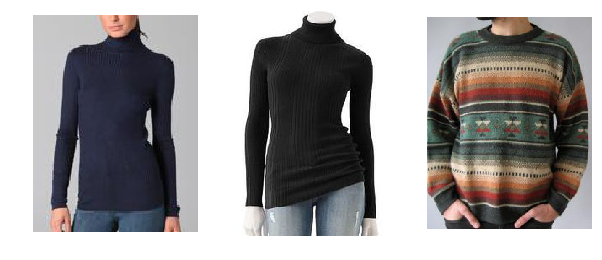

pos_dist: [ 1.41840386] neg_dist: [ 1.28822589] diff: [-0.13017797] alpha: 0.05
[ True]


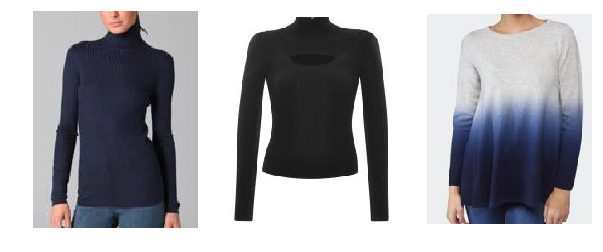

pos_dist: [ 0.96409291] neg_dist: [ 1.50977981] diff: [ 0.5456869] alpha: 0.05
[False]
pos_dist: [ 1.39054739] neg_dist: [ 1.52829552] diff: [ 0.13774812] alpha: 0.05
[False]
pos_dist: [ 1.246768] neg_dist: [ 1.38558507] diff: [ 0.13881707] alpha: 0.05
[False]
pos_dist: [ 1.34628248] neg_dist: [ 1.45517588] diff: [ 0.10889339] alpha: 0.05
[False]
pos_dist: [ 1.41639102] neg_dist: [ 1.43983173] diff: [ 0.02344072] alpha: 0.05
[ True]


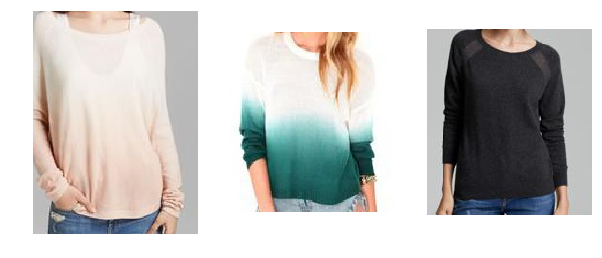

pos_dist: [ 1.21201968] neg_dist: [ 1.33265662] diff: [ 0.12063694] alpha: 0.05
[False]
pos_dist: [ 1.40145898] neg_dist: [ 1.45442665] diff: [ 0.05296767] alpha: 0.05
[False]
pos_dist: [ 1.25711489] neg_dist: [ 1.57686639] diff: [ 0.3197515] alpha: 0.05
[False]
pos_dist: [ 1.19902241] neg_dist: [ 1.46308684] diff: [ 0.26406443] alpha: 0.05
[False]
pos_dist: [ 1.31450343] neg_dist: [ 1.46753073] diff: [ 0.1530273] alpha: 0.05
[False]
pos_dist: [ 1.29910731] neg_dist: [ 1.3415482] diff: [ 0.04244089] alpha: 0.05
[ True]


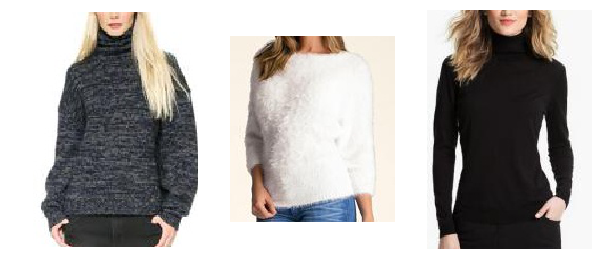

pos_dist: [ 1.42164016] neg_dist: [ 1.49214375] diff: [ 0.07050359] alpha: 0.05
[False]
pos_dist: [ 1.3568747] neg_dist: [ 1.31987226] diff: [-0.03700244] alpha: 0.05
[ True]


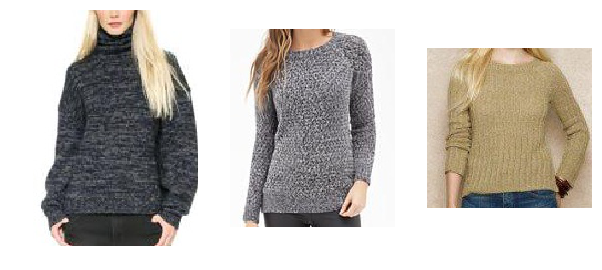

pos_dist: [ 1.49789202] neg_dist: [ 1.41752386] diff: [-0.08036816] alpha: 0.05
[ True]


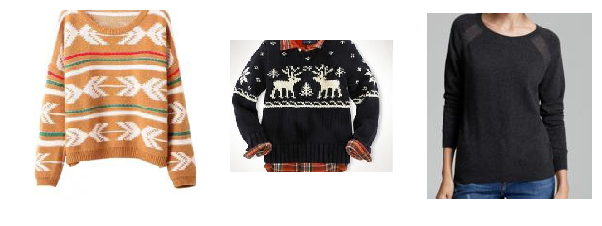

pos_dist: [ 1.3874402] neg_dist: [ 1.44410837] diff: [ 0.05666816] alpha: 0.05
[False]
pos_dist: [ 1.44984078] neg_dist: [ 1.39659429] diff: [-0.0532465] alpha: 0.05
[ True]


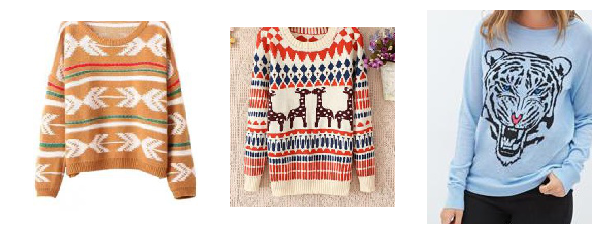

pos_dist: [ 1.49776065] neg_dist: [ 1.51329672] diff: [ 0.01553607] alpha: 0.05
[ True]


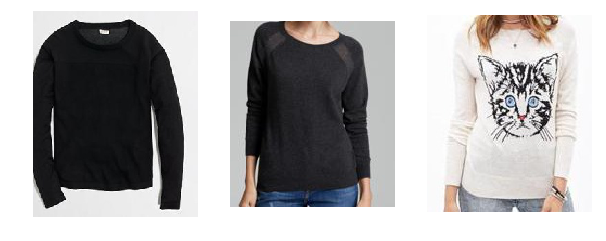

pos_dist: [ 1.46271646] neg_dist: [ 1.4259758] diff: [-0.03674066] alpha: 0.05
[ True]


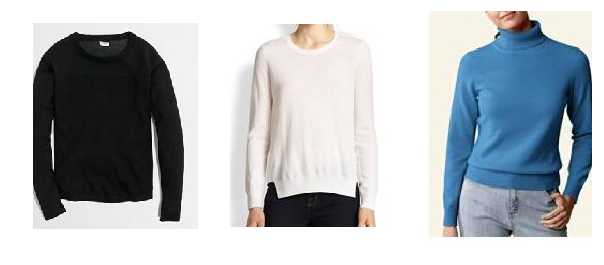

pos_dist: [ 1.36523962] neg_dist: [ 1.53815317] diff: [ 0.17291355] alpha: 0.05
[False]
pos_dist: [ 1.27602768] neg_dist: [ 1.49991024] diff: [ 0.22388256] alpha: 0.05
[False]
pos_dist: [ 1.26330817] neg_dist: [ 1.53812075] diff: [ 0.27481258] alpha: 0.05
[False]
pos_dist: [ 1.46655512] neg_dist: [ 1.63642049] diff: [ 0.16986537] alpha: 0.05
[False]
pos_dist: [ 1.27508855] neg_dist: [ 1.37648368] diff: [ 0.10139513] alpha: 0.05
[False]
pos_dist: [ 1.32904375] neg_dist: [ 1.39106774] diff: [ 0.062024] alpha: 0.05
[False]
pos_dist: [ 1.61286831] neg_dist: [ 1.61684251] diff: [ 0.0039742] alpha: 0.05
[ True]


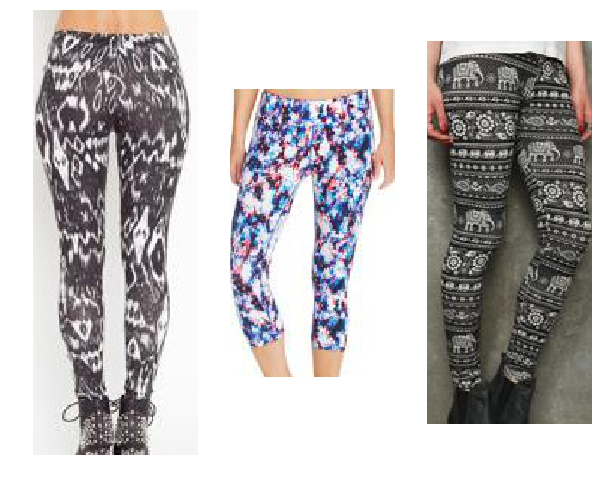

pos_dist: [ 1.37313032] neg_dist: [ 1.54630649] diff: [ 0.17317617] alpha: 0.05
[False]
pos_dist: [ 1.45607734] neg_dist: [ 1.45291293] diff: [-0.00316441] alpha: 0.05
[ True]


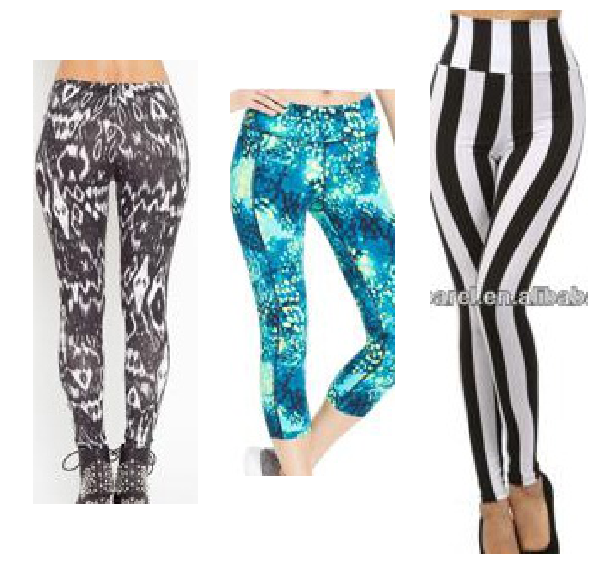

pos_dist: [ 1.53305161] neg_dist: [ 1.56865335] diff: [ 0.03560174] alpha: 0.05
[ True]


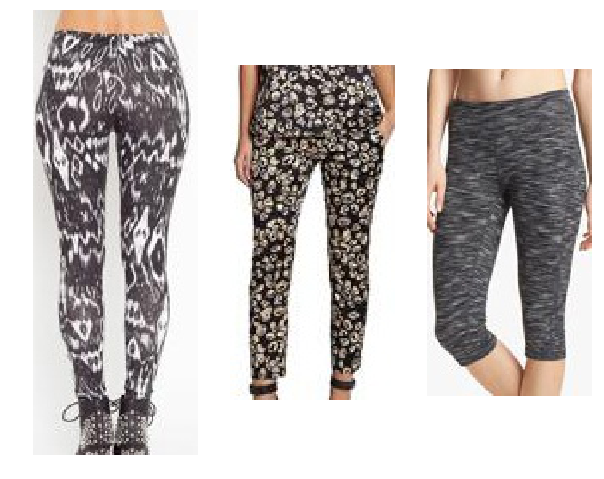

pos_dist: [ 1.26117194] neg_dist: [ 1.39445877] diff: [ 0.13328683] alpha: 0.05
[False]
pos_dist: [ 1.28981876] neg_dist: [ 1.56893373] diff: [ 0.27911496] alpha: 0.05
[False]
pos_dist: [ 1.5097909] neg_dist: [ 1.46689975] diff: [-0.04289114] alpha: 0.05
[ True]


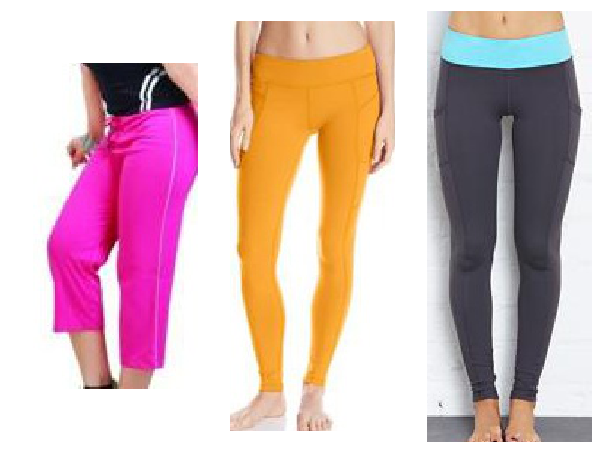

pos_dist: [ 1.38169527] neg_dist: [ 1.43485546] diff: [ 0.05316019] alpha: 0.05
[False]
pos_dist: [ 1.43411183] neg_dist: [ 1.40032887] diff: [-0.03378296] alpha: 0.05
[ True]


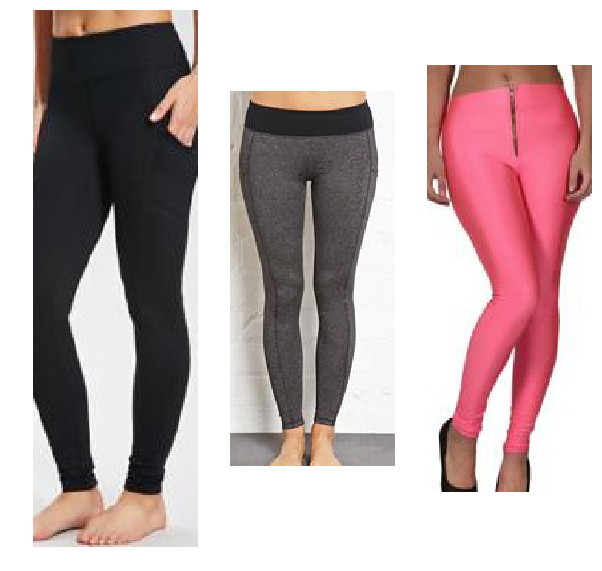

pos_dist: [ 1.34866953] neg_dist: [ 1.1961025] diff: [-0.15256703] alpha: 0.05
[ True]


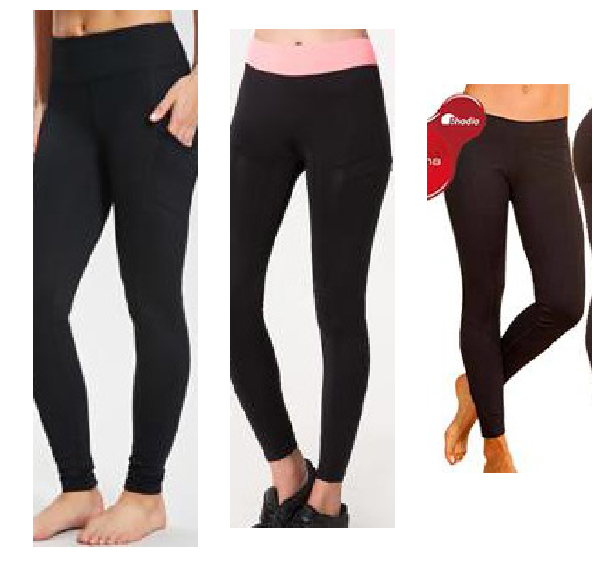

pos_dist: [ 1.35097384] neg_dist: [ 1.40983987] diff: [ 0.05886602] alpha: 0.05
[False]
pos_dist: [ 1.26607513] neg_dist: [ 1.39955497] diff: [ 0.13347983] alpha: 0.05
[False]
pos_dist: [ 1.56734645] neg_dist: [ 1.4198308] diff: [-0.14751565] alpha: 0.05
[ True]


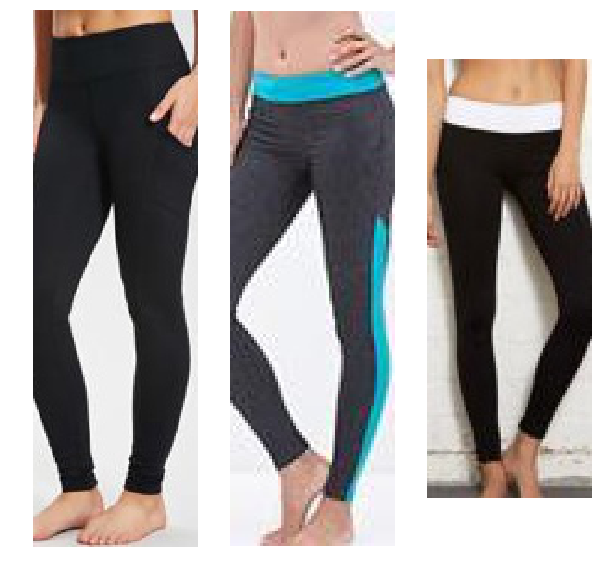

pos_dist: [ 1.380193] neg_dist: [ 1.687567] diff: [ 0.307374] alpha: 0.05
[False]
pos_dist: [ 1.43820262] neg_dist: [ 1.30703676] diff: [-0.13116586] alpha: 0.05
[ True]


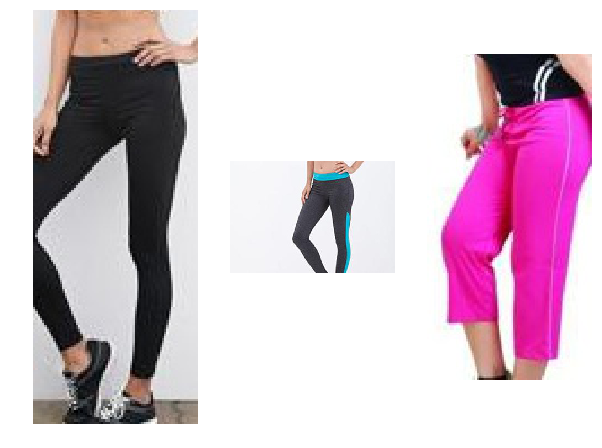

pos_dist: [ 1.44183087] neg_dist: [ 1.27429926] diff: [-0.16753161] alpha: 0.05
[ True]


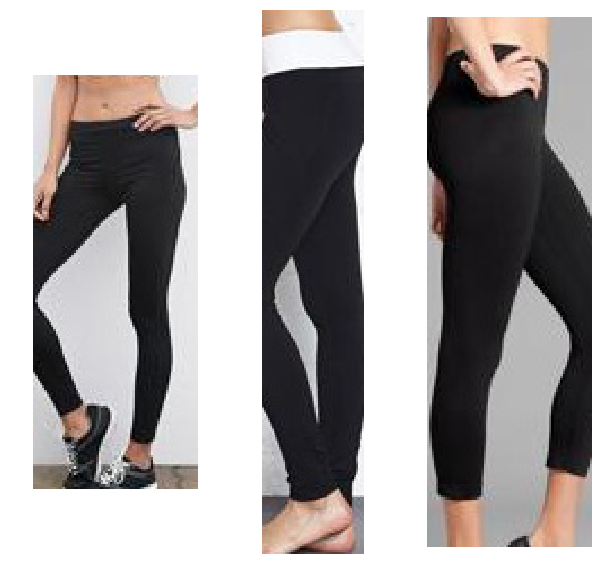

pos_dist: [ 1.45263469] neg_dist: [ 1.41410851] diff: [-0.03852618] alpha: 0.05
[ True]


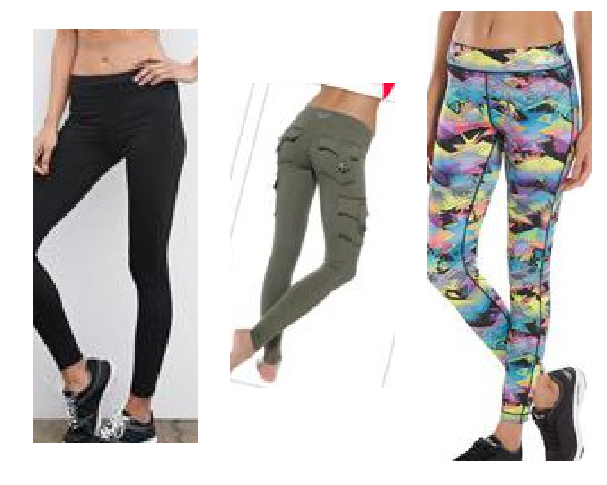

pos_dist: [ 1.45653152] neg_dist: [ 1.36247241] diff: [-0.09405911] alpha: 0.05
[ True]


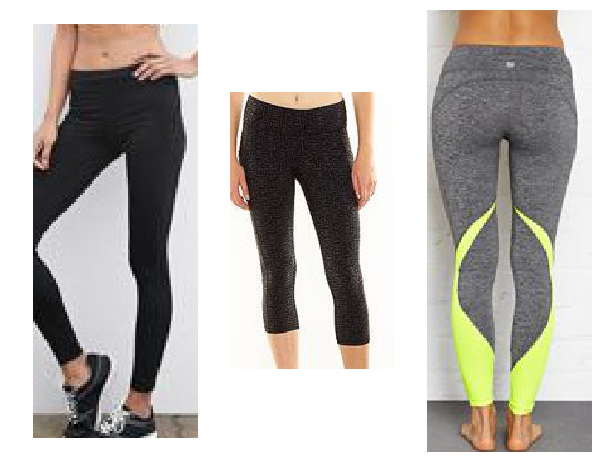

pos_dist: [ 1.3073554] neg_dist: [ 1.33106589] diff: [ 0.02371049] alpha: 0.05
[ True]


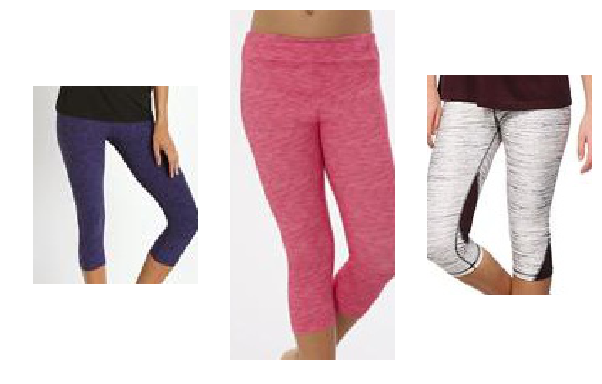

pos_dist: [ 1.40620494] neg_dist: [ 1.46262264] diff: [ 0.0564177] alpha: 0.05
[False]
pos_dist: [ 1.35152245] neg_dist: [ 1.54871976] diff: [ 0.19719732] alpha: 0.05
[False]
pos_dist: [ 1.29196513] neg_dist: [ 1.34107828] diff: [ 0.04911315] alpha: 0.05
[ True]


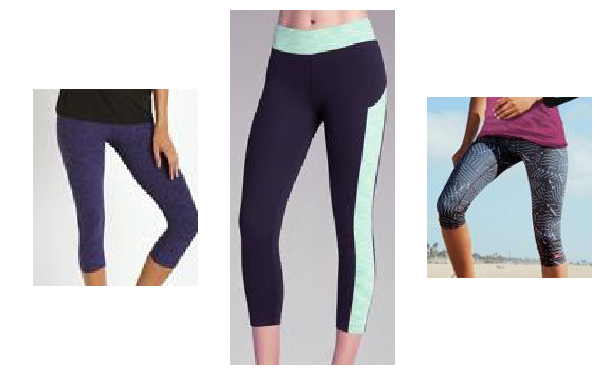

pos_dist: [ 1.25828993] neg_dist: [ 1.41316068] diff: [ 0.15487075] alpha: 0.05
[False]
pos_dist: [ 1.4504509] neg_dist: [ 1.50818217] diff: [ 0.05773127] alpha: 0.05
[False]
pos_dist: [ 1.41225576] neg_dist: [ 1.50848889] diff: [ 0.09623313] alpha: 0.05
[False]
pos_dist: [ 1.3875283] neg_dist: [ 1.53982317] diff: [ 0.15229487] alpha: 0.05
[False]
pos_dist: [ 1.46149135] neg_dist: [ 1.31477499] diff: [-0.14671636] alpha: 0.05
[ True]


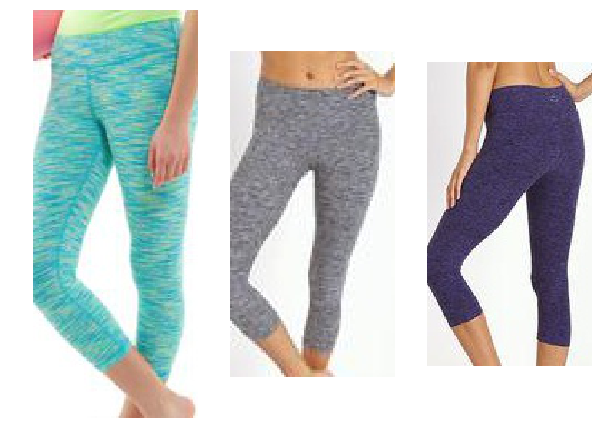

pos_dist: [ 1.30839014] neg_dist: [ 1.45927429] diff: [ 0.15088415] alpha: 0.05
[False]
pos_dist: [ 1.31197298] neg_dist: [ 1.50369453] diff: [ 0.19172156] alpha: 0.05
[False]
pos_dist: [ 1.29878211] neg_dist: [ 1.46810019] diff: [ 0.16931808] alpha: 0.05
[False]
pos_dist: [ 1.31669998] neg_dist: [ 1.41040254] diff: [ 0.09370255] alpha: 0.05
[False]
pos_dist: [ 1.41488624] neg_dist: [ 1.35770416] diff: [-0.05718207] alpha: 0.05
[ True]


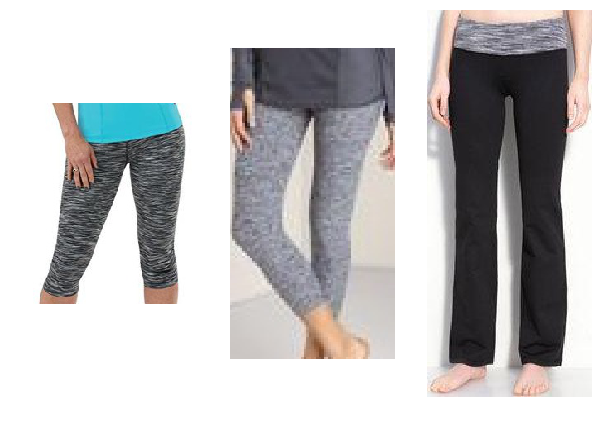

pos_dist: [ 1.44175982] neg_dist: [ 1.40147924] diff: [-0.04028058] alpha: 0.05
[ True]


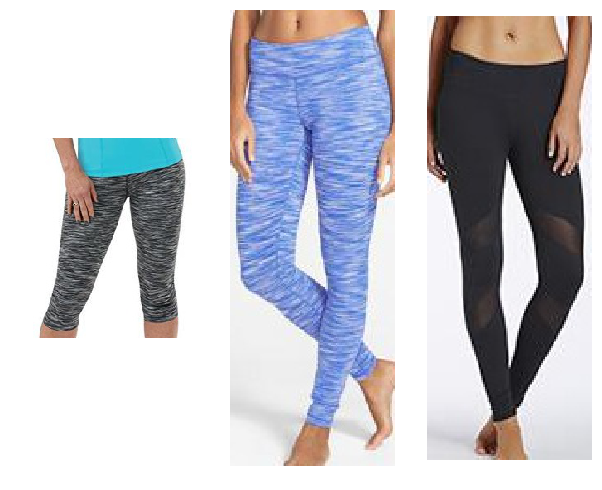

pos_dist: [ 1.35671926] neg_dist: [ 1.48710179] diff: [ 0.13038254] alpha: 0.05
[False]
pos_dist: [ 1.51923394] neg_dist: [ 1.52276874] diff: [ 0.00353479] alpha: 0.05
[ True]


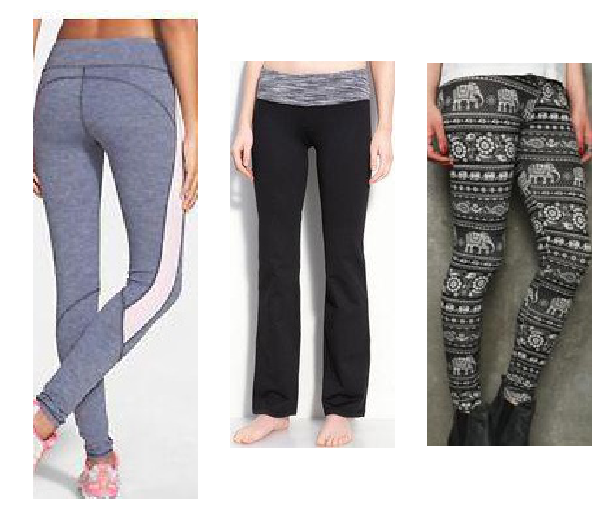

pos_dist: [ 1.23054528] neg_dist: [ 1.46049428] diff: [ 0.229949] alpha: 0.05
[False]
pos_dist: [ 1.39651775] neg_dist: [ 1.33182335] diff: [-0.0646944] alpha: 0.05
[ True]


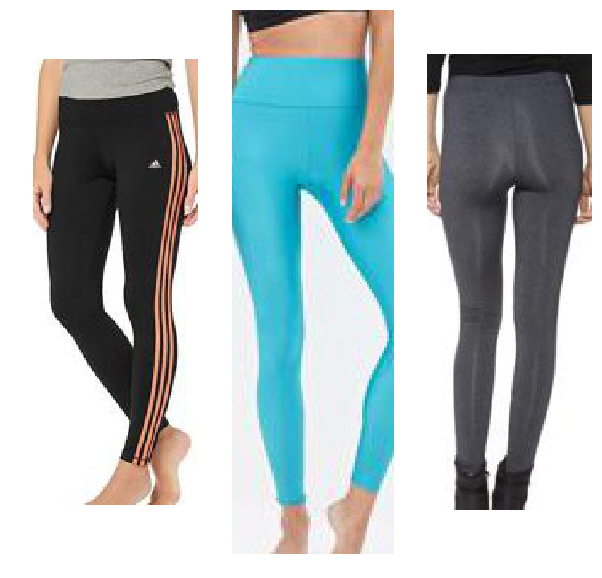

pos_dist: [ 1.32739294] neg_dist: [ 1.49486518] diff: [ 0.16747224] alpha: 0.05
[False]
pos_dist: [ 1.33557224] neg_dist: [ 1.32304668] diff: [-0.01252556] alpha: 0.05
[ True]


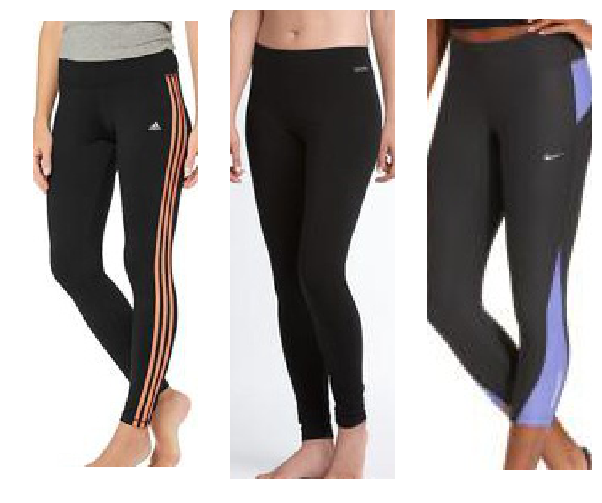

pos_dist: [ 1.46010625] neg_dist: [ 1.5438745] diff: [ 0.08376825] alpha: 0.05
[False]
pos_dist: [ 1.36880636] neg_dist: [ 1.4447906] diff: [ 0.07598424] alpha: 0.05
[False]
pos_dist: [ 1.40603113] neg_dist: [ 1.31354833] diff: [-0.09248281] alpha: 0.05
[ True]


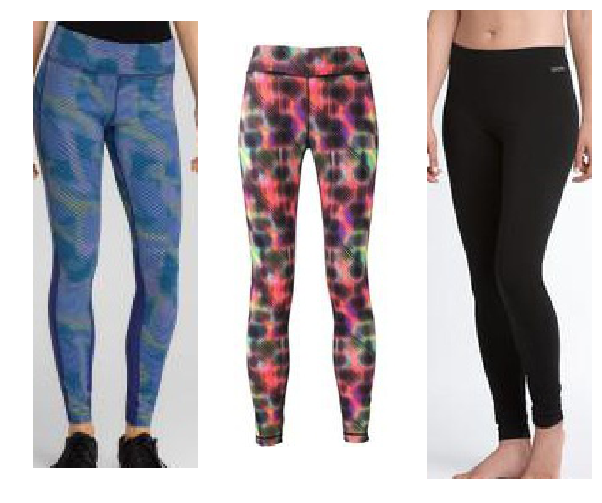

pos_dist: [ 1.49099827] neg_dist: [ 1.42200398] diff: [-0.06899428] alpha: 0.05
[ True]


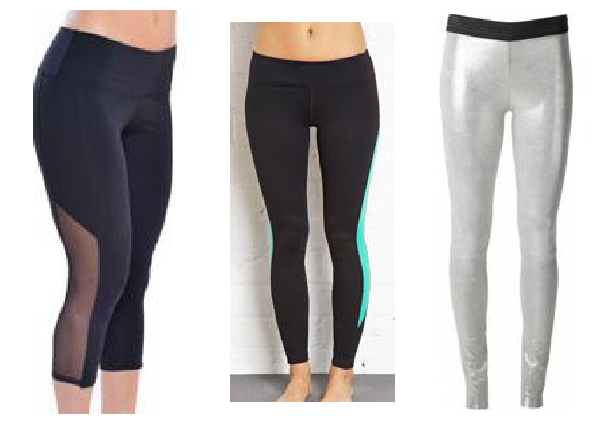

pos_dist: [ 1.39812851] neg_dist: [ 1.4129734] diff: [ 0.01484489] alpha: 0.05
[ True]


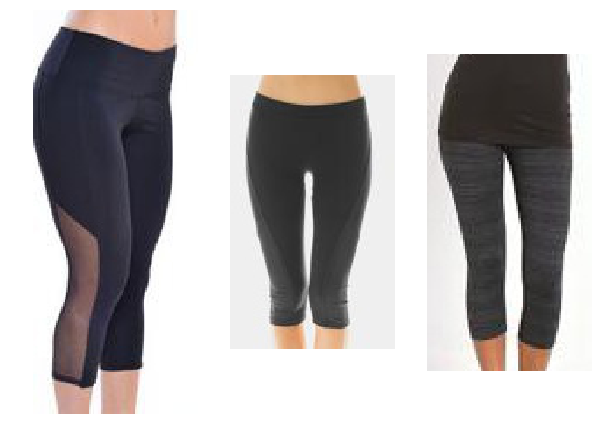

pos_dist: [ 1.43400097] neg_dist: [ 1.29688811] diff: [-0.13711286] alpha: 0.05
[ True]


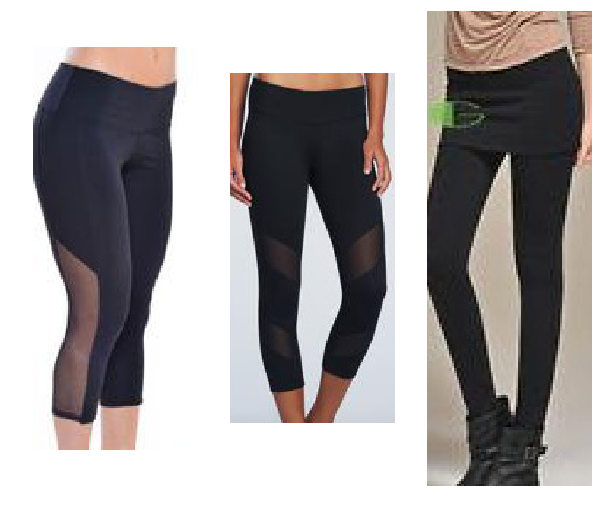

pos_dist: [ 1.53321934] neg_dist: [ 1.57846248] diff: [ 0.04524314] alpha: 0.05
[ True]


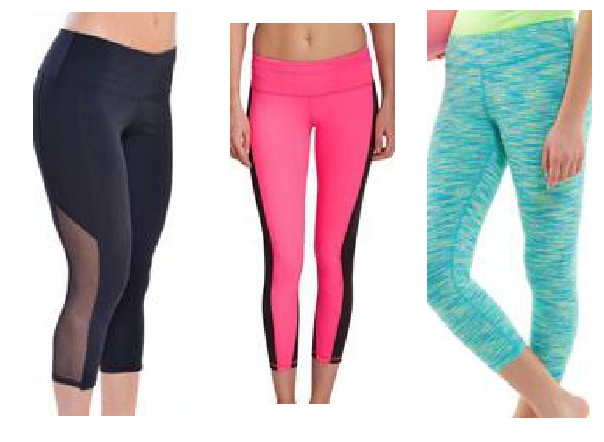

pos_dist: [ 1.44676971] neg_dist: [ 1.47246647] diff: [ 0.02569675] alpha: 0.05
[ True]


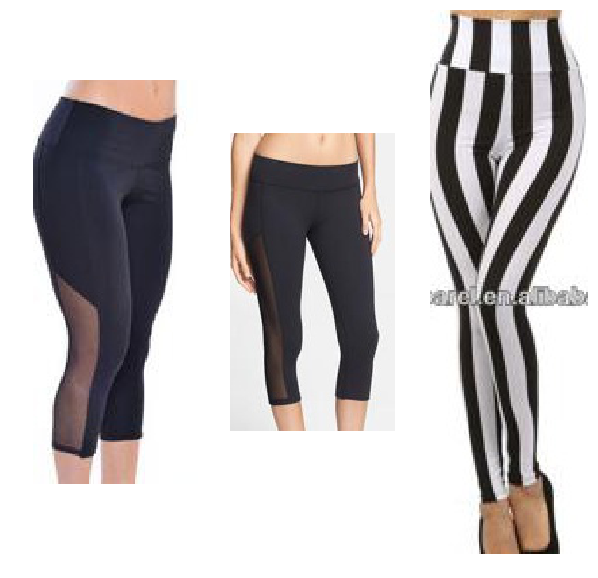

pos_dist: [ 0.91245925] neg_dist: [ 1.39328408] diff: [ 0.48082483] alpha: 0.05
[False]
pos_dist: [ 1.28408527] neg_dist: [ 1.30393445] diff: [ 0.01984918] alpha: 0.05
[ True]


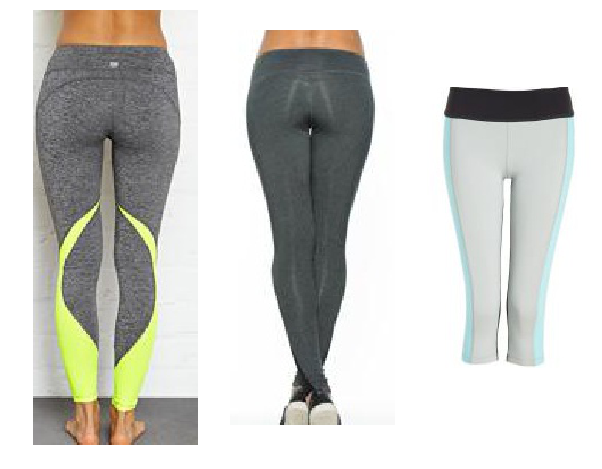

pos_dist: [ 1.4851017] neg_dist: [ 1.61303055] diff: [ 0.12792885] alpha: 0.05
[False]
pos_dist: [ 1.57389355] neg_dist: [ 1.64105844] diff: [ 0.0671649] alpha: 0.05
[False]
pos_dist: [ 1.52809477] neg_dist: [ 1.38985276] diff: [-0.13824201] alpha: 0.05
[ True]


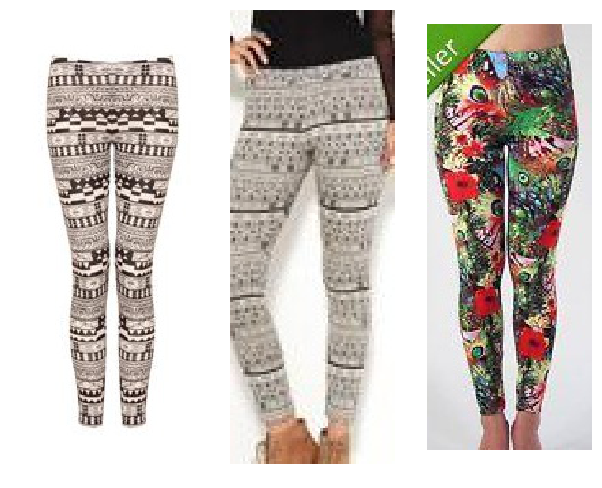

pos_dist: [ 1.47079575] neg_dist: [ 1.38552308] diff: [-0.08527267] alpha: 0.05
[ True]


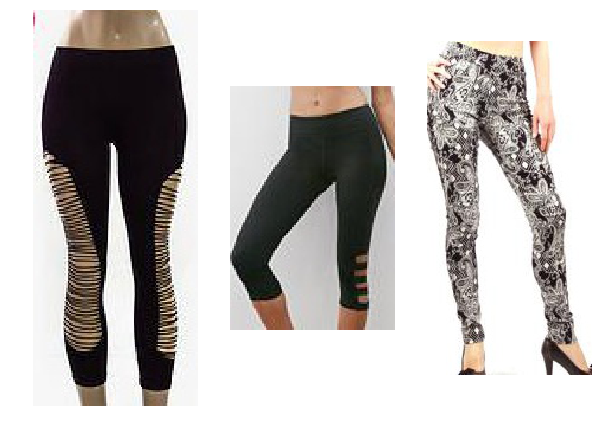

pos_dist: [ 1.52680767] neg_dist: [ 1.48685586] diff: [-0.0399518] alpha: 0.05
[ True]


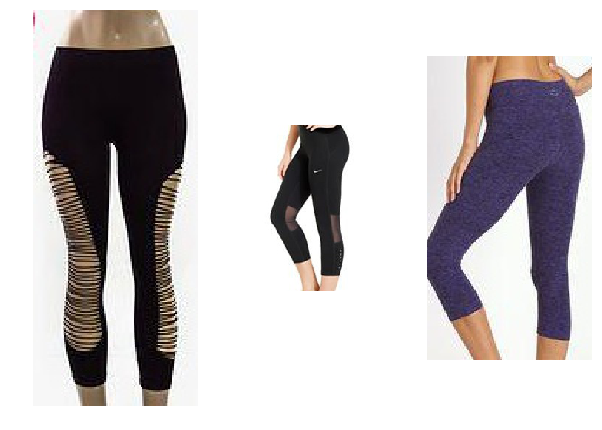

pos_dist: [ 1.38757038] neg_dist: [ 1.40410984] diff: [ 0.01653945] alpha: 0.05
[ True]


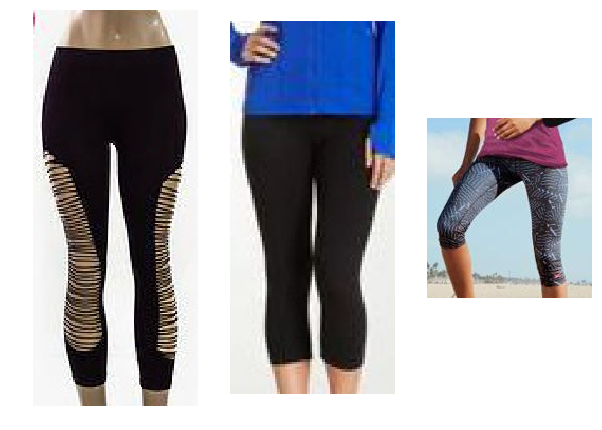

pos_dist: [ 1.410851] neg_dist: [ 1.61103821] diff: [ 0.20018721] alpha: 0.05
[False]
pos_dist: [ 1.443887] neg_dist: [ 1.40263319] diff: [-0.04125381] alpha: 0.05
[ True]


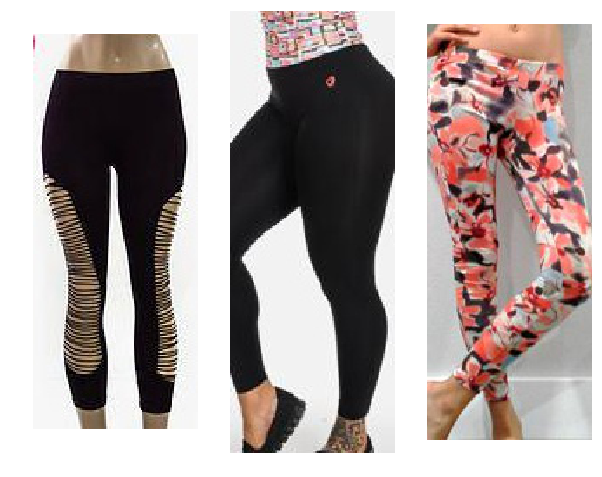

pos_dist: [ 1.39190364] neg_dist: [ 1.50555515] diff: [ 0.11365151] alpha: 0.05
[False]
pos_dist: [ 1.33996344] neg_dist: [ 1.53765523] diff: [ 0.1976918] alpha: 0.05
[False]
pos_dist: [ 1.44491613] neg_dist: [ 1.47782183] diff: [ 0.0329057] alpha: 0.05
[ True]


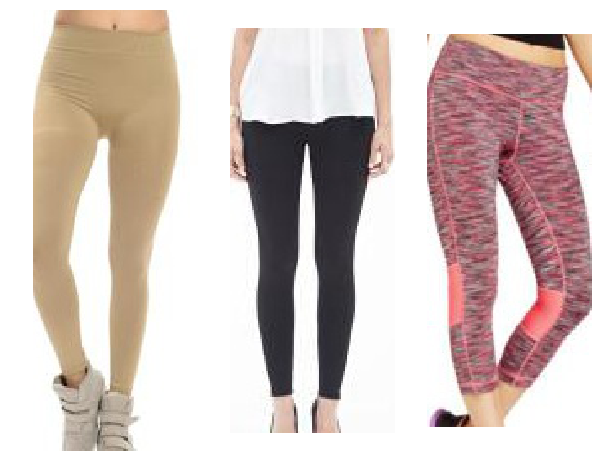

pos_dist: [ 1.48956525] neg_dist: [ 1.46985364] diff: [-0.01971161] alpha: 0.05
[ True]


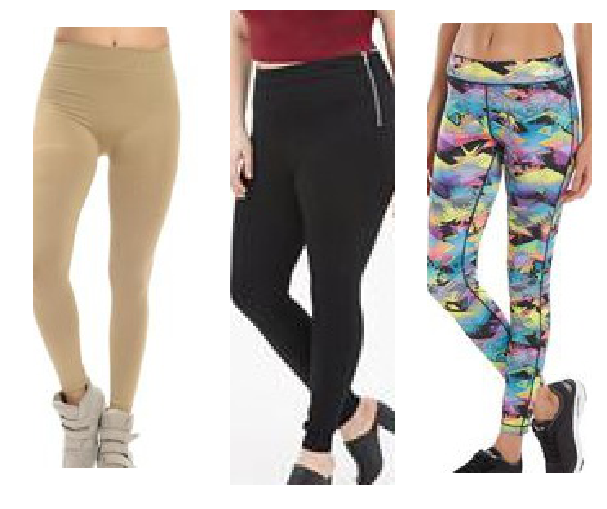

pos_dist: [ 1.3324343] neg_dist: [ 1.38616228] diff: [ 0.05372798] alpha: 0.05
[False]
pos_dist: [ 1.21340322] neg_dist: [ 1.49363792] diff: [ 0.28023469] alpha: 0.05
[False]
pos_dist: [ 1.508443] neg_dist: [ 1.45618391] diff: [-0.05225909] alpha: 0.05
[ True]


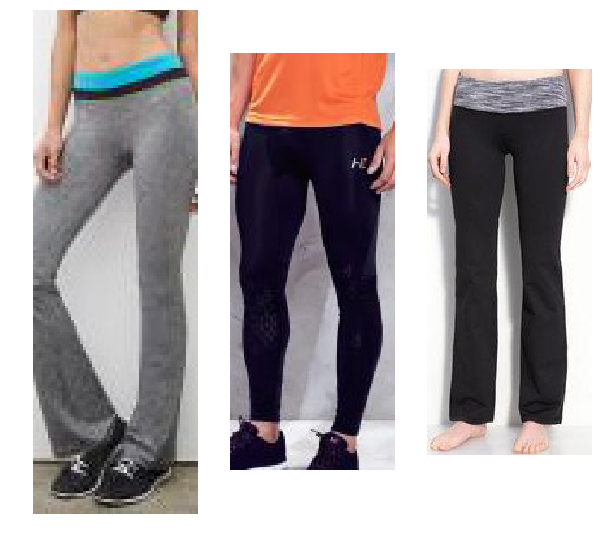

pos_dist: [ 1.48269176] neg_dist: [ 1.53918076] diff: [ 0.05648899] alpha: 0.05
[False]
pos_dist: [ 1.34206009] neg_dist: [ 1.54230297] diff: [ 0.20024288] alpha: 0.05
[False]
pos_dist: [ 1.58518648] neg_dist: [ 1.45630383] diff: [-0.12888265] alpha: 0.05
[ True]


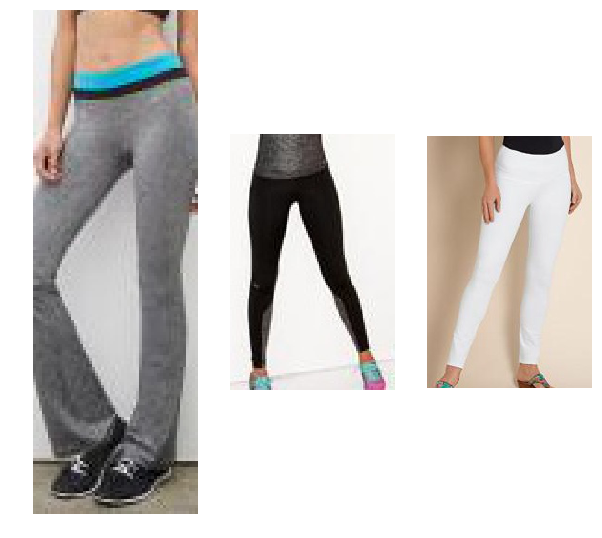

pos_dist: [ 1.19947422] neg_dist: [ 1.40871441] diff: [ 0.2092402] alpha: 0.05
[False]
pos_dist: [ 1.34852767] neg_dist: [ 1.55907822] diff: [ 0.21055055] alpha: 0.05
[False]
pos_dist: [ 1.47192836] neg_dist: [ 1.47239089] diff: [ 0.00046253] alpha: 0.05
[ True]


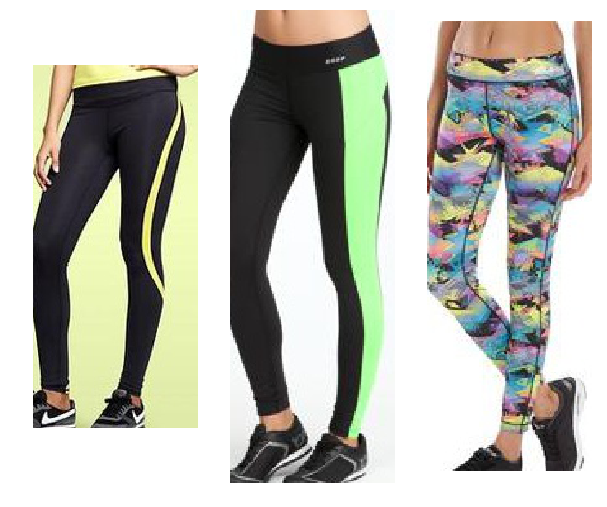

pos_dist: [ 1.65299773] neg_dist: [ 1.45641685] diff: [-0.19658089] alpha: 0.05
[ True]


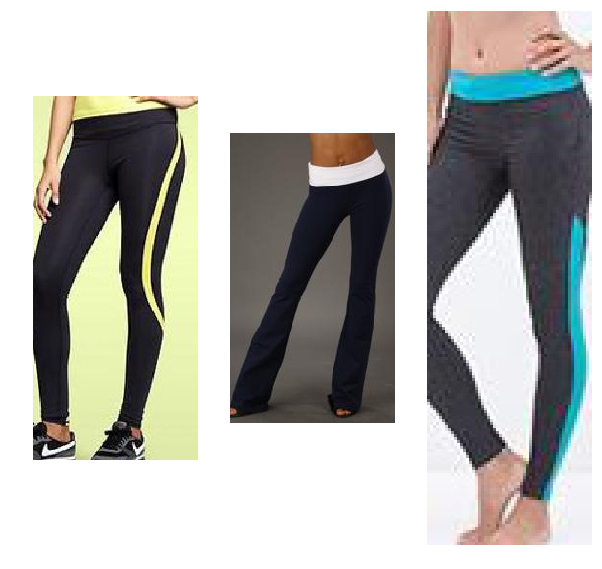

pos_dist: [ 1.35748446] neg_dist: [ 1.62087822] diff: [ 0.26339376] alpha: 0.05
[False]
pos_dist: [ 1.40014386] neg_dist: [ 1.48880506] diff: [ 0.08866119] alpha: 0.05
[False]
pos_dist: [ 1.41613722] neg_dist: [ 1.43303657] diff: [ 0.01689935] alpha: 0.05
[ True]


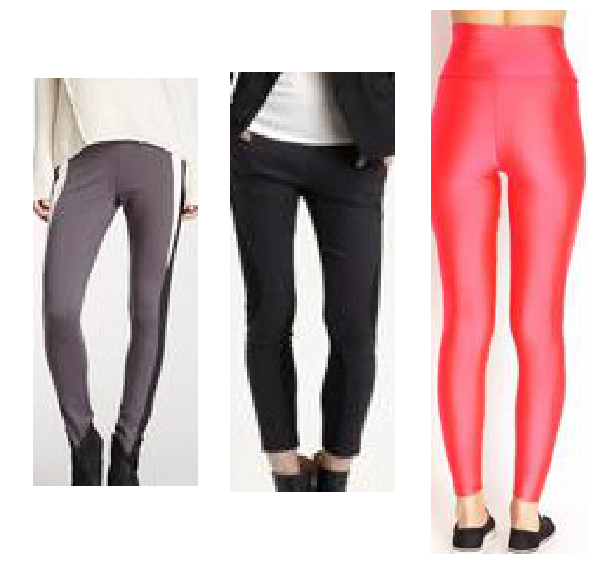

pos_dist: [ 1.44894159] neg_dist: [ 1.43157101] diff: [-0.01737058] alpha: 0.05
[ True]


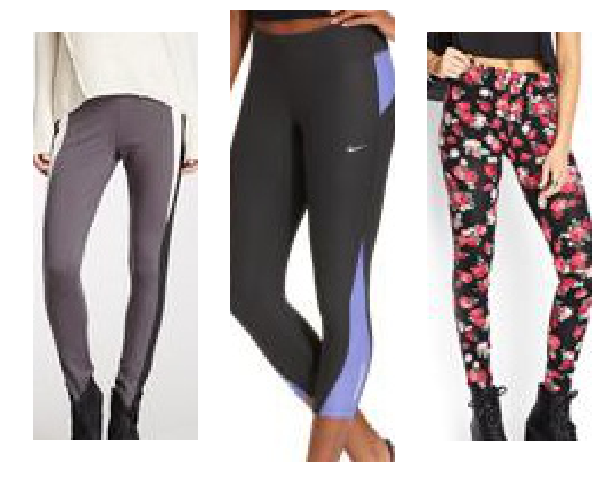

pos_dist: [ 1.32127118] neg_dist: [ 1.52771032] diff: [ 0.20643914] alpha: 0.05
[False]
pos_dist: [ 1.50077832] neg_dist: [ 1.55677962] diff: [ 0.05600131] alpha: 0.05
[False]
pos_dist: [ 1.5138129] neg_dist: [ 1.42660761] diff: [-0.08720529] alpha: 0.05
[ True]


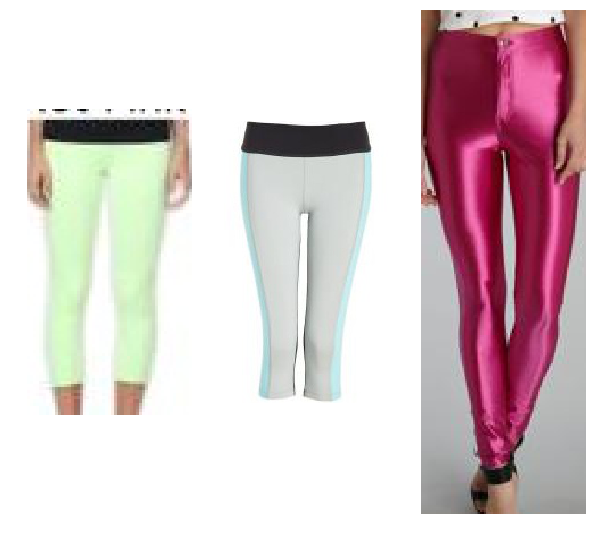

pos_dist: [ 1.37746] neg_dist: [ 1.44531322] diff: [ 0.06785321] alpha: 0.05
[False]
pos_dist: [ 1.18931937] neg_dist: [ 1.41982698] diff: [ 0.23050761] alpha: 0.05
[False]
pos_dist: [ 1.61409903] neg_dist: [ 1.36210752] diff: [-0.25199151] alpha: 0.05
[ True]


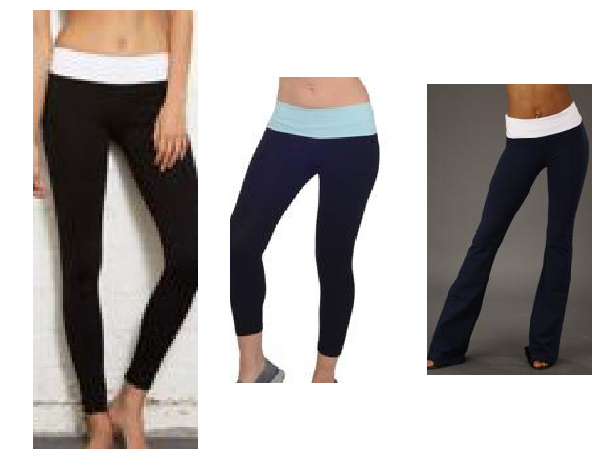

pos_dist: [ 1.31111085] neg_dist: [ 1.32249427] diff: [ 0.01138341] alpha: 0.05
[ True]


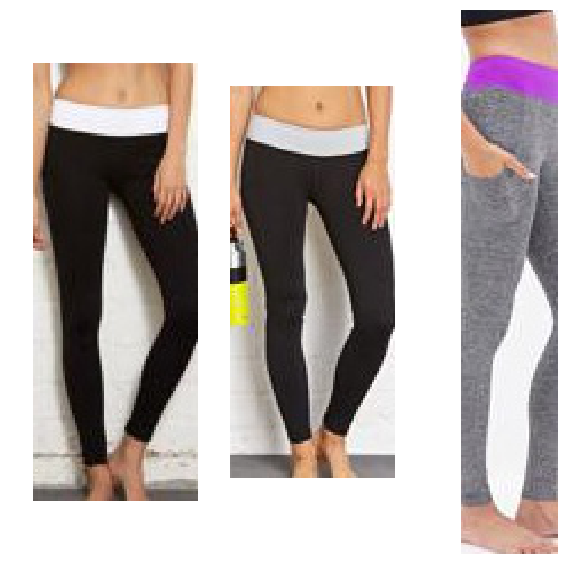

pos_dist: [ 1.41740036] neg_dist: [ 1.32991147] diff: [-0.08748889] alpha: 0.05
[ True]


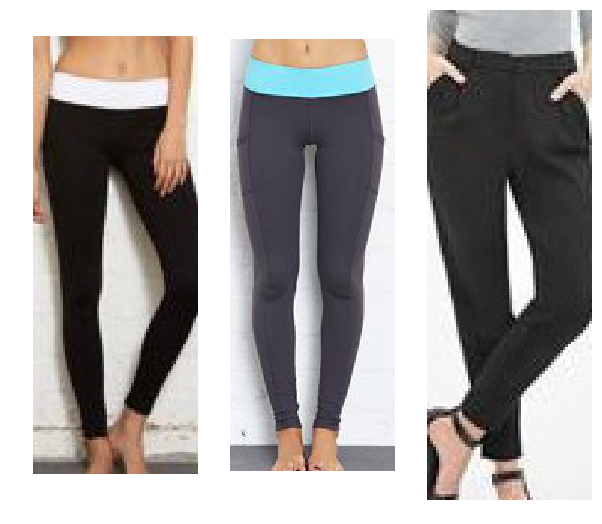

pos_dist: [ 1.49369657] neg_dist: [ 1.20469713] diff: [-0.28899944] alpha: 0.05
[ True]


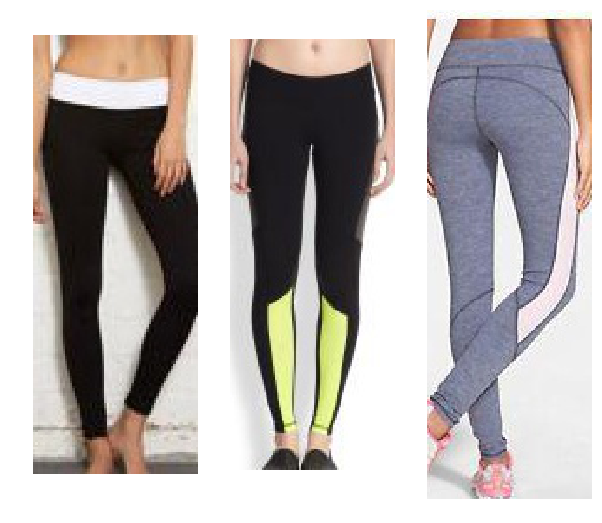

pos_dist: [ 1.39324594] neg_dist: [ 1.49681962] diff: [ 0.10357368] alpha: 0.05
[False]
pos_dist: [ 1.52577567] neg_dist: [ 1.51004684] diff: [-0.01572883] alpha: 0.05
[ True]


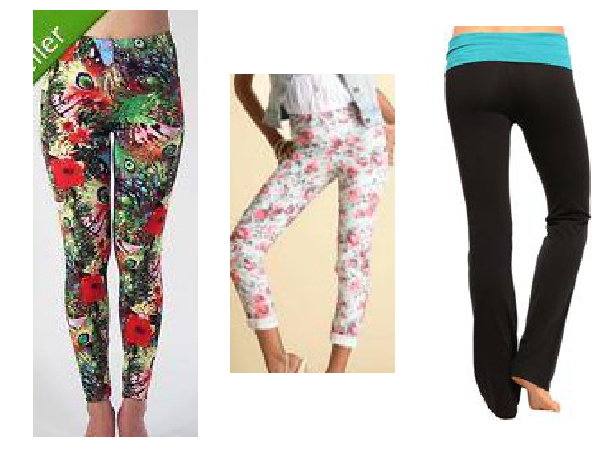

pos_dist: [ 1.36330378] neg_dist: [ 1.50704765] diff: [ 0.14374387] alpha: 0.05
[False]
pos_dist: [ 1.47343326] neg_dist: [ 1.60977244] diff: [ 0.13633919] alpha: 0.05
[False]
pos_dist: [ 1.35609221] neg_dist: [ 1.47715902] diff: [ 0.12106681] alpha: 0.05
[False]
pos_dist: [ 1.36965585] neg_dist: [ 1.51975513] diff: [ 0.15009928] alpha: 0.05
[False]
pos_dist: [ 1.48802245] neg_dist: [ 1.3309828] diff: [-0.15703964] alpha: 0.05
[ True]


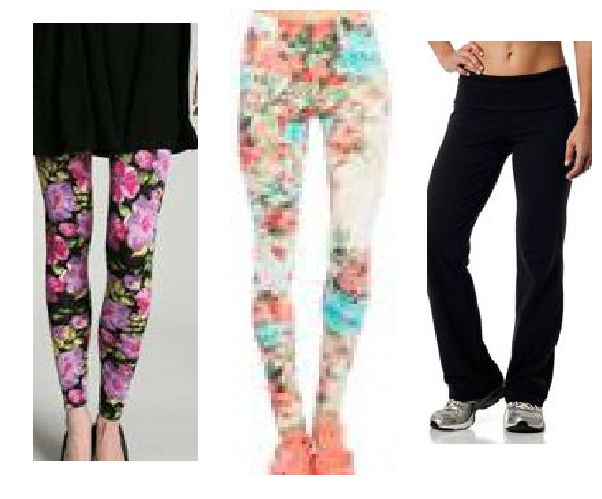

pos_dist: [ 1.40407181] neg_dist: [ 1.43819177] diff: [ 0.03411996] alpha: 0.05
[ True]


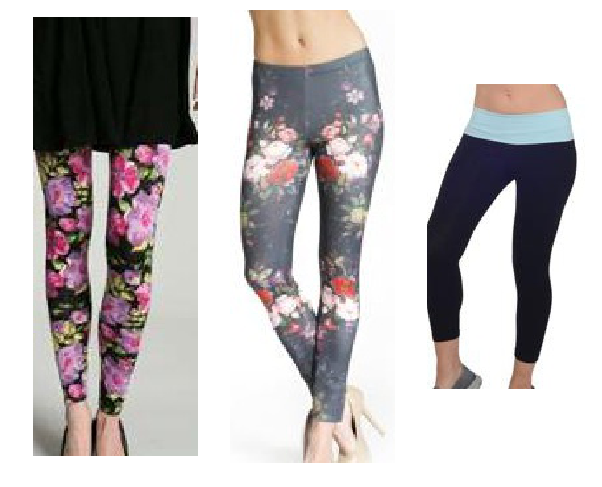

pos_dist: [ 1.43645287] neg_dist: [ 1.57477617] diff: [ 0.13832331] alpha: 0.05
[False]
pos_dist: [ 1.55204058] neg_dist: [ 1.54766369] diff: [-0.00437689] alpha: 0.05
[ True]


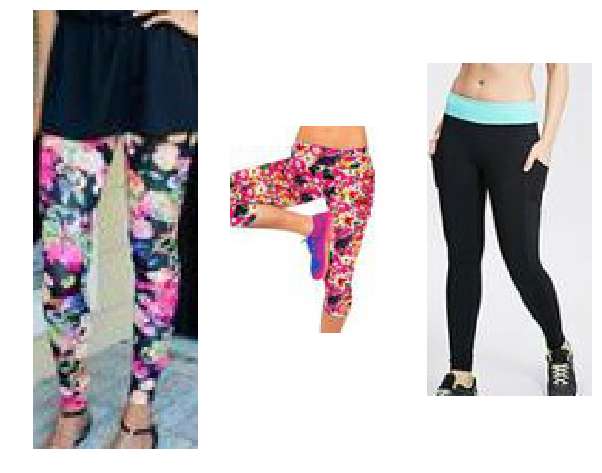

pos_dist: [ 1.51147366] neg_dist: [ 1.56794989] diff: [ 0.05647624] alpha: 0.05
[False]
pos_dist: [ 1.45249891] neg_dist: [ 1.52355111] diff: [ 0.07105219] alpha: 0.05
[False]
pos_dist: [ 1.39541721] neg_dist: [ 1.65407288] diff: [ 0.25865567] alpha: 0.05
[False]
pos_dist: [ 1.30904913] neg_dist: [ 1.49524593] diff: [ 0.1861968] alpha: 0.05
[False]
pos_dist: [ 1.4624418] neg_dist: [ 1.64452195] diff: [ 0.18208015] alpha: 0.05
[False]
pos_dist: [ 1.43266892] neg_dist: [ 1.4295671] diff: [-0.00310183] alpha: 0.05
[ True]


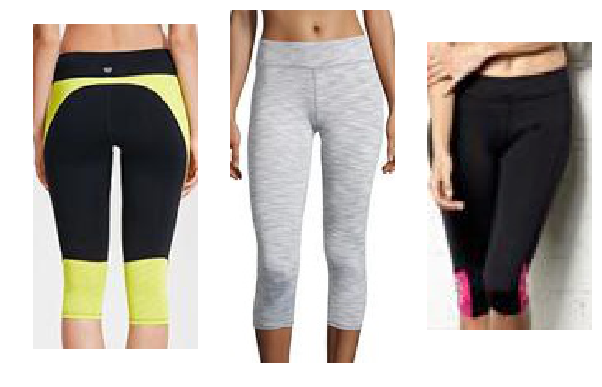

pos_dist: [ 1.41617155] neg_dist: [ 1.41088438] diff: [-0.00528717] alpha: 0.05
[ True]


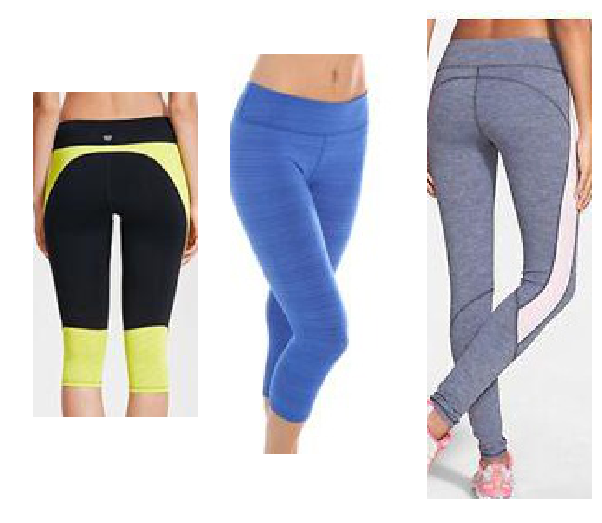

pos_dist: [ 1.45726287] neg_dist: [ 1.44387448] diff: [-0.0133884] alpha: 0.05
[ True]


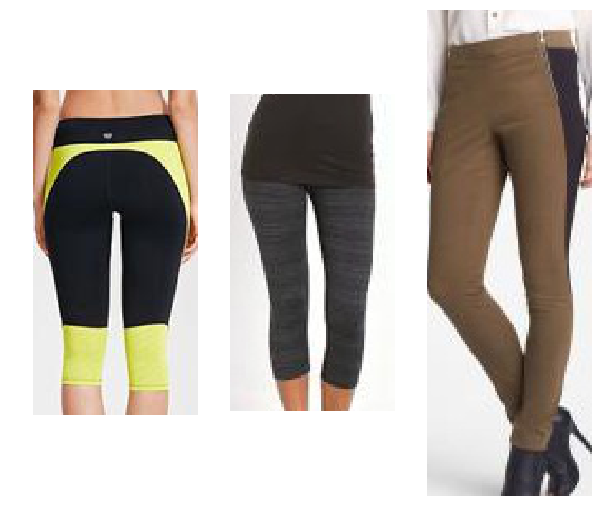

pos_dist: [ 1.42630458] neg_dist: [ 1.41929483] diff: [-0.00700974] alpha: 0.05
[ True]


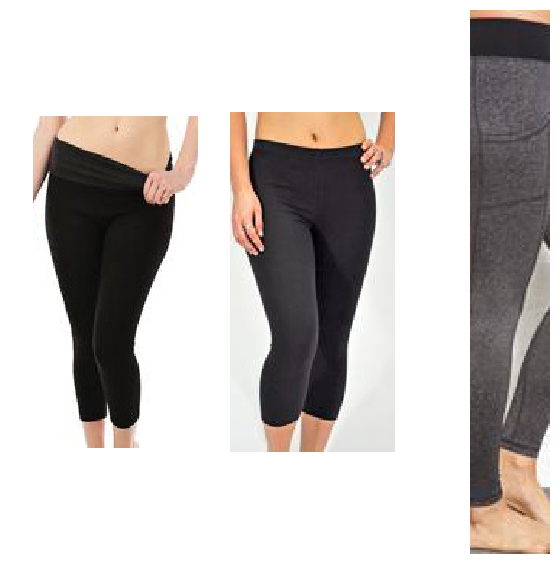

pos_dist: [ 1.35989833] neg_dist: [ 1.55802739] diff: [ 0.19812906] alpha: 0.05
[False]
pos_dist: [ 1.40752578] neg_dist: [ 1.47942686] diff: [ 0.07190108] alpha: 0.05
[False]
pos_dist: [ 1.3218739] neg_dist: [ 1.39282584] diff: [ 0.07095194] alpha: 0.05
[False]
pos_dist: [ 1.46097732] neg_dist: [ 1.42198133] diff: [-0.03899598] alpha: 0.05
[ True]


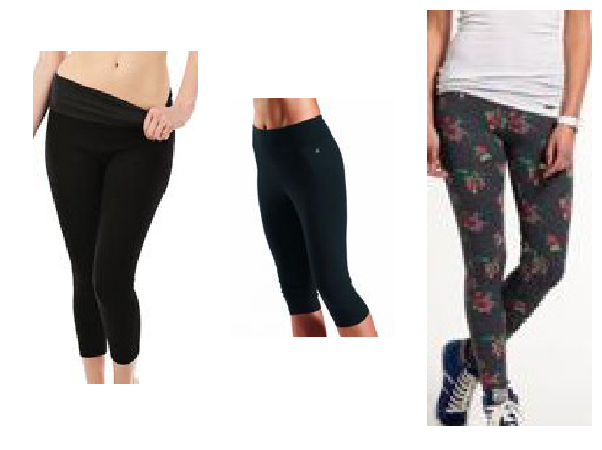

pos_dist: [ 1.4627111] neg_dist: [ 1.4507333] diff: [-0.01197779] alpha: 0.05
[ True]


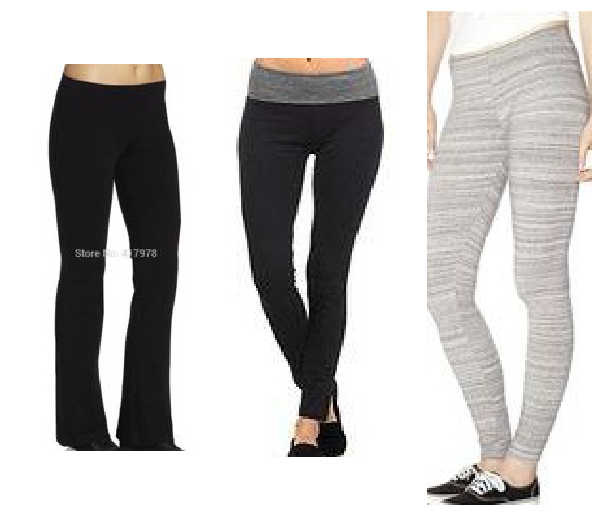

pos_dist: [ 1.40109229] neg_dist: [ 1.59911001] diff: [ 0.19801772] alpha: 0.05
[False]
pos_dist: [ 1.4631511] neg_dist: [ 1.3377614] diff: [-0.1253897] alpha: 0.05
[ True]


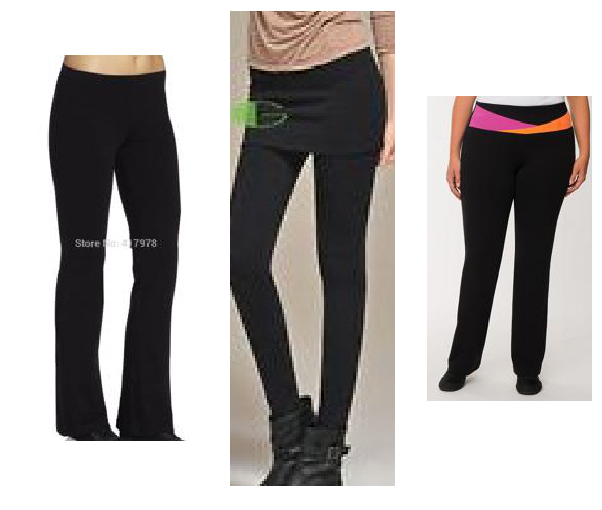

pos_dist: [ 1.46861756] neg_dist: [ 1.45496368] diff: [-0.01365387] alpha: 0.05
[ True]


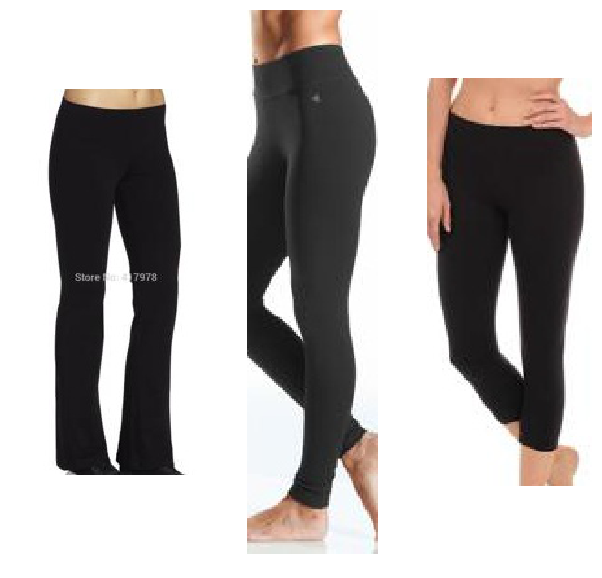

pos_dist: [ 1.39410222] neg_dist: [ 1.52197409] diff: [ 0.12787187] alpha: 0.05
[False]
pos_dist: [ 1.33288074] neg_dist: [ 1.47083557] diff: [ 0.13795483] alpha: 0.05
[False]
pos_dist: [ 1.49788439] neg_dist: [ 1.37701678] diff: [-0.12086761] alpha: 0.05
[ True]


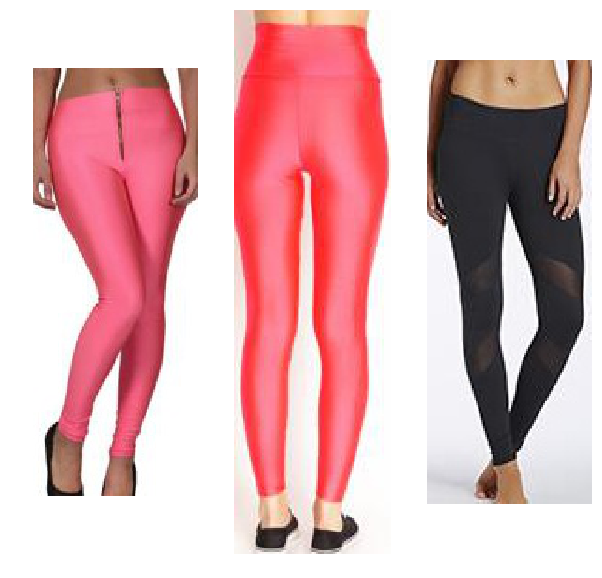

pos_dist: [ 1.50957298] neg_dist: [ 1.30163419] diff: [-0.20793879] alpha: 0.05
[ True]


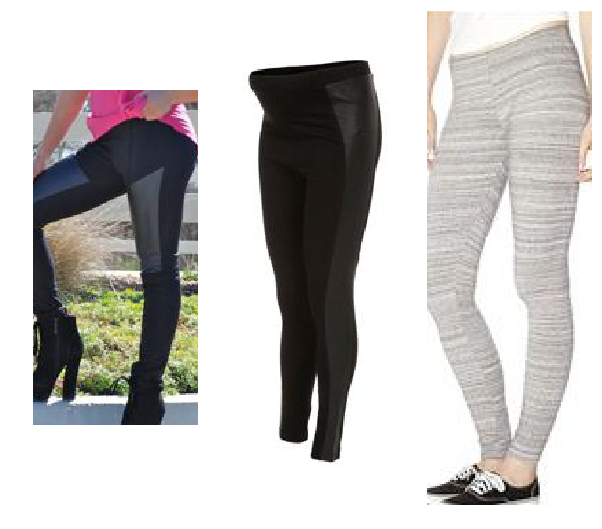

pos_dist: [ 1.54690349] neg_dist: [ 1.49065185] diff: [-0.05625165] alpha: 0.05
[ True]


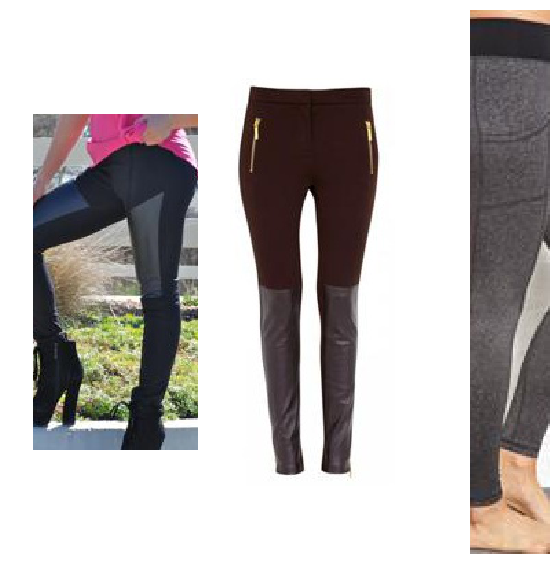

pos_dist: [ 1.37652373] neg_dist: [ 1.51458383] diff: [ 0.13806009] alpha: 0.05
[False]
pos_dist: [ 1.56686497] neg_dist: [ 1.47784328] diff: [-0.08902168] alpha: 0.05
[ True]


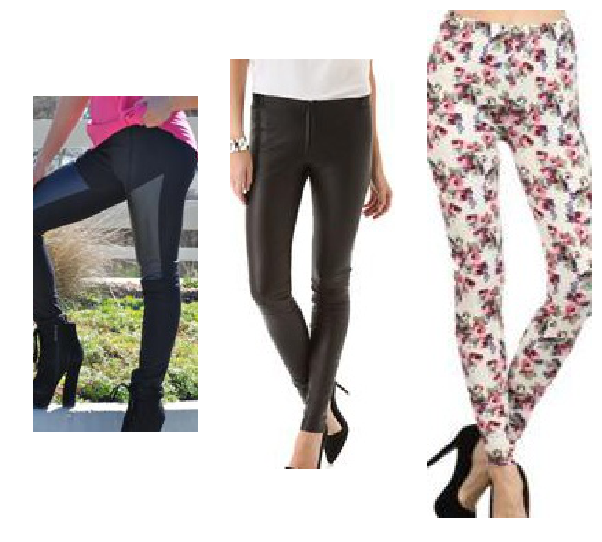

pos_dist: [ 1.5384016] neg_dist: [ 1.45983779] diff: [-0.07856381] alpha: 0.05
[ True]


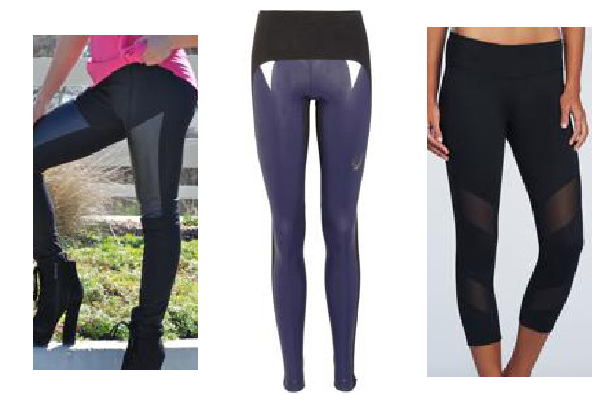

pos_dist: [ 1.26922452] neg_dist: [ 1.42148149] diff: [ 0.15225697] alpha: 0.05
[False]
pos_dist: [ 1.51155746] neg_dist: [ 1.29749966] diff: [-0.2140578] alpha: 0.05
[ True]


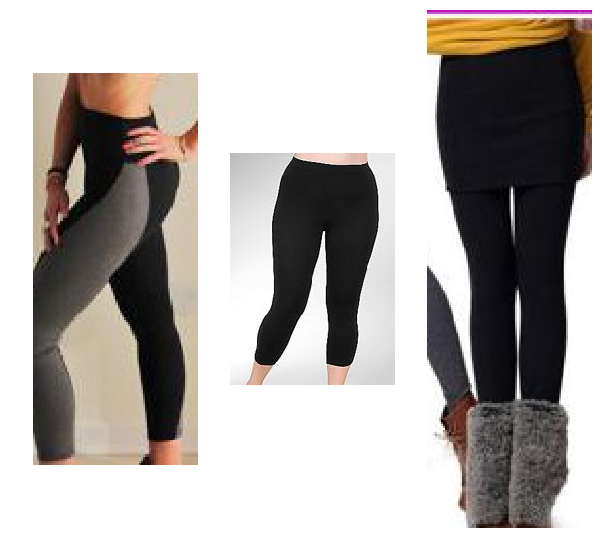

pos_dist: [ 1.36123395] neg_dist: [ 1.27471411] diff: [-0.08651984] alpha: 0.05
[ True]


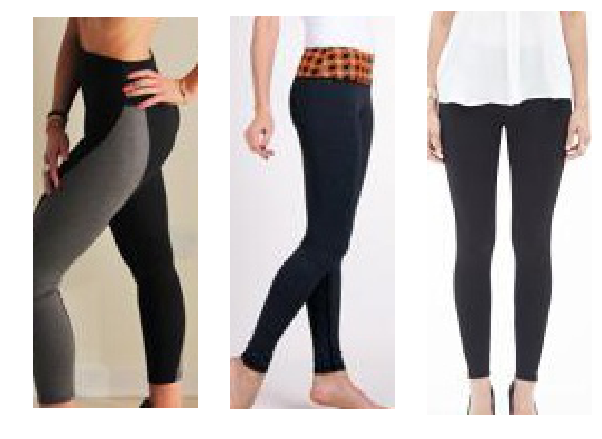

pos_dist: [ 1.39886963] neg_dist: [ 1.25958085] diff: [-0.13928878] alpha: 0.05
[ True]


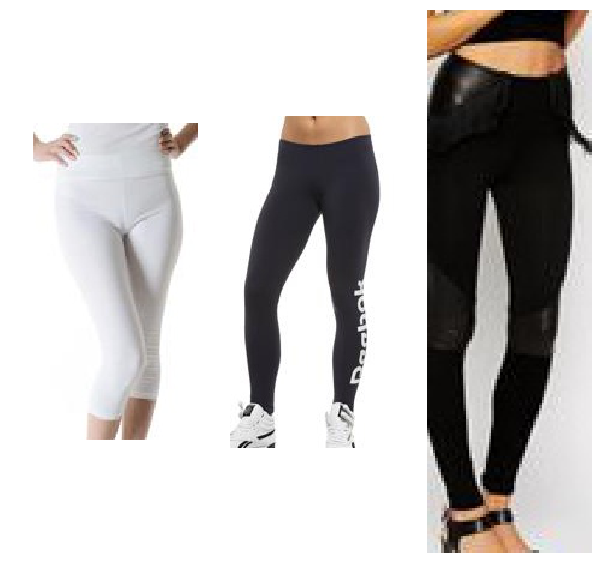

pos_dist: [ 1.52006531] neg_dist: [ 1.37445927] diff: [-0.14560604] alpha: 0.05
[ True]


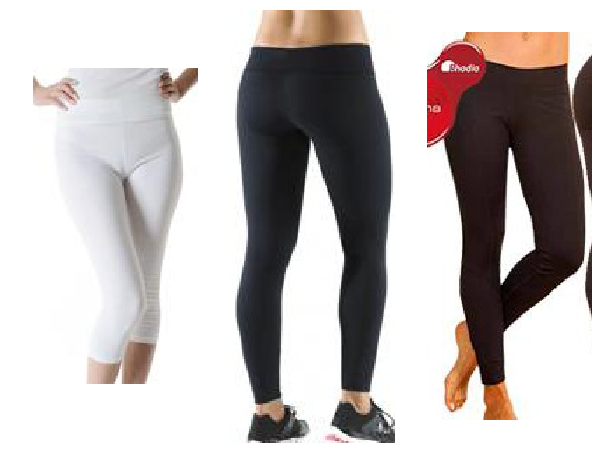

pos_dist: [ 1.38417339] neg_dist: [ 1.26502132] diff: [-0.11915207] alpha: 0.05
[ True]


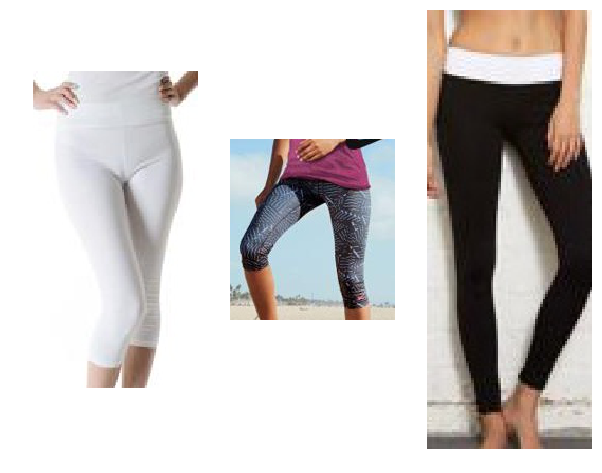

pos_dist: [ 1.46223474] neg_dist: [ 1.34649026] diff: [-0.11574447] alpha: 0.05
[ True]


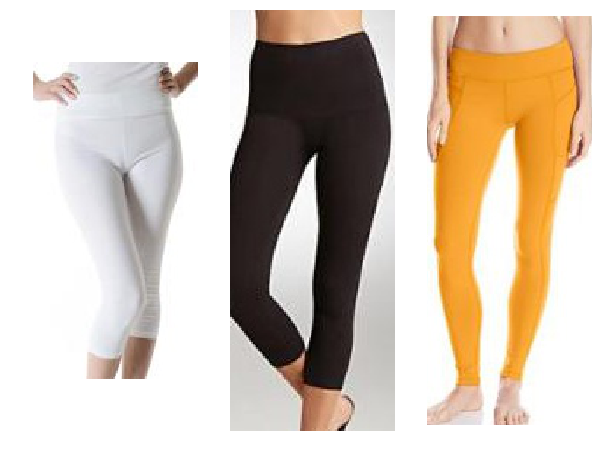

pos_dist: [ 1.34411454] neg_dist: [ 1.44823647] diff: [ 0.10412192] alpha: 0.05
[False]
pos_dist: [ 1.42147255] neg_dist: [ 1.44049442] diff: [ 0.01902187] alpha: 0.05
[ True]


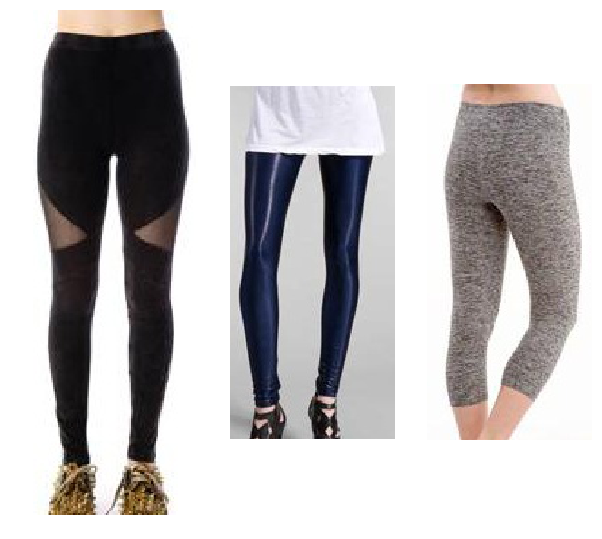

pos_dist: [ 1.25428081] neg_dist: [ 1.54926777] diff: [ 0.29498696] alpha: 0.05
[False]
pos_dist: [ 1.36009383] neg_dist: [ 1.46222591] diff: [ 0.10213208] alpha: 0.05
[False]
pos_dist: [ 1.37803936] neg_dist: [ 1.4977324] diff: [ 0.11969304] alpha: 0.05
[False]
pos_dist: [ 1.41654384] neg_dist: [ 1.58595443] diff: [ 0.16941059] alpha: 0.05
[False]
pos_dist: [ 1.43600261] neg_dist: [ 1.50398576] diff: [ 0.06798315] alpha: 0.05
[False]
pos_dist: [ 1.33611393] neg_dist: [ 1.34402776] diff: [ 0.00791383] alpha: 0.05
[ True]


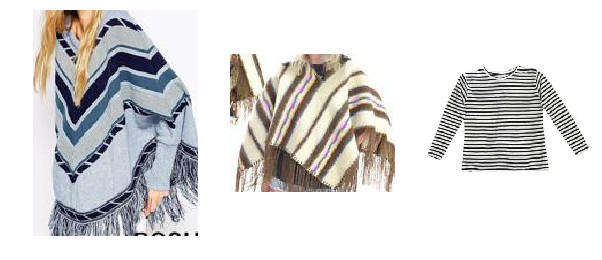

pos_dist: [ 1.22407079] neg_dist: [ 1.48333371] diff: [ 0.25926292] alpha: 0.05
[False]
pos_dist: [ 1.36246908] neg_dist: [ 1.53226256] diff: [ 0.16979349] alpha: 0.05
[False]
pos_dist: [ 1.28902864] neg_dist: [ 1.64264393] diff: [ 0.35361528] alpha: 0.05
[False]
pos_dist: [ 1.27573001] neg_dist: [ 1.56010044] diff: [ 0.28437042] alpha: 0.05
[False]
pos_dist: [ 1.42476726] neg_dist: [ 1.49519753] diff: [ 0.07043028] alpha: 0.05
[False]
pos_dist: [ 1.33856046] neg_dist: [ 1.52183795] diff: [ 0.18327749] alpha: 0.05
[False]
pos_dist: [ 1.47563493] neg_dist: [ 1.50478137] diff: [ 0.02914643] alpha: 0.05
[ True]


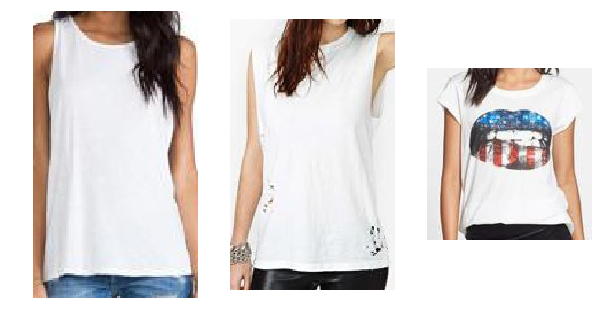

pos_dist: [ 1.38359904] neg_dist: [ 1.56153345] diff: [ 0.17793441] alpha: 0.05
[False]
pos_dist: [ 1.28039742] neg_dist: [ 1.65164673] diff: [ 0.37124932] alpha: 0.05
[False]
pos_dist: [ 1.23772526] neg_dist: [ 1.50175667] diff: [ 0.26403141] alpha: 0.05
[False]
pos_dist: [ 1.32685828] neg_dist: [ 1.41092598] diff: [ 0.0840677] alpha: 0.05
[False]
pos_dist: [ 1.19392014] neg_dist: [ 1.55725646] diff: [ 0.36333632] alpha: 0.05
[False]
pos_dist: [ 1.35673201] neg_dist: [ 1.51238346] diff: [ 0.15565145] alpha: 0.05
[False]
pos_dist: [ 1.3776139] neg_dist: [ 1.52021241] diff: [ 0.14259851] alpha: 0.05
[False]
pos_dist: [ 1.24499488] neg_dist: [ 1.44528806] diff: [ 0.20029318] alpha: 0.05
[False]
pos_dist: [ 1.39498949] neg_dist: [ 1.36879969] diff: [-0.0261898] alpha: 0.05
[ True]


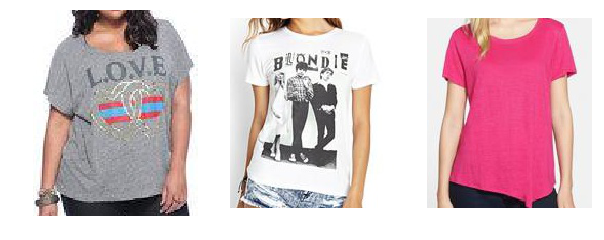

pos_dist: [ 1.56198132] neg_dist: [ 1.4630059] diff: [-0.09897542] alpha: 0.05
[ True]


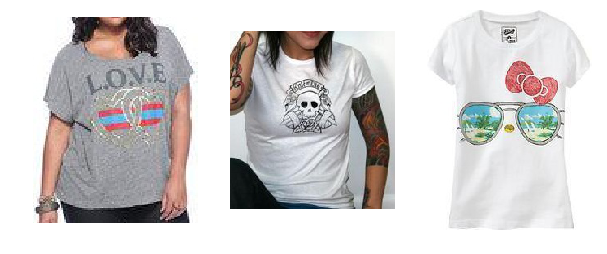

pos_dist: [ 1.39855862] neg_dist: [ 1.4895649] diff: [ 0.09100628] alpha: 0.05
[False]
pos_dist: [ 1.25308132] neg_dist: [ 1.41005266] diff: [ 0.15697134] alpha: 0.05
[False]
pos_dist: [ 1.28973246] neg_dist: [ 1.42898297] diff: [ 0.13925052] alpha: 0.05
[False]
pos_dist: [ 1.40208387] neg_dist: [ 1.41565824] diff: [ 0.01357436] alpha: 0.05
[ True]


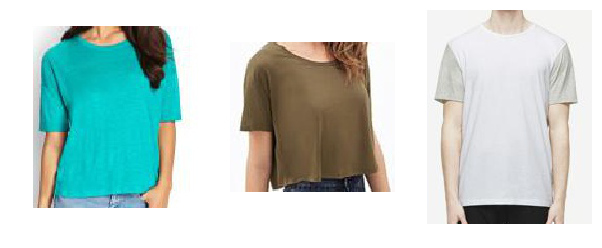

pos_dist: [ 1.41241944] neg_dist: [ 1.51279604] diff: [ 0.10037661] alpha: 0.05
[False]
pos_dist: [ 1.46751308] neg_dist: [ 1.53373098] diff: [ 0.0662179] alpha: 0.05
[False]
pos_dist: [ 1.33130956] neg_dist: [ 1.34487915] diff: [ 0.01356959] alpha: 0.05
[ True]


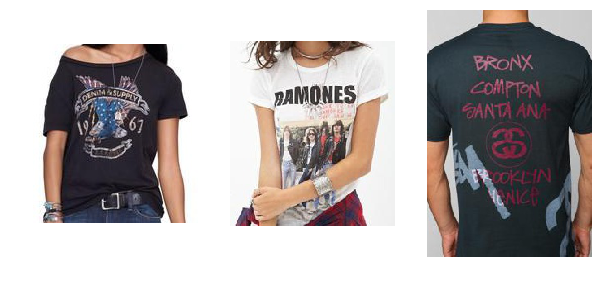

pos_dist: [ 1.50315416] neg_dist: [ 1.46369565] diff: [-0.03945851] alpha: 0.05
[ True]


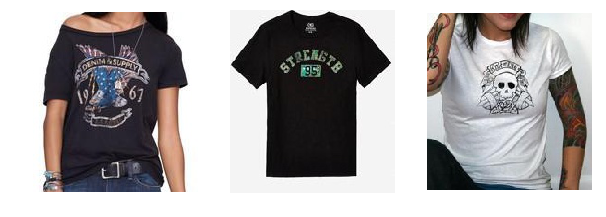

pos_dist: [ 1.50589895] neg_dist: [ 1.60457003] diff: [ 0.09867108] alpha: 0.05
[False]
pos_dist: [ 1.34949422] neg_dist: [ 1.33747101] diff: [-0.01202321] alpha: 0.05
[ True]


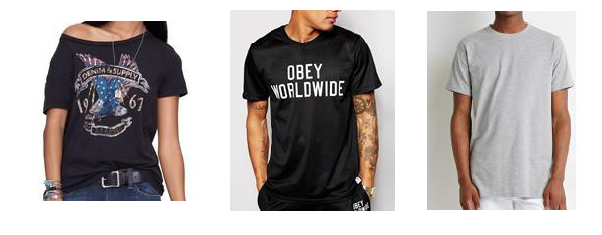

pos_dist: [ 1.30287457] neg_dist: [ 1.55755472] diff: [ 0.25468016] alpha: 0.05
[False]
pos_dist: [ 1.32089472] neg_dist: [ 1.21628737] diff: [-0.10460734] alpha: 0.05
[ True]


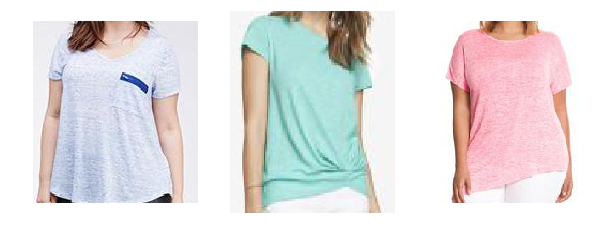

pos_dist: [ 1.37443578] neg_dist: [ 1.2873621] diff: [-0.08707368] alpha: 0.05
[ True]


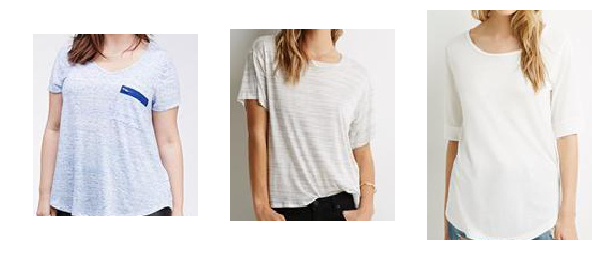

pos_dist: [ 1.31267142] neg_dist: [ 1.53524852] diff: [ 0.2225771] alpha: 0.05
[False]
pos_dist: [ 1.26835132] neg_dist: [ 1.40075326] diff: [ 0.13240194] alpha: 0.05
[False]
pos_dist: [ 1.34805942] neg_dist: [ 1.53754973] diff: [ 0.18949032] alpha: 0.05
[False]
pos_dist: [ 1.65277326] neg_dist: [ 1.50951302] diff: [-0.14326024] alpha: 0.05
[ True]


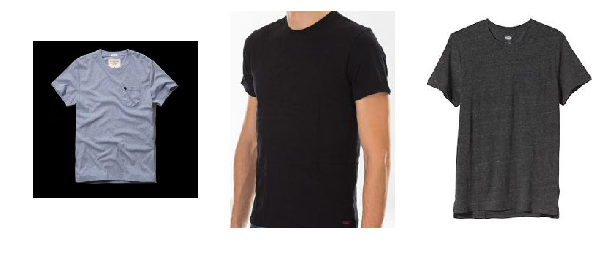

pos_dist: [ 1.37630963] neg_dist: [ 1.50367951] diff: [ 0.12736988] alpha: 0.05
[False]
pos_dist: [ 1.55182433] neg_dist: [ 1.54741633] diff: [-0.004408] alpha: 0.05
[ True]


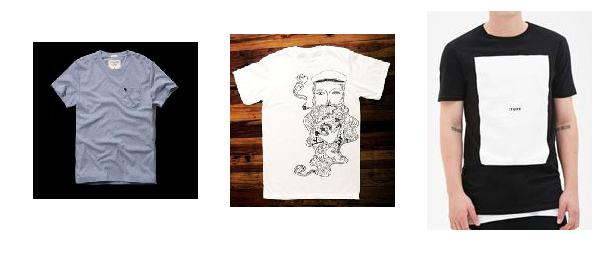

pos_dist: [ 1.45002699] neg_dist: [ 1.49633813] diff: [ 0.04631114] alpha: 0.05
[ True]


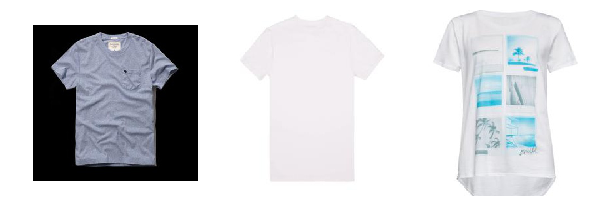

pos_dist: [ 1.27471828] neg_dist: [ 1.43601155] diff: [ 0.16129327] alpha: 0.05
[False]
pos_dist: [ 1.38560915] neg_dist: [ 1.4863236] diff: [ 0.10071445] alpha: 0.05
[False]
pos_dist: [ 1.31363678] neg_dist: [ 1.7839185] diff: [ 0.47028172] alpha: 0.05
[False]
pos_dist: [ 1.29715466] neg_dist: [ 1.31384826] diff: [ 0.01669359] alpha: 0.05
[ True]


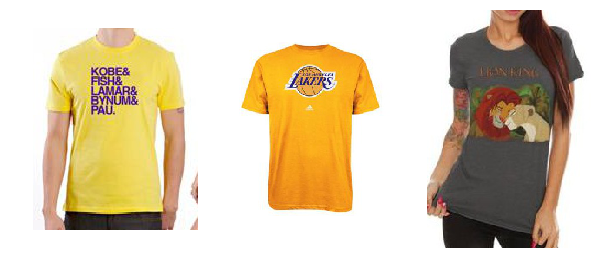

pos_dist: [ 1.49414945] neg_dist: [ 1.35303473] diff: [-0.14111471] alpha: 0.05
[ True]


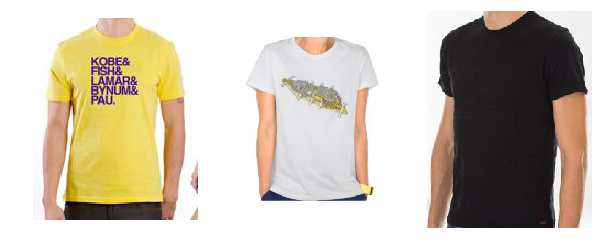

pos_dist: [ 1.37845874] neg_dist: [ 1.32289124] diff: [-0.0555675] alpha: 0.05
[ True]


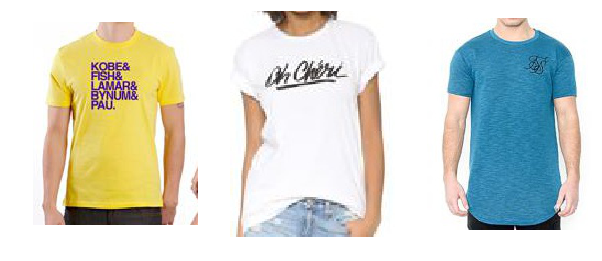

pos_dist: [ 1.21978533] neg_dist: [ 1.75667644] diff: [ 0.5368911] alpha: 0.05
[False]
pos_dist: [ 1.3742528] neg_dist: [ 1.22075891] diff: [-0.15349388] alpha: 0.05
[ True]


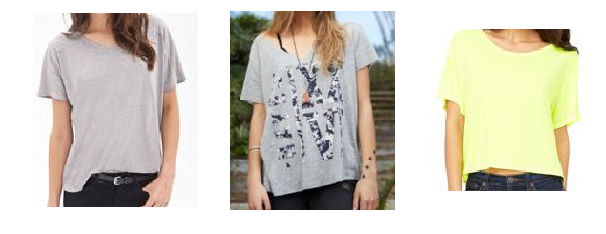

pos_dist: [ 1.35249805] neg_dist: [ 1.22044206] diff: [-0.132056] alpha: 0.05
[ True]


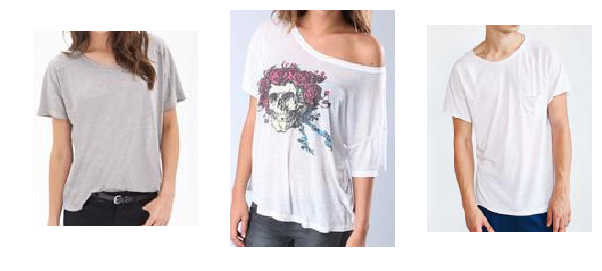

pos_dist: [ 1.46406281] neg_dist: [ 1.25461996] diff: [-0.20944285] alpha: 0.05
[ True]


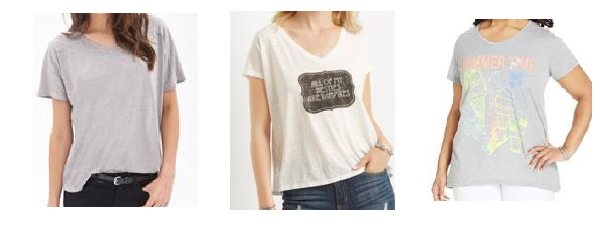

pos_dist: [ 1.37140155] neg_dist: [ 1.51235259] diff: [ 0.14095104] alpha: 0.05
[False]
pos_dist: [ 1.44787621] neg_dist: [ 1.42479134] diff: [-0.02308488] alpha: 0.05
[ True]


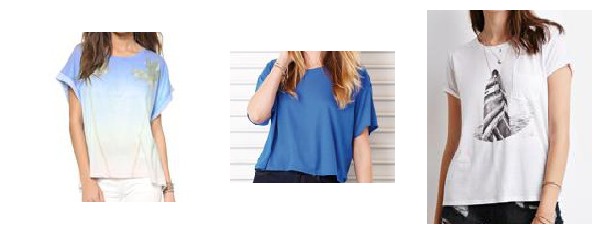

pos_dist: [ 1.34715366] neg_dist: [ 1.4812597] diff: [ 0.13410604] alpha: 0.05
[False]
pos_dist: [ 1.42128134] neg_dist: [ 1.43313384] diff: [ 0.0118525] alpha: 0.05
[ True]


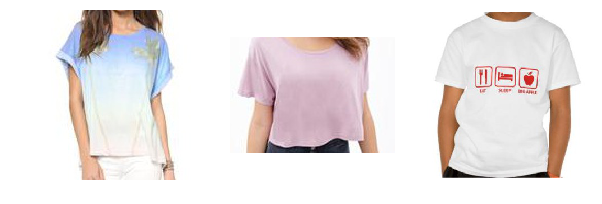

pos_dist: [ 1.24107552] neg_dist: [ 1.46248651] diff: [ 0.22141099] alpha: 0.05
[False]
pos_dist: [ 1.46699142] neg_dist: [ 1.38718116] diff: [-0.07981026] alpha: 0.05
[ True]


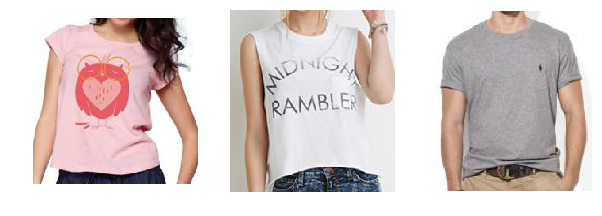

pos_dist: [ 1.32552862] neg_dist: [ 1.44168234] diff: [ 0.11615372] alpha: 0.05
[False]
pos_dist: [ 1.30974936] neg_dist: [ 1.64930415] diff: [ 0.33955479] alpha: 0.05
[False]
pos_dist: [ 1.31273818] neg_dist: [ 1.52523601] diff: [ 0.21249783] alpha: 0.05
[False]
pos_dist: [ 1.48620832] neg_dist: [ 1.56040585] diff: [ 0.07419753] alpha: 0.05
[False]
pos_dist: [ 1.23391438] neg_dist: [ 1.54534864] diff: [ 0.31143427] alpha: 0.05
[False]
pos_dist: [ 1.38628125] neg_dist: [ 1.60783005] diff: [ 0.2215488] alpha: 0.05
[False]
pos_dist: [ 1.20993948] neg_dist: [ 1.59359491] diff: [ 0.38365543] alpha: 0.05
[False]
pos_dist: [ 1.40620065] neg_dist: [ 1.65415072] diff: [ 0.24795008] alpha: 0.05
[False]
pos_dist: [ 1.35598636] neg_dist: [ 1.51773608] diff: [ 0.16174972] alpha: 0.05
[False]
pos_dist: [ 1.20173979] neg_dist: [ 1.69442248] diff: [ 0.4926827] alpha: 0.05
[False]
pos_dist: [ 1.31605864] neg_dist: [ 1.58408773] diff: [ 0.26802909] alpha: 0.05
[False]
pos_dist: [ 1.36813593] neg_dist: 

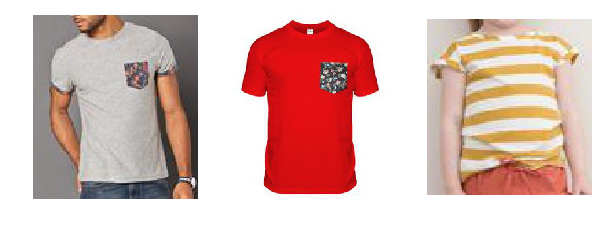

pos_dist: [ 1.43621302] neg_dist: [ 1.60890436] diff: [ 0.17269135] alpha: 0.05
[False]
pos_dist: [ 1.20622277] neg_dist: [ 1.63963223] diff: [ 0.43340945] alpha: 0.05
[False]
pos_dist: [ 1.47299719] neg_dist: [ 1.41804767] diff: [-0.05494952] alpha: 0.05
[ True]


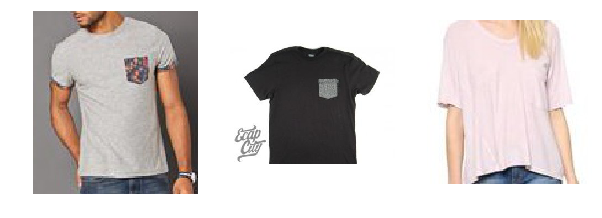

pos_dist: [ 1.41630518] neg_dist: [ 1.30589271] diff: [-0.11041248] alpha: 0.05
[ True]


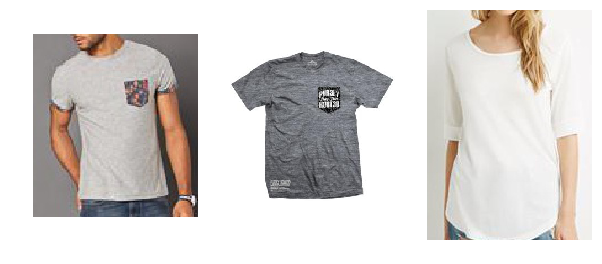

pos_dist: [ 1.51309824] neg_dist: [ 1.55766523] diff: [ 0.04456699] alpha: 0.05
[ True]


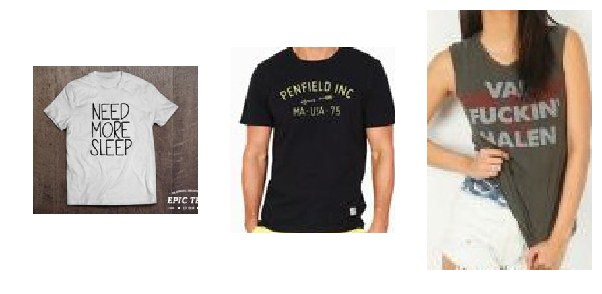

pos_dist: [ 1.44181514] neg_dist: [ 1.54803514] diff: [ 0.10622001] alpha: 0.05
[False]
pos_dist: [ 1.43122888] neg_dist: [ 1.53710032] diff: [ 0.10587144] alpha: 0.05
[False]
pos_dist: [ 1.59525871] neg_dist: [ 1.59695542] diff: [ 0.00169671] alpha: 0.05
[ True]


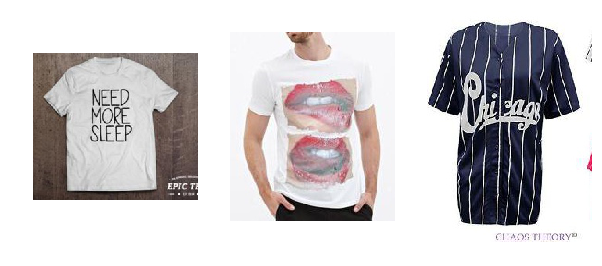

pos_dist: [ 1.50607729] neg_dist: [ 1.4245137] diff: [-0.08156359] alpha: 0.05
[ True]


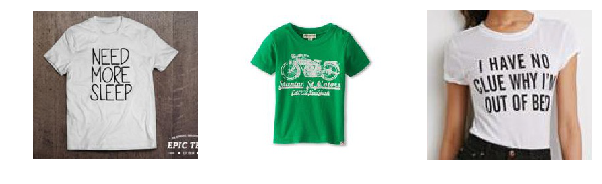

pos_dist: [ 1.40282416] neg_dist: [ 1.5574398] diff: [ 0.15461564] alpha: 0.05
[False]
pos_dist: [ 1.34886575] neg_dist: [ 1.34251547] diff: [-0.00635028] alpha: 0.05
[ True]


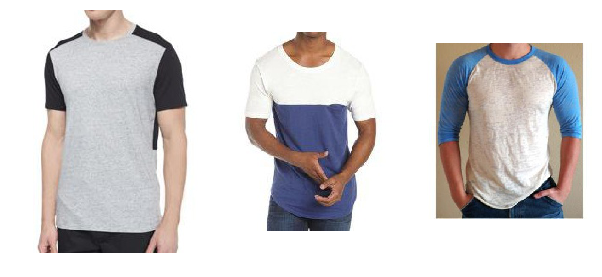

pos_dist: [ 1.24812269] neg_dist: [ 1.55874562] diff: [ 0.31062293] alpha: 0.05
[False]
pos_dist: [ 1.311692] neg_dist: [ 1.37055981] diff: [ 0.05886781] alpha: 0.05
[False]
pos_dist: [ 1.23177218] neg_dist: [ 1.52883768] diff: [ 0.2970655] alpha: 0.05
[False]
pos_dist: [ 1.44018245] neg_dist: [ 1.35885739] diff: [-0.08132505] alpha: 0.05
[ True]


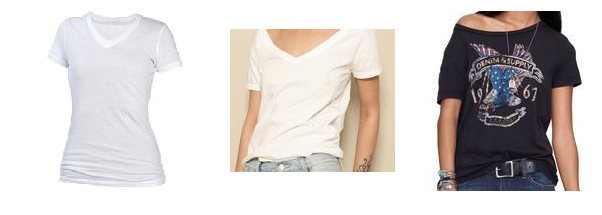

pos_dist: [ 1.4006027] neg_dist: [ 1.66100717] diff: [ 0.26040447] alpha: 0.05
[False]
pos_dist: [ 1.53666651] neg_dist: [ 1.44121957] diff: [-0.09544694] alpha: 0.05
[ True]


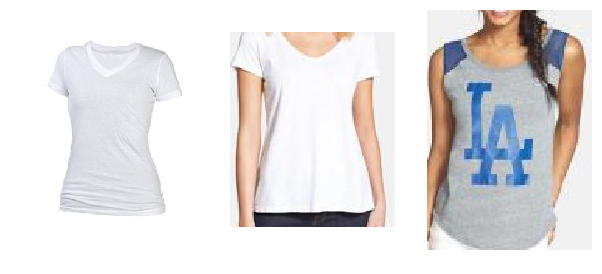

pos_dist: [ 1.3609035] neg_dist: [ 1.4890964] diff: [ 0.1281929] alpha: 0.05
[False]
pos_dist: [ 1.42879868] neg_dist: [ 1.32236743] diff: [-0.10643125] alpha: 0.05
[ True]


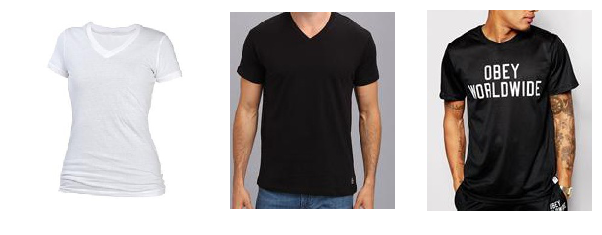

pos_dist: [ 1.28080034] neg_dist: [ 1.42532206] diff: [ 0.14452171] alpha: 0.05
[False]
pos_dist: [ 1.29454136] neg_dist: [ 1.45433033] diff: [ 0.15978897] alpha: 0.05
[False]
pos_dist: [ 1.38146567] neg_dist: [ 1.2479887] diff: [-0.13347697] alpha: 0.05
[ True]


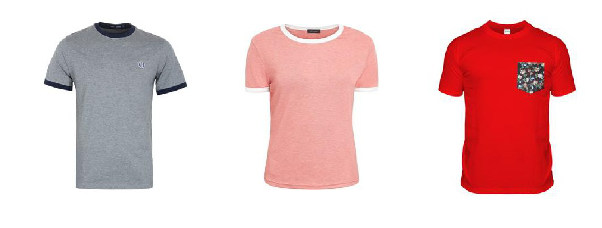

pos_dist: [ 1.46930528] neg_dist: [ 1.50793839] diff: [ 0.03863311] alpha: 0.05
[ True]


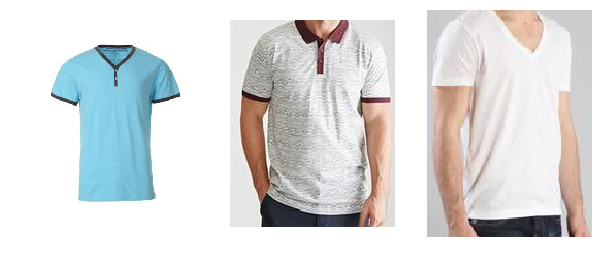

pos_dist: [ 1.34612465] neg_dist: [ 1.69513392] diff: [ 0.34900928] alpha: 0.05
[False]
pos_dist: [ 1.37810385] neg_dist: [ 1.33360422] diff: [-0.04449964] alpha: 0.05
[ True]


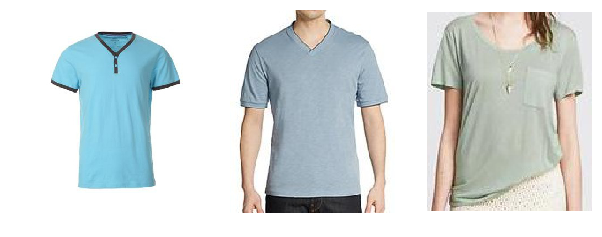

pos_dist: [ 1.40385246] neg_dist: [ 1.36037493] diff: [-0.04347754] alpha: 0.05
[ True]


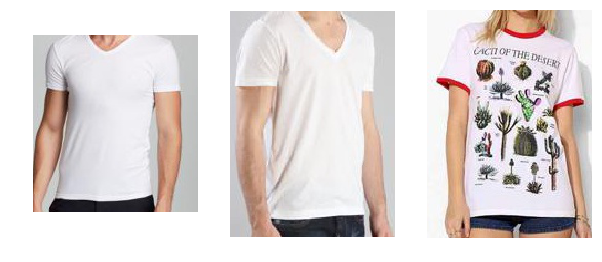

pos_dist: [ 1.35330772] neg_dist: [ 1.53234494] diff: [ 0.17903721] alpha: 0.05
[False]
pos_dist: [ 1.36356437] neg_dist: [ 1.59865046] diff: [ 0.23508608] alpha: 0.05
[False]
pos_dist: [ 1.26234722] neg_dist: [ 1.53344548] diff: [ 0.27109826] alpha: 0.05
[False]
pos_dist: [ 1.25065279] neg_dist: [ 1.47715974] diff: [ 0.22650695] alpha: 0.05
[False]
pos_dist: [ 1.36107826] neg_dist: [ 1.32538223] diff: [-0.03569603] alpha: 0.05
[ True]


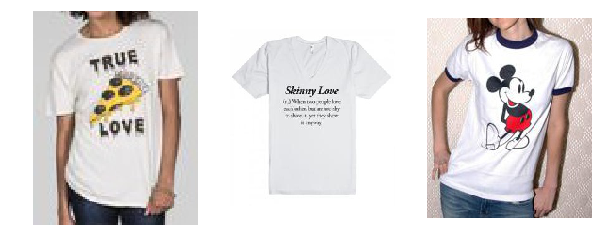

pos_dist: [ 1.39886487] neg_dist: [ 1.4229064] diff: [ 0.02404153] alpha: 0.05
[ True]


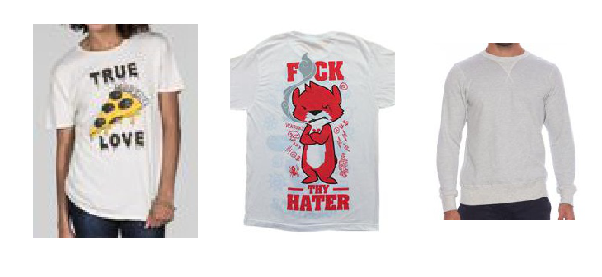

pos_dist: [ 1.45614767] neg_dist: [ 1.4753232] diff: [ 0.01917553] alpha: 0.05
[ True]


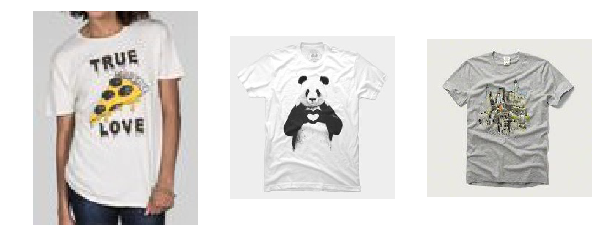

pos_dist: [ 1.43117404] neg_dist: [ 1.46478772] diff: [ 0.03361368] alpha: 0.05
[ True]


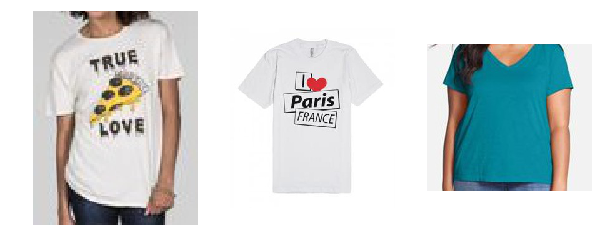

pos_dist: [ 1.33325577] neg_dist: [ 1.3457799] diff: [ 0.01252413] alpha: 0.05
[ True]


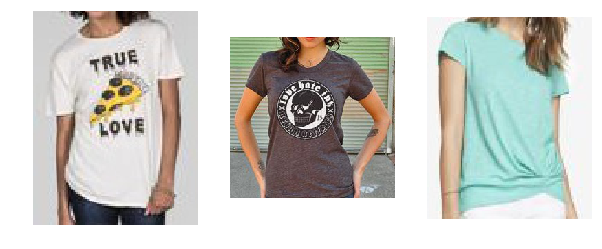

pos_dist: [ 1.24126792] neg_dist: [ 1.41092968] diff: [ 0.16966176] alpha: 0.05
[False]
pos_dist: [ 1.09190869] neg_dist: [ 1.80193102] diff: [ 0.71002233] alpha: 0.05
[False]
pos_dist: [ 1.31092501] neg_dist: [ 1.53409195] diff: [ 0.22316694] alpha: 0.05
[False]
pos_dist: [ 1.38919115] neg_dist: [ 1.52415085] diff: [ 0.1349597] alpha: 0.05
[False]
pos_dist: [ 1.38667631] neg_dist: [ 1.493168] diff: [ 0.10649168] alpha: 0.05
[False]
pos_dist: [ 1.50942087] neg_dist: [ 1.52003312] diff: [ 0.01061225] alpha: 0.05
[ True]


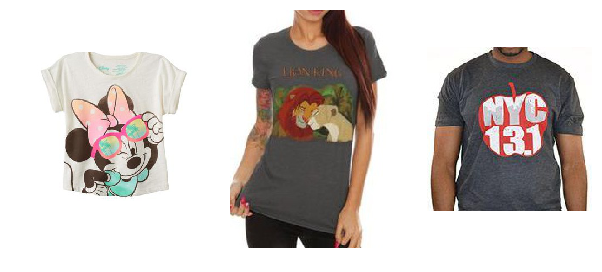

pos_dist: [ 1.3042382] neg_dist: [ 1.39516187] diff: [ 0.09092367] alpha: 0.05
[False]
pos_dist: [ 1.33907437] neg_dist: [ 1.32408011] diff: [-0.01499426] alpha: 0.05
[ True]


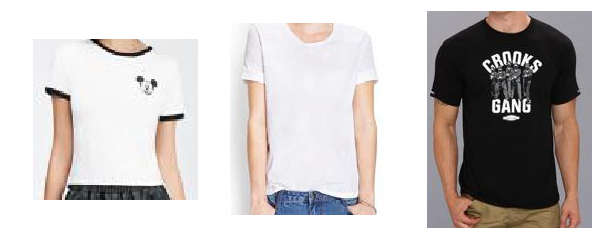

pos_dist: [ 1.28270793] neg_dist: [ 1.33001781] diff: [ 0.04730988] alpha: 0.05
[ True]


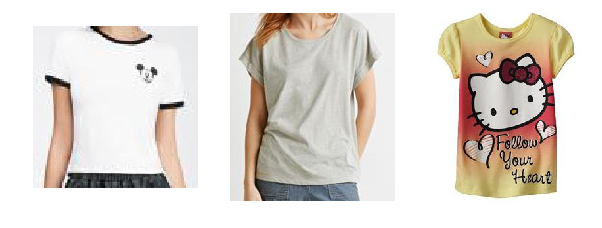

pos_dist: [ 1.35981154] neg_dist: [ 1.34267628] diff: [-0.01713526] alpha: 0.05
[ True]


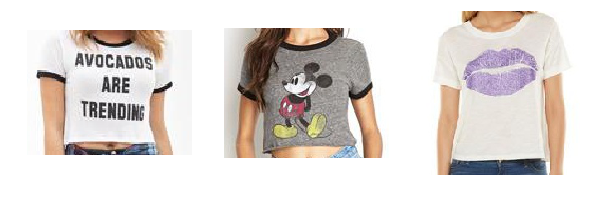

pos_dist: [ 1.38005042] neg_dist: [ 1.35365295] diff: [-0.02639747] alpha: 0.05
[ True]


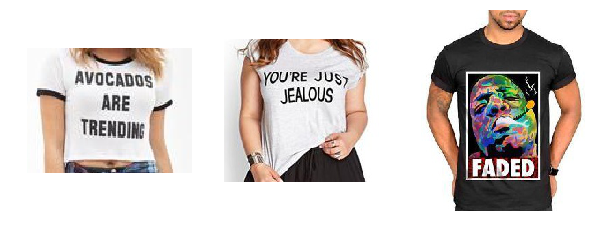

pos_dist: [ 1.27992904] neg_dist: [ 1.45149183] diff: [ 0.17156279] alpha: 0.05
[False]
pos_dist: [ 1.50405645] neg_dist: [ 1.43648696] diff: [-0.06756949] alpha: 0.05
[ True]


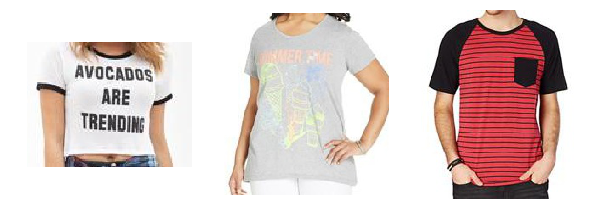

pos_dist: [ 1.33216619] neg_dist: [ 1.50233245] diff: [ 0.17016625] alpha: 0.05
[False]
pos_dist: [ 1.39332974] neg_dist: [ 1.4246459] diff: [ 0.03131616] alpha: 0.05
[ True]


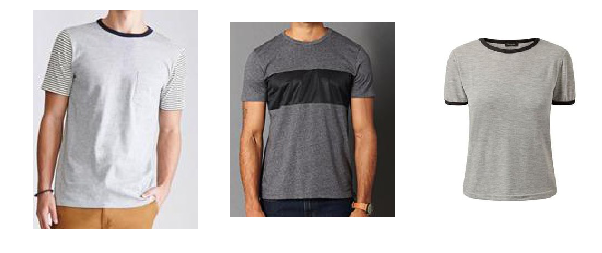

pos_dist: [ 0.87606668] neg_dist: [ 1.52648365] diff: [ 0.65041697] alpha: 0.05
[False]
pos_dist: [ 1.30081129] neg_dist: [ 1.43766999] diff: [ 0.1368587] alpha: 0.05
[False]
pos_dist: [ 1.39098024] neg_dist: [ 1.29969633] diff: [-0.09128392] alpha: 0.05
[ True]


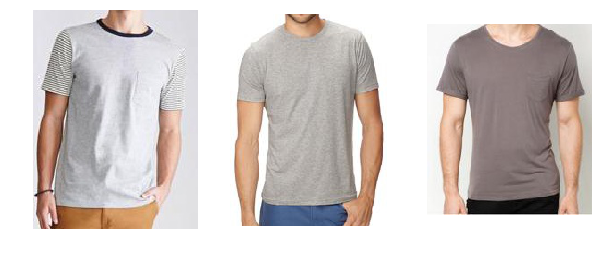

pos_dist: [ 1.3313694] neg_dist: [ 1.33615136] diff: [ 0.00478196] alpha: 0.05
[ True]


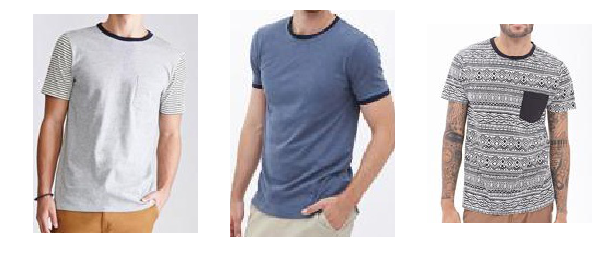

pos_dist: [ 1.51544082] neg_dist: [ 1.42294979] diff: [-0.09249103] alpha: 0.05
[ True]


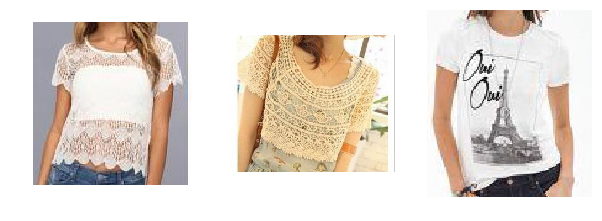

pos_dist: [ 1.25938249] neg_dist: [ 1.47718084] diff: [ 0.21779835] alpha: 0.05
[False]
pos_dist: [ 1.29160166] neg_dist: [ 1.60312915] diff: [ 0.31152749] alpha: 0.05
[False]
pos_dist: [ 1.38302517] neg_dist: [ 1.38663399] diff: [ 0.00360882] alpha: 0.05
[ True]


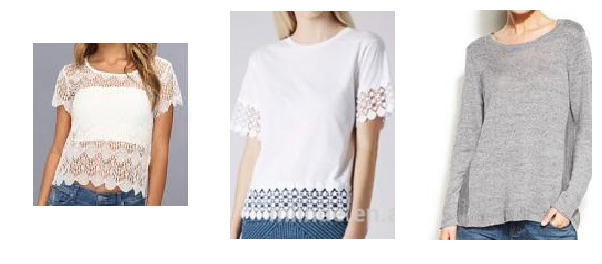

pos_dist: [ 1.30842781] neg_dist: [ 1.5035311] diff: [ 0.19510329] alpha: 0.05
[False]
pos_dist: [ 1.23255408] neg_dist: [ 1.26725852] diff: [ 0.03470445] alpha: 0.05
[ True]


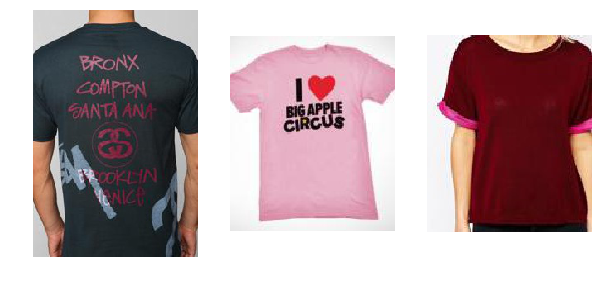

pos_dist: [ 1.15586019] neg_dist: [ 1.41830003] diff: [ 0.26243985] alpha: 0.05
[False]
pos_dist: [ 1.45797193] neg_dist: [ 1.4960866] diff: [ 0.03811467] alpha: 0.05
[ True]


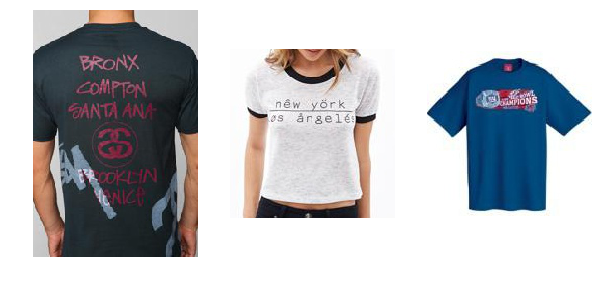

pos_dist: [ 1.34480357] neg_dist: [ 1.41610003] diff: [ 0.07129645] alpha: 0.05
[False]
pos_dist: [ 1.28118026] neg_dist: [ 1.68612003] diff: [ 0.40493977] alpha: 0.05
[False]
pos_dist: [ 1.30040121] neg_dist: [ 1.5988965] diff: [ 0.29849529] alpha: 0.05
[False]
pos_dist: [ 1.54907632] neg_dist: [ 1.38063526] diff: [-0.16844106] alpha: 0.05
[ True]


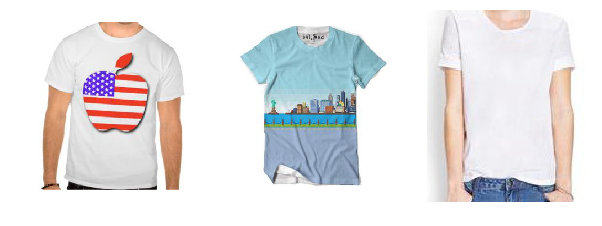

pos_dist: [ 1.34555387] neg_dist: [ 1.51686251] diff: [ 0.17130864] alpha: 0.05
[False]
pos_dist: [ 1.19992661] neg_dist: [ 1.55511522] diff: [ 0.35518861] alpha: 0.05
[False]
pos_dist: [ 1.46611989] neg_dist: [ 1.37441015] diff: [-0.09170973] alpha: 0.05
[ True]


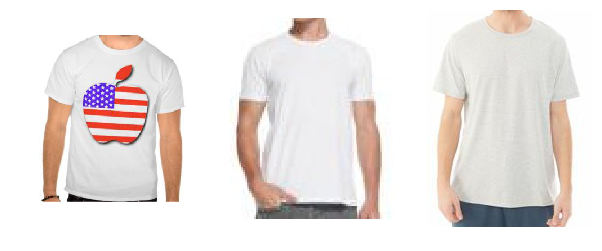

pos_dist: [ 1.36671185] neg_dist: [ 1.5876677] diff: [ 0.22095585] alpha: 0.05
[False]
pos_dist: [ 1.20583367] neg_dist: [ 1.53745663] diff: [ 0.33162296] alpha: 0.05
[False]
pos_dist: [ 1.24387395] neg_dist: [ 1.45540524] diff: [ 0.21153128] alpha: 0.05
[False]
pos_dist: [ 1.24749351] neg_dist: [ 1.64899731] diff: [ 0.4015038] alpha: 0.05
[False]
pos_dist: [ 1.38113332] neg_dist: [ 1.33546841] diff: [-0.04566491] alpha: 0.05
[ True]


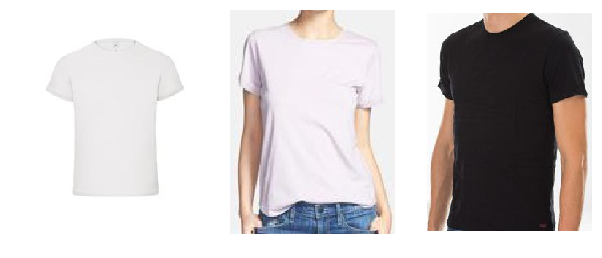

pos_dist: [ 1.2882545] neg_dist: [ 1.44093943] diff: [ 0.15268493] alpha: 0.05
[False]
pos_dist: [ 1.43178082] neg_dist: [ 1.4703176] diff: [ 0.03853679] alpha: 0.05
[ True]


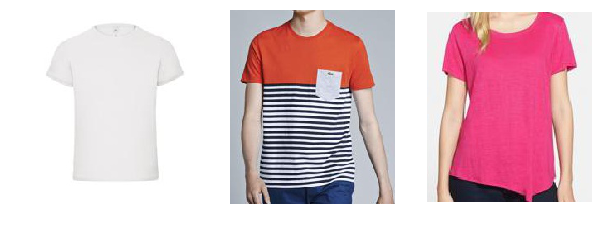

pos_dist: [ 1.39627218] neg_dist: [ 1.46085417] diff: [ 0.06458199] alpha: 0.05
[False]
pos_dist: [ 1.23843336] neg_dist: [ 1.50869954] diff: [ 0.27026618] alpha: 0.05
[False]
pos_dist: [ 1.24449134] neg_dist: [ 1.5477041] diff: [ 0.30321276] alpha: 0.05
[False]
pos_dist: [ 1.42760515] neg_dist: [ 1.42081356] diff: [-0.00679159] alpha: 0.05
[ True]


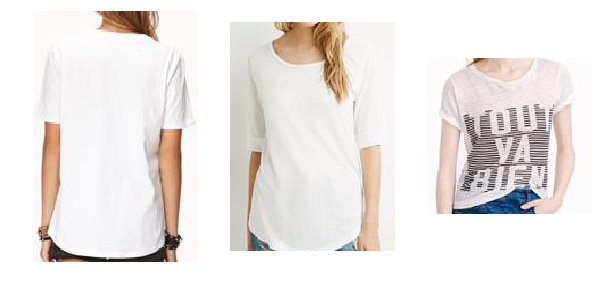

pos_dist: [ 1.41250348] neg_dist: [ 1.28664613] diff: [-0.12585735] alpha: 0.05
[ True]


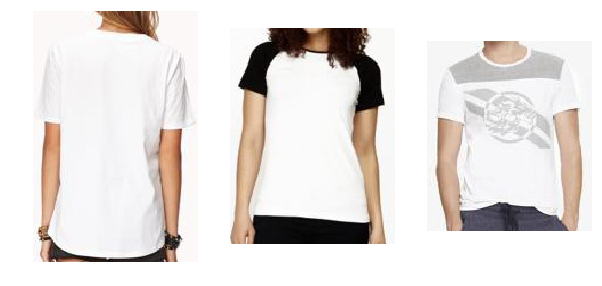

pos_dist: [ 1.40371311] neg_dist: [ 1.57400703] diff: [ 0.17029393] alpha: 0.05
[False]
pos_dist: [ 1.38063502] neg_dist: [ 1.46665788] diff: [ 0.08602285] alpha: 0.05
[False]
pos_dist: [ 1.35920382] neg_dist: [ 1.45992231] diff: [ 0.1007185] alpha: 0.05
[False]
pos_dist: [ 1.46668577] neg_dist: [ 1.50046372] diff: [ 0.03377795] alpha: 0.05
[ True]


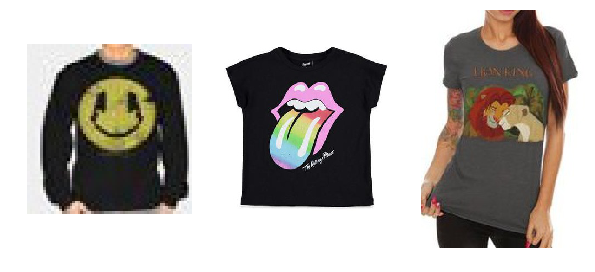

pos_dist: [ 1.48516786] neg_dist: [ 1.63163865] diff: [ 0.14647079] alpha: 0.05
[False]
pos_dist: [ 1.51795769] neg_dist: [ 1.50939941] diff: [-0.00855827] alpha: 0.05
[ True]


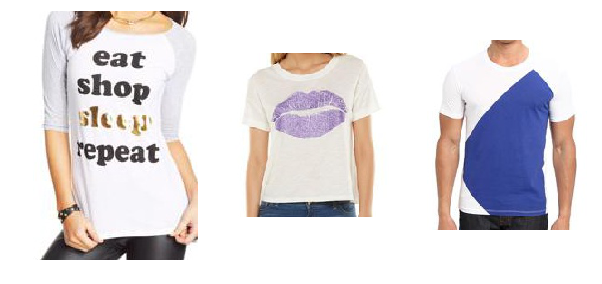

pos_dist: [ 1.37344861] neg_dist: [ 1.502051] diff: [ 0.12860239] alpha: 0.05
[False]
pos_dist: [ 1.53899789] neg_dist: [ 1.50116682] diff: [-0.03783107] alpha: 0.05
[ True]


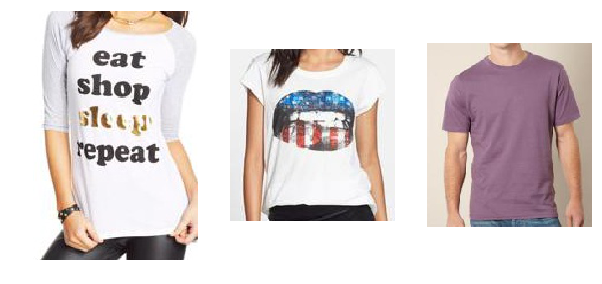

pos_dist: [ 1.35530376] neg_dist: [ 1.59345293] diff: [ 0.23814917] alpha: 0.05
[False]
pos_dist: [ 1.42493105] neg_dist: [ 1.54802847] diff: [ 0.12309742] alpha: 0.05
[False]
pos_dist: [ 1.41122985] neg_dist: [ 1.54256821] diff: [ 0.13133836] alpha: 0.05
[False]
pos_dist: [ 1.39746618] neg_dist: [ 1.37645209] diff: [-0.02101409] alpha: 0.05
[ True]


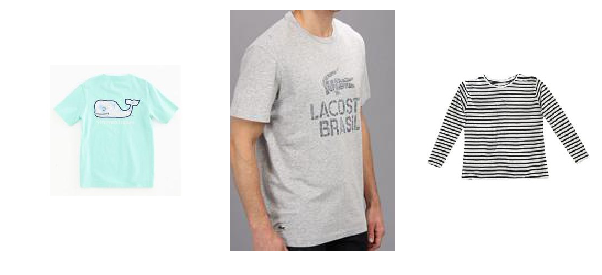

pos_dist: [ 1.42630363] neg_dist: [ 1.4272691] diff: [ 0.00096548] alpha: 0.05
[ True]


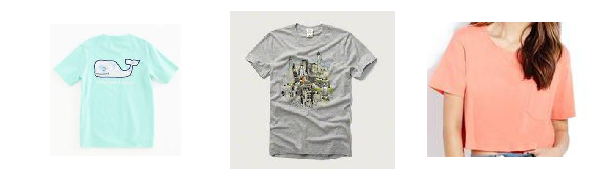

pos_dist: [ 1.36338091] neg_dist: [ 1.34420013] diff: [-0.01918077] alpha: 0.05
[ True]


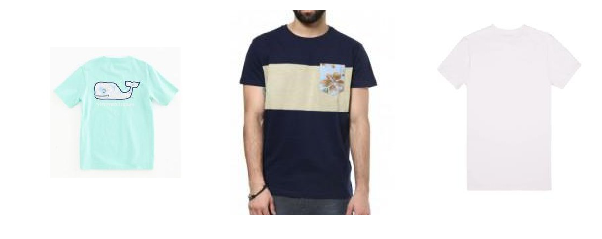

pos_dist: [ 1.43005967] neg_dist: [ 1.54269028] diff: [ 0.11263061] alpha: 0.05
[False]
pos_dist: [ 1.35413313] neg_dist: [ 1.54679847] diff: [ 0.19266534] alpha: 0.05
[False]
pos_dist: [ 1.30807066] neg_dist: [ 1.46199] diff: [ 0.15391934] alpha: 0.05
[False]
pos_dist: [ 1.14410043] neg_dist: [ 1.61735547] diff: [ 0.47325504] alpha: 0.05
[False]
pos_dist: [ 1.31783402] neg_dist: [ 1.42474437] diff: [ 0.10691035] alpha: 0.05
[False]
pos_dist: [ 1.27366638] neg_dist: [ 1.54202688] diff: [ 0.2683605] alpha: 0.05
[False]
pos_dist: [ 1.19082928] neg_dist: [ 1.4487536] diff: [ 0.25792432] alpha: 0.05
[False]
pos_dist: [ 1.43826509] neg_dist: [ 1.44762051] diff: [ 0.00935543] alpha: 0.05
[ True]


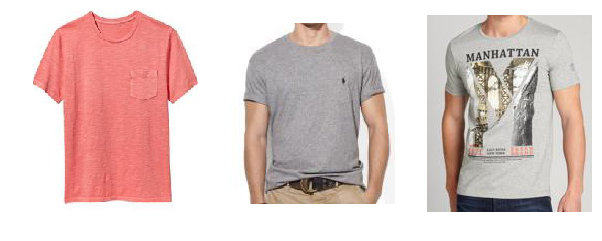

pos_dist: [ 1.28840959] neg_dist: [ 1.56061685] diff: [ 0.27220726] alpha: 0.05
[False]
pos_dist: [ 1.33443534] neg_dist: [ 1.60817027] diff: [ 0.27373493] alpha: 0.05
[False]
pos_dist: [ 1.28754497] neg_dist: [ 1.39535213] diff: [ 0.10780716] alpha: 0.05
[False]
pos_dist: [ 1.32333624] neg_dist: [ 1.39248753] diff: [ 0.06915128] alpha: 0.05
[False]
pos_dist: [ 1.34158552] neg_dist: [ 1.5288868] diff: [ 0.18730128] alpha: 0.05
[False]
pos_dist: [ 1.48415375] neg_dist: [ 1.6265322] diff: [ 0.14237845] alpha: 0.05
[False]
pos_dist: [ 1.42896402] neg_dist: [ 1.34329998] diff: [-0.08566403] alpha: 0.05
[ True]


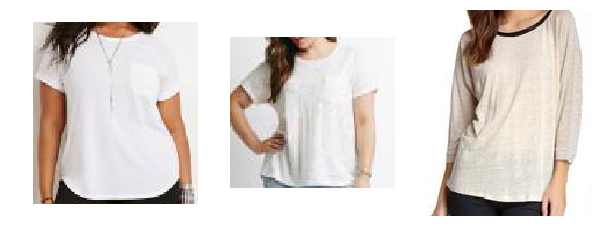

pos_dist: [ 1.26900804] neg_dist: [ 1.49986768] diff: [ 0.23085964] alpha: 0.05
[False]
pos_dist: [ 1.49168992] neg_dist: [ 1.43380547] diff: [-0.05788445] alpha: 0.05
[ True]


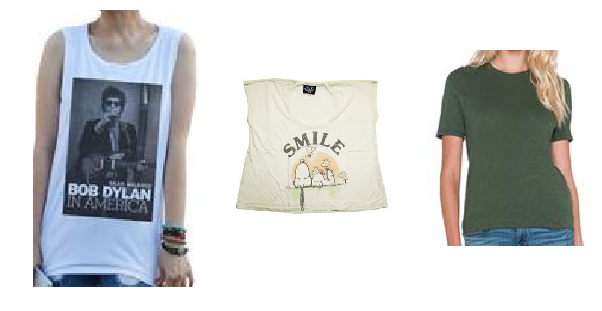

pos_dist: [ 1.51322031] neg_dist: [ 1.51560545] diff: [ 0.00238514] alpha: 0.05
[ True]


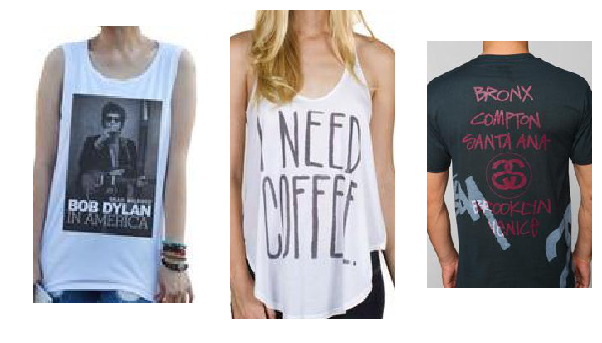

pos_dist: [ 1.38442457] neg_dist: [ 1.71211028] diff: [ 0.32768571] alpha: 0.05
[False]
pos_dist: [ 1.44049966] neg_dist: [ 1.57180429] diff: [ 0.13130462] alpha: 0.05
[False]
pos_dist: [ 1.44597757] neg_dist: [ 1.53287435] diff: [ 0.08689678] alpha: 0.05
[False]
pos_dist: [ 1.15318406] neg_dist: [ 1.36470151] diff: [ 0.21151745] alpha: 0.05
[False]
pos_dist: [ 1.45904231] neg_dist: [ 1.19233966] diff: [-0.26670265] alpha: 0.05
[ True]


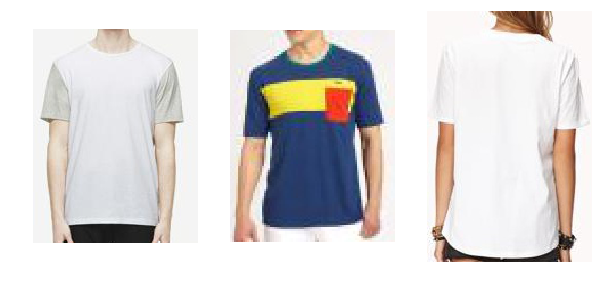

pos_dist: [ 1.40584815] neg_dist: [ 1.54596043] diff: [ 0.14011228] alpha: 0.05
[False]
pos_dist: [ 1.35838509] neg_dist: [ 1.31404233] diff: [-0.04434276] alpha: 0.05
[ True]


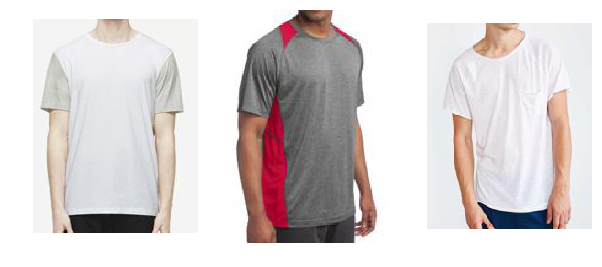

pos_dist: [ 1.29287624] neg_dist: [ 1.28210139] diff: [-0.01077485] alpha: 0.05
[ True]


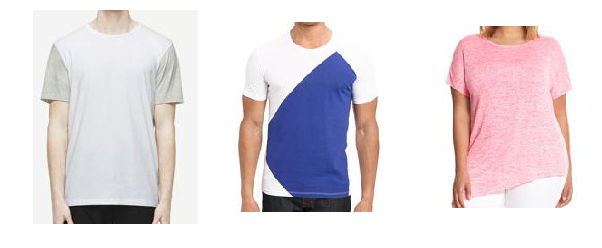

pos_dist: [ 1.40212834] neg_dist: [ 1.4915483] diff: [ 0.08941996] alpha: 0.05
[False]
pos_dist: [ 1.25900733] neg_dist: [ 1.48348653] diff: [ 0.2244792] alpha: 0.05
[False]
pos_dist: [ 1.16861749] neg_dist: [ 1.2794708] diff: [ 0.11085331] alpha: 0.05
[False]
pos_dist: [ 1.42598438] neg_dist: [ 1.41006637] diff: [-0.01591802] alpha: 0.05
[ True]


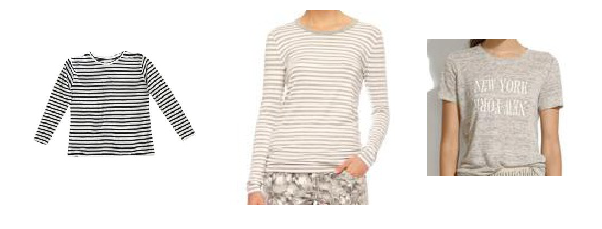

pos_dist: [ 1.40624881] neg_dist: [ 1.38388121] diff: [-0.0223676] alpha: 0.05
[ True]


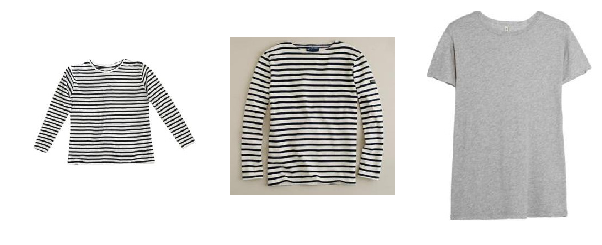

pos_dist: [ 1.23083782] neg_dist: [ 1.36260009] diff: [ 0.13176227] alpha: 0.05
[False]
pos_dist: [ 1.21989202] neg_dist: [ 1.43261433] diff: [ 0.2127223] alpha: 0.05
[False]
pos_dist: [ 1.3578527] neg_dist: [ 1.45335102] diff: [ 0.09549832] alpha: 0.05
[False]
pos_dist: [ 1.20834661] neg_dist: [ 1.57404828] diff: [ 0.36570168] alpha: 0.05
[False]
pos_dist: [ 1.52297902] neg_dist: [ 1.44538355] diff: [-0.07759547] alpha: 0.05
[ True]


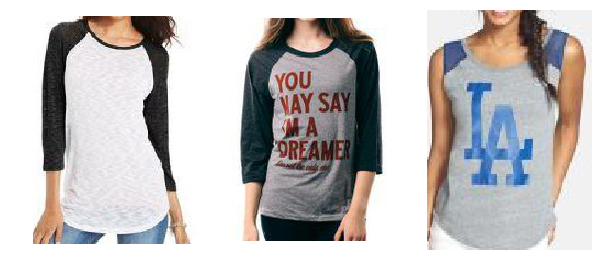

pos_dist: [ 1.32662761] neg_dist: [ 1.47292185] diff: [ 0.14629424] alpha: 0.05
[False]
pos_dist: [ 1.30360019] neg_dist: [ 1.6179775] diff: [ 0.31437731] alpha: 0.05
[False]
pos_dist: [ 1.48596001] neg_dist: [ 1.40874529] diff: [-0.07721472] alpha: 0.05
[ True]


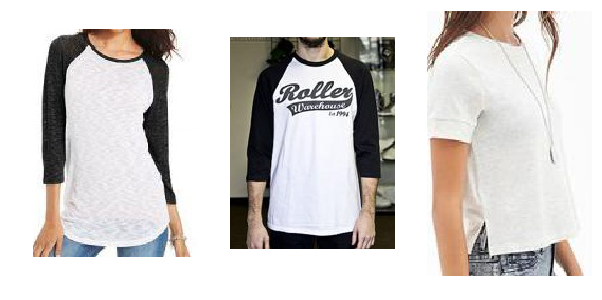

pos_dist: [ 1.35468829] neg_dist: [ 1.48587179] diff: [ 0.13118351] alpha: 0.05
[False]
pos_dist: [ 1.45310819] neg_dist: [ 1.62752318] diff: [ 0.17441499] alpha: 0.05
[False]
pos_dist: [ 1.57044721] neg_dist: [ 1.32003832] diff: [-0.25040889] alpha: 0.05
[ True]


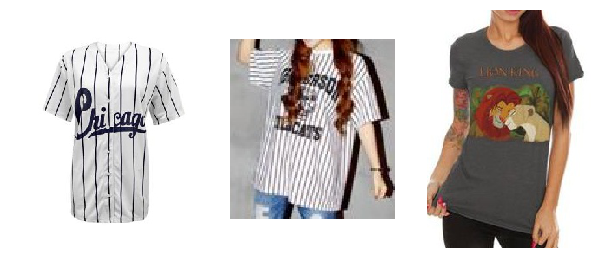

pos_dist: [ 1.56274676] neg_dist: [ 1.40284371] diff: [-0.15990305] alpha: 0.05
[ True]


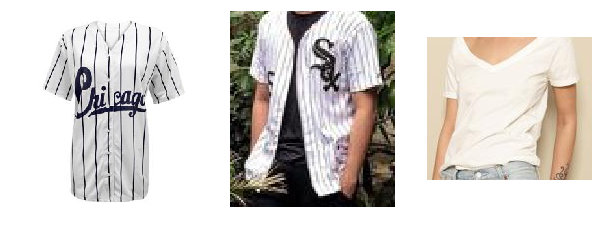

pos_dist: [ 1.50946403] neg_dist: [ 1.40386319] diff: [-0.10560083] alpha: 0.05
[ True]


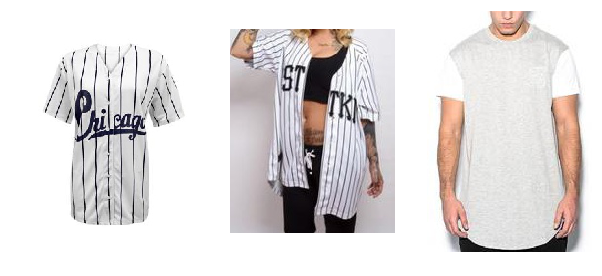

pos_dist: [ 1.20657074] neg_dist: [ 1.42865729] diff: [ 0.22208655] alpha: 0.05
[False]
pos_dist: [ 1.47020364] neg_dist: [ 1.31609607] diff: [-0.15410757] alpha: 0.05
[ True]


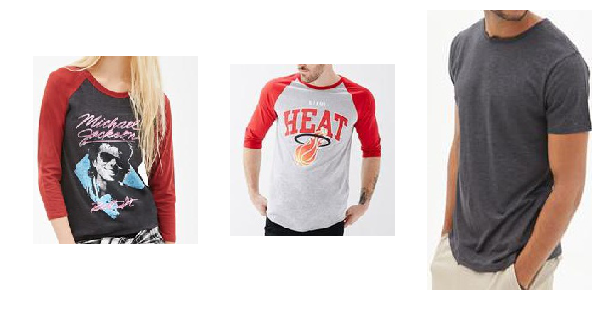

pos_dist: [ 1.54399967] neg_dist: [ 1.42592537] diff: [-0.1180743] alpha: 0.05
[ True]


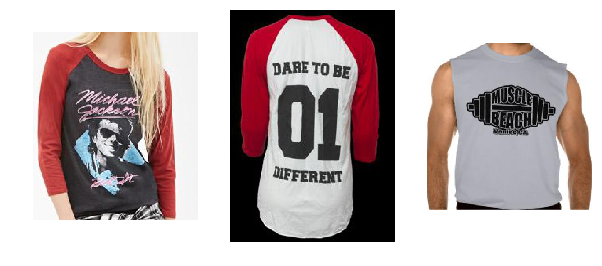

pos_dist: [ 1.36729538] neg_dist: [ 1.38760352] diff: [ 0.02030814] alpha: 0.05
[ True]


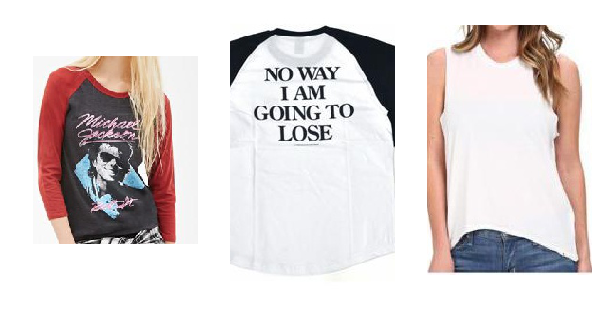

pos_dist: [ 1.44516468] neg_dist: [ 1.42641544] diff: [-0.01874924] alpha: 0.05
[ True]


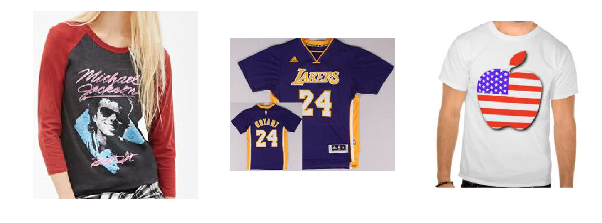

pos_dist: [ 1.59654045] neg_dist: [ 1.45374894] diff: [-0.14279151] alpha: 0.05
[ True]


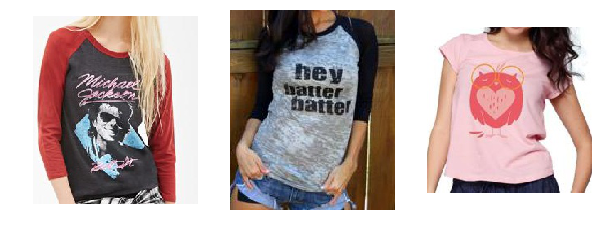

pos_dist: [ 1.45529866] neg_dist: [ 1.47347033] diff: [ 0.01817167] alpha: 0.05
[ True]


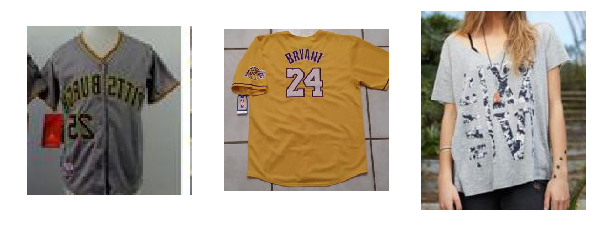

pos_dist: [ 1.40589368] neg_dist: [ 1.497154] diff: [ 0.09126031] alpha: 0.05
[False]
pos_dist: [ 1.48672926] neg_dist: [ 1.45750141] diff: [-0.02922785] alpha: 0.05
[ True]


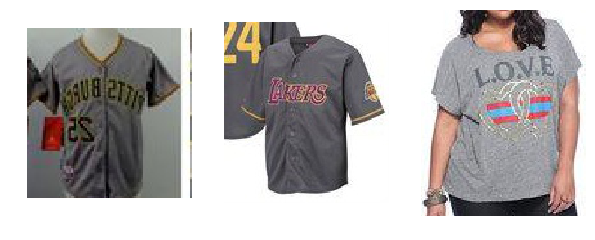

pos_dist: [ 1.3998487] neg_dist: [ 1.4496479] diff: [ 0.0497992] alpha: 0.05
[ True]


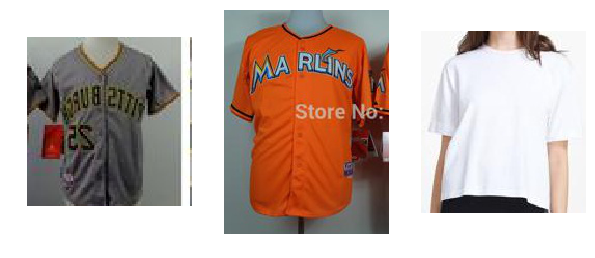

pos_dist: [ 1.48851407] neg_dist: [ 1.51803267] diff: [ 0.0295186] alpha: 0.05
[ True]


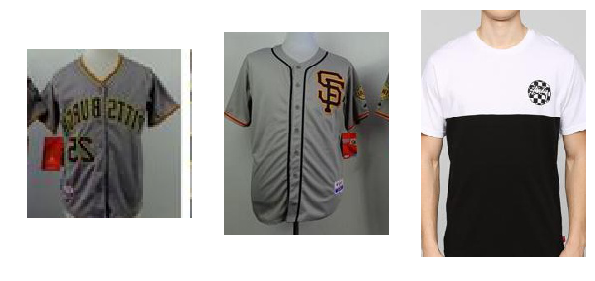

pos_dist: [ 1.33730614] neg_dist: [ 1.49948871] diff: [ 0.16218257] alpha: 0.05
[False]
pos_dist: [ 1.42212462] neg_dist: [ 1.51157498] diff: [ 0.08945036] alpha: 0.05
[False]
pos_dist: [ 1.36396432] neg_dist: [ 1.3986721] diff: [ 0.03470778] alpha: 0.05
[ True]


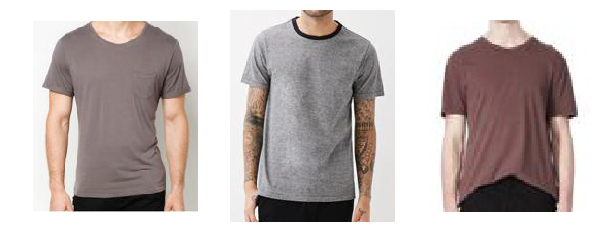

pos_dist: [ 1.14381731] neg_dist: [ 1.48927355] diff: [ 0.34545624] alpha: 0.05
[False]
pos_dist: [ 1.25077116] neg_dist: [ 1.58341217] diff: [ 0.33264101] alpha: 0.05
[False]
pos_dist: [ 1.32827997] neg_dist: [ 1.49211287] diff: [ 0.1638329] alpha: 0.05
[False]
pos_dist: [ 1.12305188] neg_dist: [ 1.34026217] diff: [ 0.21721029] alpha: 0.05
[False]
pos_dist: [ 1.38094199] neg_dist: [ 1.58467269] diff: [ 0.2037307] alpha: 0.05
[False]
pos_dist: [ 1.62150717] neg_dist: [ 1.43739259] diff: [-0.18411458] alpha: 0.05
[ True]


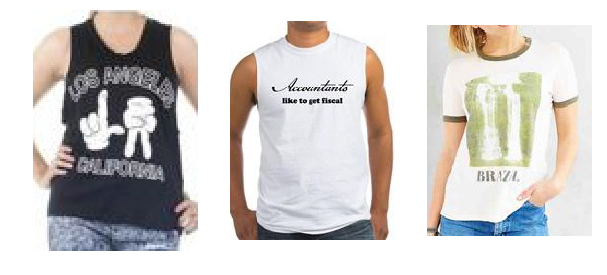

pos_dist: [ 1.4127059] neg_dist: [ 1.56787896] diff: [ 0.15517306] alpha: 0.05
[False]
pos_dist: [ 1.33368921] neg_dist: [ 1.54725218] diff: [ 0.21356297] alpha: 0.05
[False]
pos_dist: [ 1.39188457] neg_dist: [ 1.45579672] diff: [ 0.06391215] alpha: 0.05
[False]
pos_dist: [ 1.5171988] neg_dist: [ 1.44298935] diff: [-0.07420945] alpha: 0.05
[ True]


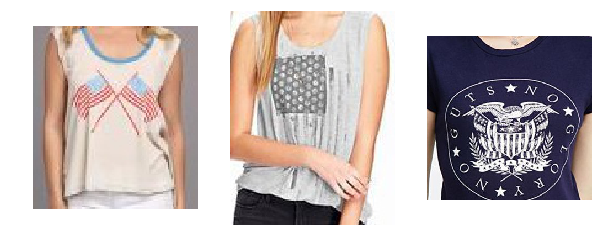

pos_dist: [ 1.38724017] neg_dist: [ 1.52968228] diff: [ 0.14244211] alpha: 0.05
[False]
pos_dist: [ 1.15519869] neg_dist: [ 1.55552459] diff: [ 0.40032589] alpha: 0.05
[False]
pos_dist: [ 1.33888316] neg_dist: [ 1.67478657] diff: [ 0.33590341] alpha: 0.05
[False]
pos_dist: [ 1.24914932] neg_dist: [ 1.46048748] diff: [ 0.21133816] alpha: 0.05
[False]
pos_dist: [ 1.39565837] neg_dist: [ 1.46615028] diff: [ 0.07049191] alpha: 0.05
[False]
pos_dist: [ 1.44889259] neg_dist: [ 1.46546042] diff: [ 0.01656783] alpha: 0.05
[ True]


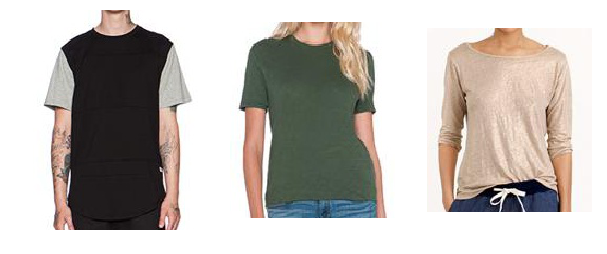

pos_dist: [ 1.37012756] neg_dist: [ 1.38981724] diff: [ 0.01968968] alpha: 0.05
[ True]


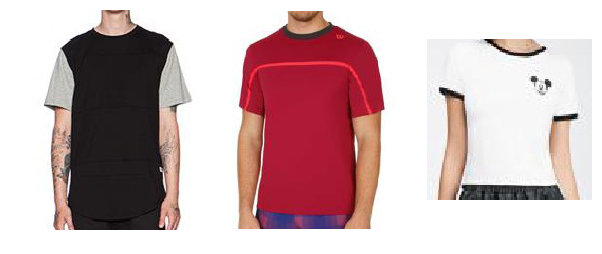

pos_dist: [ 1.51093352] neg_dist: [ 1.44120669] diff: [-0.06972682] alpha: 0.05
[ True]


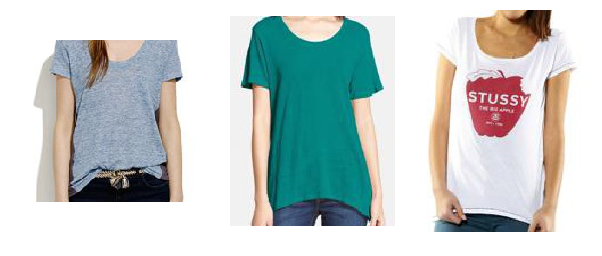

pos_dist: [ 1.30436337] neg_dist: [ 1.6301353] diff: [ 0.32577193] alpha: 0.05
[False]
pos_dist: [ 1.36057281] neg_dist: [ 1.60705423] diff: [ 0.24648142] alpha: 0.05
[False]
pos_dist: [ 1.51463902] neg_dist: [ 1.51065254] diff: [-0.00398648] alpha: 0.05
[ True]


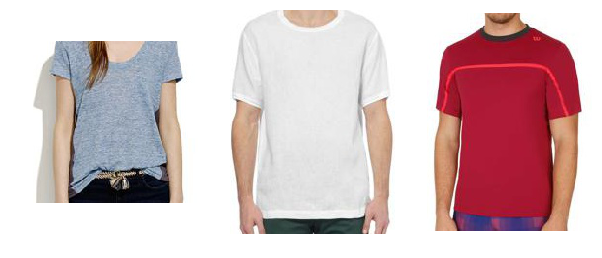

pos_dist: [ 1.44334221] neg_dist: [ 1.53418183] diff: [ 0.09083962] alpha: 0.05
[False]
pos_dist: [ 1.31417096] neg_dist: [ 1.42990112] diff: [ 0.11573017] alpha: 0.05
[False]
pos_dist: [ 1.31743026] neg_dist: [ 1.26099467] diff: [-0.05643559] alpha: 0.05
[ True]


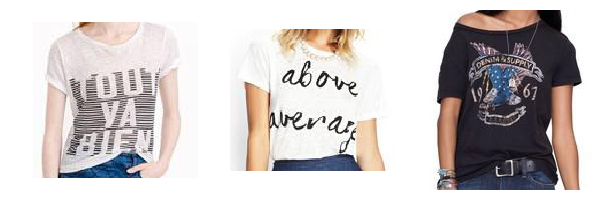

pos_dist: [ 1.16781831] neg_dist: [ 1.56084347] diff: [ 0.39302516] alpha: 0.05
[False]
pos_dist: [ 1.37127364] neg_dist: [ 1.46285784] diff: [ 0.09158421] alpha: 0.05
[False]


In [4]:
def main(args):
    np.random.seed(seed=args.seed)
    if args.pretrained_model:
        print('Pre-trained model: %s' % os.path.expanduser(args.pretrained_model))

    with tf.Graph().as_default(), tf.device('/cpu:0'):
        tf.set_random_seed(args.seed)
        global_step = tf.Variable(0, trainable=False)

        # Placeholder for the learning rate
        learning_rate_placeholder = tf.placeholder(tf.float32, name='learning_rate')
        batch_size_placeholder = tf.placeholder(tf.int32, name='batch_size')        
        phase_train_placeholder = tf.placeholder(tf.bool, name='phase_train')
                
        def _read_py_function(image_path, box_path, np_label):
            ret_images = np.zeros((3, args.image_size, args.image_size, 3), dtype=np.float32)
            ret_box = np.zeros((3, args.num_bbox, 4), dtype=np.float32)

            im_a = cv2.imread(image_path[0], cv2.IMREAD_COLOR)
            im_p = cv2.imread(image_path[1], cv2.IMREAD_COLOR)
            im_n = cv2.imread(image_path[2], cv2.IMREAD_COLOR)

            im_a = cv2.cvtColor(im_a, cv2.COLOR_BGR2RGB)
            im_p = cv2.cvtColor(im_p, cv2.COLOR_BGR2RGB)
            im_n = cv2.cvtColor(im_n, cv2.COLOR_BGR2RGB)
            im_a = ((im_a * 0.00392156) -0.5 ) * 2.0
            im_p = ((im_p * 0.00392156) -0.5 ) * 2.0
            im_n = ((im_n * 0.00392156) -0.5 ) * 2.0
            im_a_height, im_a_width = im_a.shape[:2]
            im_p_height, im_p_width = im_p.shape[:2]
            im_n_height, im_n_width = im_n.shape[:2]
            im_size_list = [[im_a_height, im_a_width],[im_p_height, im_p_width],[im_n_height, im_n_width]]
            im_scale_list = [0.5,0.7,0.9]
            num_box_per_case = 11
            for im_size_idx, im_size in enumerate(im_size_list): 
                im_height,im_width = im_size
                ret_box[im_size_idx,0,:]=[0, 0, im_height-1, im_width-1]
                for im_scale_idx, im_scale in enumerate(im_scale_list):
                    tmp_im_scale_idx = im_scale_idx*num_box_per_case
                    box_height = im_height * im_scale 
                    box_width = im_width * im_scale
                    height_im_box_half_diff = (im_height-box_height-1)*0.5
                    width_im_box_half_diff = (im_width-box_width-1)*0.5

                    ret_box[im_size_idx,tmp_im_scale_idx+1,:]=[height_im_box_half_diff,width_im_box_half_diff,height_im_box_half_diff+box_height,(im_width-box_width)*0.5+box_width]
                    ret_box[im_size_idx,tmp_im_scale_idx+2,:]=[0, 0, box_height-1, box_width-1]
                    ret_box[im_size_idx,tmp_im_scale_idx+3,:]=[im_height-box_height-1,im_width-box_width-1 , im_height-1, im_width-1]
                    ret_box[im_size_idx,tmp_im_scale_idx+4,:]=[0,im_width-box_width-1 , box_height-1, im_width-1]
                    ret_box[im_size_idx,tmp_im_scale_idx+5,:]=[im_height-box_height-1,0 , im_height-1, box_width-1]
                    ret_box[im_size_idx,tmp_im_scale_idx+6,:]=[0, 0, im_height-1, box_width-1]
                    ret_box[im_size_idx,tmp_im_scale_idx+7,:]=[0, width_im_box_half_diff, im_height-1, width_im_box_half_diff+box_width-1]
                    ret_box[im_size_idx,tmp_im_scale_idx+8,:]=[0, im_width-box_width-1, im_height-1, im_width-1]
                    ret_box[im_size_idx,tmp_im_scale_idx+9,:]=[0, 0, box_height-1, im_width-1]
                    ret_box[im_size_idx,tmp_im_scale_idx+10,:]=[height_im_box_half_diff, 0, height_im_box_half_diff+box_height-1, im_width-1]
                    ret_box[im_size_idx,tmp_im_scale_idx+11,:]=[im_height-box_height-1, 0, im_height-1, im_width-1]

                ret_box[im_size_idx,:,1::2] = ret_box[im_size_idx,:,1::2] / float(im_width)
                ret_box[im_size_idx,:,::2] = ret_box[im_size_idx,:,::2] / float(im_height)

            im_a = cv2.resize(im_a,(args.image_size,args.image_size))#resize_to_min_dimension_np(im_a, max_dimension=args.image_size)        
            im_p = cv2.resize(im_p,(args.image_size,args.image_size))#resize_to_min_dimension_np(im_p, max_dimension=args.image_size)
            im_n = cv2.resize(im_n,(args.image_size,args.image_size))#resize_to_min_dimension_np(im_n, max_dimension=args.image_size)

            if (random.uniform(0,1)>0.5):
                im_a = cv2.flip(im_a, 1)
                ret_box[0,:,1::2] = 1.0 - ret_box[0,:,1::2]
            if (random.uniform(0,1)>0.5):
                im_p = cv2.flip(im_p, 1)
                ret_box[1,:,1::2] = 1.0 - ret_box[1,:,1::2]
            if (random.uniform(0,1)>0.5):
                im_n = cv2.flip(im_n, 1)
                ret_box[2,:,1::2] = 1.0 - ret_box[2,:,1::2]
            ret_images[0] = im_a
            ret_images[1] = im_p
            ret_images[2] = im_n
            return ret_images, ret_box, np_label
        print('start load train list')
        f = open(os.path.join('/data/scom/workspace/hjmoon/deepfashion','divided_category_v2.pkl'),'r')
        dataset_dict = pickle.load(f)
        f.close()
        image_tf = tf.placeholder(tf.string, [args.iterator_init_size,3])
        bbox_tf = tf.placeholder(tf.string, [args.iterator_init_size,3])
        label_tf = tf.placeholder(tf.int32, [args.iterator_init_size,1])
        dataset = tf.data.Dataset.from_tensor_slices((image_tf,bbox_tf,label_tf))
        dataset = dataset.map(lambda image_path,box_path,label: tuple(tf.py_func(_read_py_function, [image_path, box_path,label], [tf.float32, tf.float32, tf.int32])),num_parallel_calls=16 )

        dataset = dataset.batch(args.batch_size)#batch(1)
        iterator = dataset.make_initializable_iterator()#dataset.make_one_shot_iterator()
        nrof_batches = args.batch_size

        learning_rate = tf.train.exponential_decay(learning_rate_placeholder, global_step, args.learning_rate_decay_epochs*int(nrof_batches/args.num_clone), args.learning_rate_decay_factor, staircase=True)

        # Compute gradients.
        #with tf.control_dependencies([loss_averages_op]):
        if args.optimizer=='ADAGRAD':
            opt = tf.train.AdagradOptimizer(learning_rate)
        elif args.optimizer=='ADADELTA':
            opt = tf.train.AdadeltaOptimizer(learning_rate, rho=0.9, epsilon=1e-6)
        elif args.optimizer=='ADAM':
            opt = tf.train.AdamOptimizer(learning_rate, beta1=0.9, beta2=0.999, epsilon=0.1)
        elif args.optimizer=='RMSPROP':
            opt = tf.train.RMSPropOptimizer(learning_rate, decay=0.9, momentum=0.9, epsilon=1.0)
        elif args.optimizer=='MOM':
            opt = tf.train.MomentumOptimizer(learning_rate, 0.9, use_nesterov=True)
        elif args.optimizer=='SGD':
            opt = tf.train.GradientDescentOptimizer(learning_rate)
        else:
            raise ValueError('Invalid optimization algorithm')
        network_fn = nets_factory.get_network_fn(args.model_def, is_training=phase_train_placeholder,  num_classes=args.num_classes, weight_decay=args.weight_decay)
        opt_grads = [] 
        loss_label = []
        triplet_losses = []
#         for i in range(args.num_clone):
#        i = 0 
#        with tf.device('/gpu:%d'%(i+1)):
#            with tf.device('/gpu:%d'%i):
#                 with tf.name_scope('%s_%d' % ("gpu", i)) as scope:
#                   with tf.variable_scope(tf.get_variable_scope(), reuse=True if i > 0 else None):
        image_batch, bboxes_batch, label_batch = iterator.get_next()  
        image_batch = tf.reshape(image_batch, [-1,args.image_size,args.image_size,3])
        bboxes_batch = tf.reshape(bboxes_batch, [-1,args.num_bbox,4])
        image_batch = tf.identity(image_batch, 'image_batch')
        bboxes_batch = tf.identity(bboxes_batch, 'bboxes_batch')

        # Build the inference graph
        print('init network')
        _, end_points = network_fn(image_batch, create_aux_logits=False, spatial_squeeze=False)
        embeddings3 = build_tiplet_net(args, end_points, bboxes_batch)

        # Split embeddings into anchor, positive and negative and calculate triplet loss
        anchor, positive, negative = tf.unstack(tf.reshape(embeddings3, [-1,3,args.embedding_size]), 3, 1)
        triplet_loss = triplet_loss_fn(anchor, positive, negative, args.alpha)
        loss_label.append([embeddings3, label_batch])
        # Calculate the total losses
        regularization_losses = tf.get_collection(tf.GraphKeys.REGULARIZATION_LOSSES)
        total_loss = tf.add_n([triplet_loss] + regularization_losses, name='total_loss')
        triplet_losses.append(total_loss)
        # Generate moving averages of all losses and associated summaries.
        grads = opt.compute_gradients(total_loss)
        opt_grads.append(grads)

        grads = average_gradients(opt_grads)
        # Apply gradients.
        apply_gradient_op = opt.apply_gradients(grads, global_step=global_step)
        tf.summary.scalar('learning_rate', learning_rate)

        total_triplet_loss = tf.add_n(triplet_losses, name='total_triplet_loss')
        tf.summary.scalar('total_loss(reg)', total_triplet_loss)
        # Track the moving averages of all trainable variables.
        variable_averages = tf.train.ExponentialMovingAverage(  args.moving_average_decay, global_step)
        variables_averages_op = variable_averages.apply(tf.model_variables())
    
        # Group all updates to into a single train op.
        train_op = tf.group(apply_gradient_op, variables_averages_op)

        # Add histograms for trainable variables.
        if 1:#log_histograms:
            for var in tf.trainable_variables():
                tf.summary.histogram(var.op.name, var)
       
        # Add histograms for gradients.
        if 1:#log_histograms:
            for grad, var in grads:
                if grad is not None:
                    tf.summary.histogram(var.op.name + '/gradients', grad)
      
        
        # Create a saver
        saver = tf.train.Saver(tf.trainable_variables(), max_to_keep=10)

        # Build the summary operation based on the TF collection of Summaries.
        summary_op = tf.summary.merge_all()

        # Start running operations on the Graph.
        #gpu_options = tf.GPUOptions(per_process_gpu_memory_fraction=args.gpu_memory_fraction)
        sess = tf.Session(config=tf.ConfigProto())#gpu_options=gpu_options))        

        # Initialize variables
        sess.run(tf.global_variables_initializer(), feed_dict={phase_train_placeholder:True})
        sess.run(tf.local_variables_initializer(), feed_dict={phase_train_placeholder:True})

#         summary_writer = tf.summary.FileWriter(log_dir, sess.graph)
#        coord = tf.train.Coordinator()
#        tf.train.start_queue_runners(coord=coord, sess=sess)

        with sess.as_default():
            if args.pretrained_model:
                print('Restoring pretrained model: %s' % args.pretrained_model)
                exclusions = []
                if args.checkpoint_exclude_scopes:
                  exclusions = [scope.strip() for scope in args.checkpoint_exclude_scopes.split(',')]
 
                # TODO(sguada) variables.filter_variables()
                variables_to_restore = []
                for var in tf.trainable_variables():#global_variables():#slim.get_model_variables():
                  excluded = False
                  for exclusion in exclusions:
                    if var.op.name.startswith(exclusion):
                      excluded = True
                      break
                  if not excluded:
                    variables_to_restore.append(var)
                restore_saver = tf.train.Saver(variables_to_restore)
                restore_saver.restore(sess, args.pretrained_model)
            # Training and validation loop
            epoch = 0
            print('start training')
#             while epoch < args.max_nrof_epochs:
            i = 0
            train_time = 0
            step = sess.run(global_step, feed_dict=None)
            #############
            # Preselect #
            #############
            np_image, _ = preselect(args, sess, iterator, image_tf, bbox_tf, label_tf, dataset_dict)
            selected_triplet=[]
            while True:
                try:
                    feed_dict = {learning_rate_placeholder: 0.0, phase_train_placeholder: True}
                    op_tf = list(itertools.chain.from_iterable(loss_label))
                    result = sess.run(op_tf, feed_dict=feed_dict)
                    for result_idx in range(0,len(result),2):
                        embed, np_label = result[result_idx:result_idx+2]
                        embed= embed.reshape(-1,3,args.embedding_size)
                        pos_dist_sqr = np.sum(np.square(embed[:,0,:]-embed[:,1,:]),axis=1)
                        neg_dist_sqr = np.sum(np.square(embed[:,0,:]-embed[:,2,:]),axis=1)
                        diff = neg_dist_sqr - pos_dist_sqr
                        print('pos_dist:',pos_dist_sqr,'neg_dist:',neg_dist_sqr,'diff:',diff,'alpha:',args.alpha)
                        print(diff<args.alpha)

                        all_neg = np.where(diff<args.alpha)[0]#np.where(np.logical_and(neg_dist_sqr-pos_dist_sqr<args.alpha, pos_dist_sqr<neg_dist_sqr))[0]
                        for neg_idx in all_neg:
                            selected_triplet.append([np_image[np_label[neg_idx,0]][0],
                                                    np_image[np_label[neg_idx,0]][1],
                                                    np_image[np_label[neg_idx,0]][2],
                                                    np_image[np_label[neg_idx,0]][0],
                                                    np_image[np_label[neg_idx,0]][1],
                                                    np_image[np_label[neg_idx,0]][2]])
                            #                 print(anchor_path)
#                             print(positive_path)
#                             print(negative_path)

                            gs1 = gridspec.GridSpec(1, 3)
                            gs1.update(wspace=0.01, hspace=0.02) # set the spacing between axes. 
                            plt.figure(figsize=(10,10))

                            for im_idx, im_path in enumerate([np_image[np_label[neg_idx,0]][0],
                                                            np_image[np_label[neg_idx,0]][1],
                                                            np_image[np_label[neg_idx,0]][2]]):
                                im = cv2.imread(os.path.join('cropped_images','Category-Attribute-Prediction-Benchmark',im_path))
                                im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
                                if im_idx == 0:
                                    title='anc'
                                elif im_idx == 1:
                                    title='pos'
                                else:
                                    title='neg'
                                ax1 = plt.subplot(gs1[im_idx])
                                ax1.set_title(title)
                                ax1.set_xticklabels([])
                                ax1.set_yticklabels([])
                                ax1.set_aspect('equal')

                                plt.subplot(1,3,im_idx+1)
                                plt.imshow(im)
                                plt.axis('off')
                            plt.show()
                except tf.errors.OutOfRangeError:
                    break
#                     if len(selected_triplet)>=num_cache_list:
#                         break
#                 if len(selected_triplet)>=num_cache_list:
#                         break
            
#             print('time:',(time.time() - start_time))
#             print('selected triplet:',len(selected_triplet))
#                 i=0
#                 random.shuffle(selected_triplet)
#                 np_selected_triplet = np.array(selected_triplet[:num_cache_list])
#                 np_image = np_selected_triplet[:,:3]
#                 np_bbox = np_selected_triplet[:,3:]
#                 np_label = np.array([v for v in range(np_selected_triplet.shape[0])],dtype=np.int).reshape(-1,1)
#                 sess.run(iterator.initializer, feed_dict={image_tf: np_image, bbox_tf: np_bbox, label_tf:np_label})
#                 j=1
#                 while j<num_cache_list/(args.batch_size*args.num_clone):
#                     try:    
#                         start_time = time.time()
#                         feed_dict = {learning_rate_placeholder: args.learning_rate, phase_train_placeholder: True}
#                         err, _, step, _summary_op = sess.run([total_loss, train_op, global_step, summary_op ], feed_dict=feed_dict)
#                         duration = time.time() - start_time
#                         if j % 10 == 0:
#                             print('Epoch: [%d][%d/%d]\tTime %.3f\tLoss %2.3f' % (epoch, j+1, num_cache_list/(args.batch_size*args.num_clone), duration, err))
#                         if args.log_interval < train_time:
#                             train_time = 0
#                             # Save variables and the metagraph if it doesn't exist already
#                         if train_time == 0:
#                             summary_writer.add_summary(_summary_op, step)
#                             save_variables_and_metagraph(sess, saver, summary_writer, model_dir, subdir, step)

#                         train_time += duration
#                         j+=1
#                     except tf.errors.OutOfRangeError:
#                         break

#                 epoch += 1
#     return model_dir


def train(args, sess, dataset, epoch, image_paths_placeholder, labels_placeholder, labels_batch,
          batch_size_placeholder, learning_rate_placeholder, phase_train_placeholder, enqueue_op, input_queue, global_step, 
          embeddings, loss, train_op, summary_op, summary_writer, learning_rate_schedule_file,
          embedding_size, anchor, positive, negative, triplet_loss):
    batch_number = 0
    
    if args.learning_rate>0.0:
        lr = args.learning_rate
    else:
        lr = facenet.get_learning_rate_from_file(learning_rate_schedule_file, epoch)
    while batch_number < args.epoch_size:
        # Perform training on the selected triplets
        nrof_batches = int(np.ceil(nrof_triplets*3/args.batch_size))
        triplet_paths = list(itertools.chain(*triplets))
        labels_array = np.reshape(np.arange(len(triplet_paths)),(-1,3))
        triplet_paths_array = np.reshape(np.expand_dims(np.array(triplet_paths),1), (-1,3))
        sess.run(enqueue_op, {image_paths_placeholder: triplet_paths_array, labels_placeholder: labels_array})
        nrof_examples = len(triplet_paths)
        train_time = 0
        i = 0
        emb_array = np.zeros((nrof_examples, embedding_size))
        loss_array = np.zeros((nrof_triplets,))
        while i < nrof_batches:
            start_time = time.time()
            batch_size = min(nrof_examples-i*args.batch_size, args.batch_size)
            feed_dict = {batch_size_placeholder: batch_size, learning_rate_placeholder: lr, phase_train_placeholder: True}
            err, _, step, emb, lab = sess.run([loss, train_op, global_step, embeddings, labels_batch], feed_dict=feed_dict)
            emb_array[lab,:] = emb
            loss_array[i] = err
            duration = time.time() - start_time
            print('Epoch: [%d][%d/%d]\tTime %.3f\tLoss %2.3f' %
                  (epoch, batch_number+1, args.epoch_size, duration, err))
            batch_number += 1
            i += 1
            train_time += duration
            
        # Add validation loss and accuracy to summary
        summary = tf.Summary()
        #pylint: disable=maybe-no-member
        summary.value.add(tag='time/selection', simple_value=selection_time)
        summary_writer.add_summary(summary, step)
    return step
  
def evaluate(sess, image_paths, embeddings, labels_batch, image_paths_placeholder, labels_placeholder, 
        batch_size_placeholder, learning_rate_placeholder, phase_train_placeholder, enqueue_op, actual_issame, batch_size, 
        nrof_folds, log_dir, step, summary_writer, embedding_size):
    start_time = time.time()
    # Run forward pass to calculate embeddings
    print('Running forward pass on LFW images: ', end='')
    
    nrof_images = len(actual_issame)*2
    assert(len(image_paths)==nrof_images)
    labels_array = np.reshape(np.arange(nrof_images),(-1,3))
    image_paths_array = np.reshape(np.expand_dims(np.array(image_paths),1), (-1,3))
    sess.run(enqueue_op, {image_paths_placeholder: image_paths_array, labels_placeholder: labels_array})
    emb_array = np.zeros((nrof_images, embedding_size))
    nrof_batches = int(np.ceil(nrof_images / batch_size))
    label_check_array = np.zeros((nrof_images,))
    for i in xrange(nrof_batches):
        batch_size = min(nrof_images-i*batch_size, batch_size)
        emb, lab = sess.run([embeddings, labels_batch], feed_dict={batch_size_placeholder: batch_size,
            learning_rate_placeholder: 0.0, phase_train_placeholder: False})
        emb_array[lab,:] = emb
        label_check_array[lab] = 1
    print('%.3f' % (time.time()-start_time))
    
    assert(np.all(label_check_array==1))
    
    _, _, accuracy, val, val_std, far = lfw.evaluate(emb_array, actual_issame, nrof_folds=nrof_folds)
    
    print('Accuracy: %1.3f+-%1.3f' % (np.mean(accuracy), np.std(accuracy)))
    print('Validation rate: %2.5f+-%2.5f @ FAR=%2.5f' % (val, val_std, far))
    lfw_time = time.time() - start_time
    # Add validation loss and accuracy to summary
    summary = tf.Summary()
    #pylint: disable=maybe-no-member
    summary.value.add(tag='lfw/accuracy', simple_value=np.mean(accuracy))
    summary.value.add(tag='lfw/val_rate', simple_value=val)
    summary.value.add(tag='time/lfw', simple_value=lfw_time)
    summary_writer.add_summary(summary, step)
    with open(os.path.join(log_dir,'lfw_result.txt'),'at') as f:
        f.write('%d\t%.5f\t%.5f\n' % (step, np.mean(accuracy), val))

def save_variables_and_metagraph(sess, saver, summary_writer, model_dir, model_name, step):
    # Save the model checkpoint
    print('Saving variables')
    start_time = time.time()
    checkpoint_path = os.path.join(model_dir, 'model-%s.ckpt' % model_name)
    saver.save(sess, checkpoint_path, global_step=step, write_meta_graph=False)
    save_time_variables = time.time() - start_time
    print('Variables saved in %.2f seconds' % save_time_variables)
    metagraph_filename = os.path.join(model_dir, 'model-%s.meta' % model_name)
    save_time_metagraph = 0  
    if not os.path.exists(metagraph_filename):
        print('Saving metagraph')
        start_time = time.time()
        saver.export_meta_graph(metagraph_filename)
        save_time_metagraph = time.time() - start_time
        print('Metagraph saved in %.2f seconds' % save_time_metagraph)
    summary = tf.Summary()
    #pylint: disable=maybe-no-member
    summary.value.add(tag='time/save_variables', simple_value=save_time_variables)
    summary.value.add(tag='time/save_metagraph', simple_value=save_time_metagraph)
    summary_writer.add_summary(summary, step)
  
  
def get_learning_rate_from_file(filename, epoch):
    with open(filename, 'r') as f:
        for line in f.readlines():
            line = line.split('#', 1)[0]
            if line:
                par = line.strip().split(':')
                e = int(par[0])
                lr = float(par[1])
                if e <= epoch:
                    learning_rate = lr
                else:
                    return learning_rate
    
class ModelConfig(object):
  """Wrapper class for model hyperparameters."""

  def __init__(self):
    """Sets the default model hyperparameters."""
    # File pattern of sharded TFRecord file containing SequenceExample protos.
    # Must be provided in training and evaluation modes.
    self.pretrained_model = '../src/pretrained_ckpt/model.ckpt-337237'
    self.model_def = 'inception_v3'
    self.max_nrof_epochs = 500
    self.batch_size = 1
    self.image_size = 500
    self.alpha = 0.05
    self.keep_probability = 1.0
    self.weight_decay = 0.00004
    self.optimizer = 'RMSPROP'
    self.learning_rate = 0.0001
    self.learning_rate_decay_epochs = 100
    self.learning_rate_decay_factor = 1.0
    self.moving_average_decay = 0.9999
    self.seed = 222
    self.log_interval = 1800
    self.num_bbox = 34
    self.num_classes = 1000
    self.checkpoint_exclude_scopes = 'InceptionV3/AuxLogits,InceptionV3/Logits,Triplet'
    self.num_clone = 1
    self.num_sample_per_category = 5
    self.embedding_size = 1024
    self.iterator_init_size = 500
    self.ROOT_DATA = '/data/scom/workspace/hjmoon/deepfashion/cropped_images/Category-Attribute-Prediction-Benchmark'


if __name__ == '__main__':
    model_config = ModelConfig()
    
    main(model_config)

IndentationError: expected an indented block (<ipython-input-3-5f513ff7f5ff>, line 6)